In [6]:
import json
# Instance Information Preparation and Data Loading
# Prior instances
prior_instances = [20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20021, 20022, 20023, 20024, 20025, 20026, 20027, 20028]
maps = [1,1,1,1,2,2,2,2,3,3,4,4,5,5,5,5,6,6,6,6]
soA = [-1,-1,1,1,1,1,-1,-1,1,1,1,1,-1,-1,1,1,1,1,1,1]
soB = [1,-1,-1,1,1,-1,-1,1,-1,1,1,-1,-1,1,-1,1,-1,1,-1,1]

prior_infos = {}

for n,i in enumerate(prior_instances):
    prior_infos[i] = (maps[n],soA[n],soB[n])
    

# Observation instances
obs_instances = [2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
maps = [1,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2,3,3,3,3,4,4,4,4,5,5,5,5,5,5,5,5,6,6,6,6,6,6,6,6]
soA = [-1,-1,1,1,-1,-1,1,1,1,1,-1,-1,1,1,-1,-1,1,1,1,1,1,1,1,1,-1,-1,1,1,-1,-1,1,1,1,1,1,1,1,1,1,1]
soB = [1,-1,-1,1,1,-1,-1,1,1,-1,-1,1,1,-1,-1,1,-1,1,-1,1,1,1,-1,-1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1]
obs = [1,1,1,1,-1,-1,-1,-1,1,1,1,1,-1,-1,-1,-1,1,1,-1,-1,1,-1,1,-1,1,1,1,1,-1,-1,-1,-1,1,1,1,1,-1,-1,-1,-1]

obs_infos = {}

for n,i in enumerate(obs_instances):
    obs_infos[i] = (maps[n],soA[n],soB[n],obs[n])
    
    
# Load data
filename = 'gr_data_2.json'
with open(filename) as f:
    gr_datas = json.load(f)

# Goal Recognition

# Prior Instances

## Hypothesis: 

Human will prefer solvable goals in the cases one goal is solvable and the another is unsolvable

20001
map_id: 1
solvability of A: -1
solvability of B: 1
{-2.5: 6, -1.5: 11, -0.5: 16, 0.5: 35, 1.5: 15, 2.5: 12}
Ratio of solvable goal choice: 65.26%
Average response: 0.32

20003
map_id: 1
solvability of A: 1
solvability of B: -1
{-2.5: 18, -1.5: 21, -0.5: 25, 0.5: 22, 1.5: 7, 2.5: 2}
Ratio of solvable goal choice: 67.37%
Average response: 0.66

20006
map_id: 2
solvability of A: 1
solvability of B: -1
{-2.5: 10, -1.5: 12, -0.5: 31, 0.5: 20, 1.5: 13, 2.5: 9}
Ratio of solvable goal choice: 55.79%
Average response: 0.07

20008
map_id: 2
solvability of A: -1
solvability of B: 1
{-2.5: 6, -1.5: 13, -0.5: 23, 0.5: 29, 1.5: 15, 2.5: 9}
Ratio of solvable goal choice: 55.79%
Average response: 0.14

20009
map_id: 3
solvability of A: 1
solvability of B: -1
{-2.5: 32, -1.5: 19, -0.5: 18, 0.5: 11, 1.5: 9, 2.5: 6}
Ratio of solvable goal choice: 72.63%
Average response: 0.88

20012
map_id: 4
solvability of A: 1
solvability of B: -1
{-2.5: 41, -1.5: 14, -0.5: 17, 0.5: 10, 1.5: 10, 2.5: 3}
Ratio of 

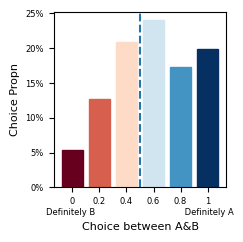

Ratio of sol responses overall: 61.16%
Average response overall: 0.45


([0.05368421052631579,
  0.12631578947368421,
  0.20842105263157895,
  0.24,
  0.1726315789473684,
  0.19894736842105262],
 950)

In [65]:
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.ticker as mtick
import matplotlib as mpl


# select (sol vs unsol) instances from prior instances

target_instances = []
for instance in prior_instances:
    m, a, b = prior_infos[instance]
    if a*b == -1:
        target_instances.append(instance)
        

# Show choice historgram of each instance and overall statistics for (sol vs unsol) instances

def visualize_prior(target_instances):
#     assert x*y == len(target_instances)
#     f, axs = plt.subplots(x, y, sharey=True)
    options = [-2.5,-1.5,-0.5,0.5,1.5,2.5]

    X_axis = np.arange(len(options))
    sol_responses = 0
    sum_response = 0
    all_count = 0 # num_responses
    count = 0 # subplot id

    # overall counter
    overall_results = [0] * 6


    for instance in target_instances:
        print(instance)
        m, a, b = prior_infos[instance]
        print('map_id: ' + str(m)) # TODO: print map? 
        print('solvability of A: ' + str(a)) # 1 means solvable, -1 means unsolvable
        print('solvability of B: ' + str(b))

        # counter
        instance_responses = {}
        for option in options:
            instance_responses[option] = 0

        for p_responses in gr_datas:
            p_data = p_responses['data']
            for i_response in p_data:
                if i_response['instance'] == instance:
                    instance_responses[i_response['response']] += 1

                    # overall statistics updata
                    all_count += 1
                    if a == -1:
                        if i_response['response'] > 0:
                            sol_responses += 1
                        sum_response += i_response['response']
                    else:
                        if i_response['response'] < 0:
                            sol_responses += 1
                        sum_response += -i_response['response']

        print(instance_responses)


        # convert the response to a list to visualize (convert it as always the left side is unsolable goal)
        results = []
        if a == -1: # a is unsolvable
            for i in range(len(options)):
                results.append(instance_responses[options[i]])
                overall_results[i] += instance_responses[options[i]]
        else:
            for i in range(len(options)):
                results.append(instance_responses[options[-1-i]])
                overall_results[i] += instance_responses[options[-1-i]]

        print("Ratio of solvable goal choice: " + str(round(sum(results[-3:])/95*100,2)) + "%")
        print("Average response: " + str(round(sum([results[i]*option for i, option in enumerate(options)])/95,2)))
        print()

#         if x > 1:
#             axs[int(count/y), count%y].bar(range(len(options)), results)
#             if a == -1:
#                 axs[int(count/y), count%y].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
#             else:
#                 axs[int(count/y), count%y].set_xticks(X_axis, ['BB', 'B', 'b','a','A','AA'])
#             axs[int(count/y), count%y].set_xlabel(instance)
#             count += 1
#         else:
#             axs[count].bar(range(len(options)), results)
#             if a == -1:
#                 axs[count].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
#             else:
#                 axs[count].set_xticks(X_axis, ['BB', 'B', 'b','a','A','AA'])
#             axs[count].set_xlabel(instance)
#             count += 1

#     plt.tight_layout()
#     plt.show()


#     if subplot:
#         plt.subplot(subplot[0], subplot[1],subplot[2])
    
#     px = 1/plt.rcParams['figure.dpi']
#     figure(figsize=(150*px, 112*px))
#     half_axis = np.arange(3)
    overall_results = normalize_count(overall_results)
    bars = plt.bar(X_axis, overall_results)
    

    
    SMALL_SIZE = 6
    MEDIUM_SIZE = 8
    BIGGER_SIZE = 10
    mpl.rc_file_defaults()
    plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE) 
    plt.rcParams["figure.figsize"] = [1.2, 1.2]
    
    for i, b in enumerate(bars):
        b.set_color(plt.cm.RdBu(1. * i / (6- 1)))
    
    plt.xticks(X_axis, ['0\nDefinitely B ','0.2','0.4','0.6','0.8','1\n Definitely A'])
    plt.axvline(2.5,linestyle='--') 
    plt.ylabel("Choice Propn")
    plt.xlabel("Choice between A&B")

    ax = plt.gca()
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1,decimals=0))
    plt.tight_layout()
    plt.savefig("fig5.pdf", format = 'pdf', dpi=1200)
#     plt.legend()
    plt.show()
    


    print("Ratio of sol responses overall: " + str(round(sol_responses/all_count * 100, 2)) + "%")
    print("Average response overall: " + str(round(sum_response/all_count, 2)))
    
    return overall_results, all_count

prior_instances = [20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20021, 20022, 20023, 20024, 20025, 20026, 20027, 20028]  
visualize_prior(target_instances)
# visualize_prior([2042, 2043, 2049,2051, 2046, 2047, 2053,2055], 2, 4)

20001
map_id: 1
solvability of A: -1
solvability of B: 1
{-2.5: 6, -1.5: 11, -0.5: 16, 0.5: 35, 1.5: 15, 2.5: 12}
Ratio of solvable goal choice: 65.26%
Average response: 0.32

20003
map_id: 1
solvability of A: 1
solvability of B: -1
{-2.5: 18, -1.5: 21, -0.5: 25, 0.5: 22, 1.5: 7, 2.5: 2}
Ratio of solvable goal choice: 67.37%
Average response: 0.66

20006
map_id: 2
solvability of A: 1
solvability of B: -1
{-2.5: 10, -1.5: 12, -0.5: 31, 0.5: 20, 1.5: 13, 2.5: 9}
Ratio of solvable goal choice: 55.79%
Average response: 0.07

20008
map_id: 2
solvability of A: -1
solvability of B: 1
{-2.5: 6, -1.5: 13, -0.5: 23, 0.5: 29, 1.5: 15, 2.5: 9}
Ratio of solvable goal choice: 55.79%
Average response: 0.14



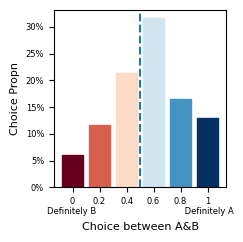

Ratio of sol responses overall: 61.05%
Average response overall: 0.3
20010
map_id: 3
solvability of A: 1
solvability of B: 1
{-2.5: 36, -1.5: 13, -0.5: 18, 0.5: 15, 1.5: 8, 2.5: 5}
Ratio of solvable goal choice: 70.53%
Average response: 0.91

20011
map_id: 4
solvability of A: 1
solvability of B: 1
{-2.5: 32, -1.5: 17, -0.5: 16, 0.5: 14, 1.5: 12, 2.5: 4}
Ratio of solvable goal choice: 68.42%
Average response: 0.83



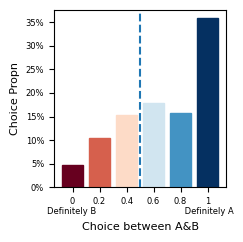

Ratio of sol responses overall: 69.47%
Average response overall: 0.87
20022
map_id: 5
solvability of A: -1
solvability of B: 1
{-2.5: 3, -1.5: 12, -0.5: 20, 0.5: 20, 1.5: 16, 2.5: 24}
Ratio of solvable goal choice: 63.16%
Average response: 0.62

20023
map_id: 5
solvability of A: 1
solvability of B: -1
{-2.5: 17, -1.5: 18, -0.5: 18, 0.5: 20, 1.5: 18, 2.5: 4}
Ratio of solvable goal choice: 55.79%
Average response: 0.33

20025
map_id: 6
solvability of A: 1
solvability of B: -1
{-2.5: 13, -1.5: 18, -0.5: 16, 0.5: 26, 1.5: 16, 2.5: 6}
Ratio of solvable goal choice: 49.47%
Average response: 0.16

20027
map_id: 6
solvability of A: 1
solvability of B: -1
{-2.5: 13, -1.5: 16, -0.5: 19, 0.5: 30, 1.5: 11, 2.5: 6}
Ratio of solvable goal choice: 50.53%
Average response: 0.21



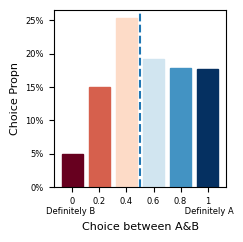

Ratio of sol responses overall: 54.74%
Average response overall: 0.33


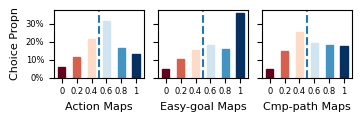

In [63]:
from matplotlib.pyplot import figure

def normalize_count(count):
    return [i/sum(count) for i in count]


# action prior instances:
target_instances = [20001, 20003, 20006, 20008]
raw_a_results, a_count = visualize_prior(target_instances)
a_results = normalize_count(raw_a_results)

# obvious prior instances:
target_instances = [20010, 20011]
raw_o_results, o_count = visualize_prior(target_instances)
o_results = normalize_count(raw_o_results)

# competing prior instances:
target_instances = [20022, 20023, 20025, 20027]
raw_c_results, c_count = visualize_prior(target_instances)
c_results = normalize_count(raw_c_results)

# # plt.rcParams.update({'font.size': 12})
# px = 1/plt.rcParams['figure.dpi']
# # figure(figsize=(400*px, 130*px))

SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
mpl.rc_file_defaults()
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [3.6, 1.2]
f, axs = plt.subplots(1, 3, sharey=True)



# half_axis = np.arange(3)

# axs[0].bar(half_axis-0.2, a_results[:3], 0.4, label = "Unsolvable Goal")
# axs[0].bar(half_axis+0.2, a_results[3:][::-1], 0.4, label = "Solvable Goal")
# axs[0].set_xticks(half_axis, ['Very Confident', 'Farily Confident', 'Slightly Confident'])
# axs[0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1))
# axs[0].set_xlabel('Action Maps')

# axs[1].bar(half_axis-0.2, o_results[:3], 0.4, label = "Unsolvable Goal")
# axs[1].bar(half_axis+0.2, o_results[3:][::-1], 0.4, label = "Solvable Goal")
# axs[1].set_xticks(half_axis, ['Very Confident', 'Farily Confident', 'Slightly Confident'])
# axs[1].set_xlabel('Easy-goal Maps')


# axs[2].bar(half_axis-0.2, c_results[:3], 0.4, label = "Unsolvable Goal")
# axs[2].bar(half_axis+0.2, c_results[3:][::-1], 0.4, label = "Solvable Goal")
# axs[2].set_xticks(half_axis, ['Very Confident', 'Farily Confident', 'Slightly Confident'])
# axs[2].set_xlabel('Cmp-path Maps')



axs[0].set_ylabel("Choice Propn")
# plt.xlabel("Confidence level")
X_axis = np.arange(6)
bars = axs[0].bar(X_axis, a_results,0.5)
for i, b in enumerate(bars):
    b.set_color(plt.cm.RdBu(1. * i / (6- 1)))
axs[0].set_xticks(X_axis, ['0','0.2','0.4','0.6','0.8','1'])
axs[0].axvline(2.5,linestyle='--') 
axs[0].yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1,decimals=0))
axs[0].yaxis.set_tick_params()
axs[0].set_xlabel("Action Maps")


bars = axs[1].bar(X_axis, o_results,0.5)
for i, b in enumerate(bars):
    b.set_color(plt.cm.RdBu(1. * i / (6- 1)))
axs[1].set_xticks(X_axis, ['0','0.2','0.4','0.6','0.8','1'])
axs[1].axvline(2.5,linestyle='--') 
axs[1].set_xlabel("Easy-goal Maps")

bars = axs[2].bar(X_axis, c_results,0.5)
for i, b in enumerate(bars):
    b.set_color(plt.cm.RdBu(1. * i / (6- 1)))
axs[2].set_xticks(X_axis, ['0','0.2','0.4','0.6','0.8','1'])
axs[2].axvline(2.5,linestyle='--') 
axs[2].set_xlabel("Cmp-path Maps")



#     plt.bar(half_axis-0.2, overall_results[:3], 0.4, label = "Unsolvable Goal")
#     plt.bar(half_axis+0.2, overall_results[3:][::-1], 0.4, label = "Solvable Goal")
#     plt.xticks(half_axis, ['Very Confident', 'Farily Confident', 'Slightly Confident'])

plt.tight_layout()

plt.savefig("fig6.pdf", format = 'pdf',dpi=3600)
plt.show()

# prior instances without obvious instances
# target_instances = [20001, 20003, 20006, 20008, 20022, 20023, 20025, 20027]
# visualize_prior(target_instances, 2, 4)

20001
map_id: 1
solvability of A: -1
solvability of B: 1
{0: 6, 0.2: 11, 0.4: 16, 0.6: 35, 0.8: 15, 1: 12}
Average response: 0.56

20002
map_id: 1
solvability of A: -1
solvability of B: -1
{0: 11, 0.2: 10, 0.4: 35, 0.6: 27, 0.8: 10, 1: 2}
Average response: 0.44

20003
map_id: 1
solvability of A: 1
solvability of B: -1
{0: 18, 0.2: 21, 0.4: 25, 0.6: 22, 0.8: 7, 1: 2}
Average response: 0.37

20004
map_id: 1
solvability of A: 1
solvability of B: 1
{0: 8, 0.2: 17, 0.4: 25, 0.6: 24, 0.8: 12, 1: 9}
Average response: 0.49

20005
map_id: 2
solvability of A: 1
solvability of B: 1
{0: 6, 0.2: 11, 0.4: 38, 0.6: 23, 0.8: 12, 1: 5}
Average response: 0.48

20006
map_id: 2
solvability of A: 1
solvability of B: -1
{0: 10, 0.2: 12, 0.4: 31, 0.6: 20, 0.8: 13, 1: 9}
Average response: 0.49

20007
map_id: 2
solvability of A: -1
solvability of B: -1
{0: 2, 0.2: 5, 0.4: 39, 0.6: 35, 0.8: 8, 1: 6}
Average response: 0.53

20008
map_id: 2
solvability of A: -1
solvability of B: 1
{0: 6, 0.2: 13, 0.4: 23, 0.6: 29

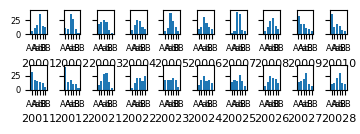

In [9]:
# select (solv vs sol) or (unsol vs unsol) instances from prior instances
options = [0,0.2,0.4,0.6,0.8,1]
map_options = {-2.5:0, -1.5:0.2,-0.5:0.4, 0.5:0.6, 1.5:0.8,2.5:1}
target_instances = []
for instance in prior_instances:
    m, a, b = prior_infos[instance]
    target_instances.append(instance)
        
average_rs = {}
# Show choice historgram of each instance
X_axis = np.arange(len(options))
columns = int(len(target_instances)/2)

f, axs = plt.subplots(2, columns, sharey=True)
f.tight_layout()


count = 0 # subplot id
for instance in target_instances:
    print(instance)
    m, a, b = prior_infos[instance]
    print('map_id: ' + str(m)) # TODO: print map? 
    print('solvability of A: ' + str(a)) # 1 means solvable, -1 means unsolvable
    print('solvability of B: ' + str(b))
    
    # counter
    instance_responses = {}
    for option in options:
        instance_responses[option] = 0
        
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == instance:
                instance_responses[map_options[i_response['response']]] += 1
                
    print(instance_responses)
    
    
    # convert the response to a list to visualize
    results = []
    for i in range(len(options)):
        results.append(instance_responses[options[i]])

            
    print("Average response: " + str(round(sum([results[i]*option for i, option in enumerate(options)])/95,2)))
    print()
    average_rs[instance] = round(sum([results[i]*option for i, option in enumerate(options)])/95,2)
            
    axs[int(count/columns), count%columns].bar(range(len(options)), results)
    axs[int(count/columns), count%columns].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
    axs[int(count/columns), count%columns].set_xlabel(instance)
    count += 1

plt.show()

### Discussions:
In "action" instances (first 4 subfigures), participants are usually uncertain about their selection, but they tend to shift their preference towards solvable goals in solvable-unsolvable scenarios.

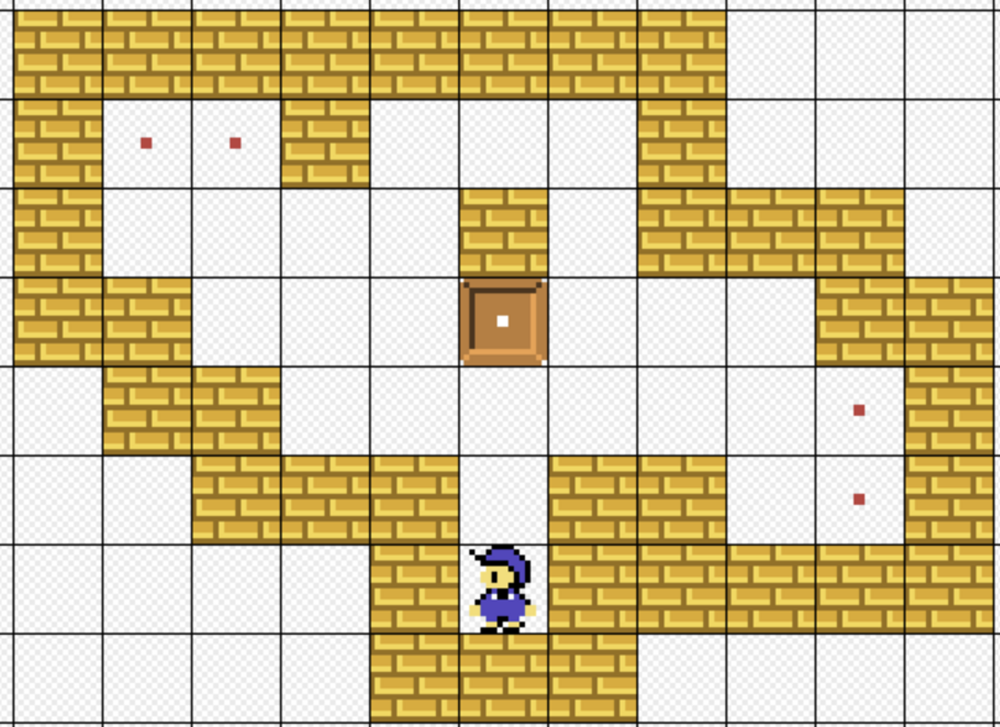

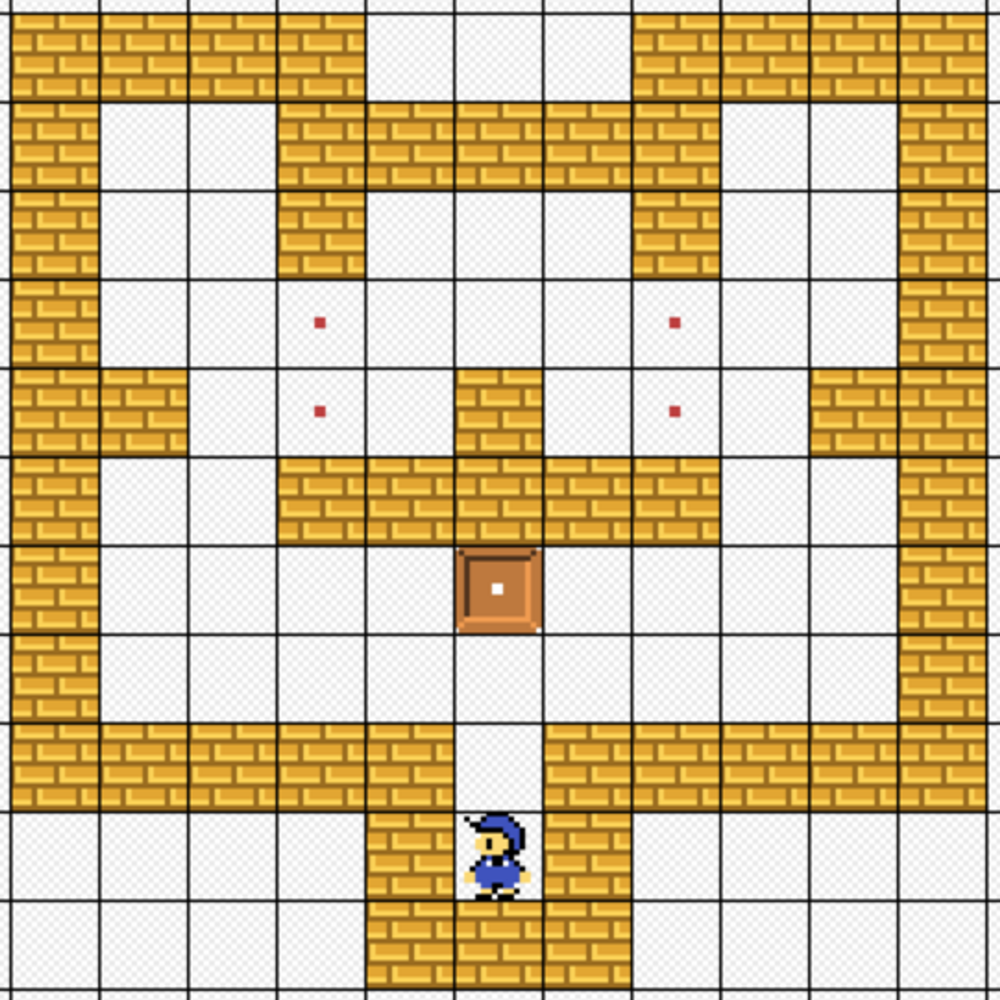

In "obvious" instances (the following 2 subfigures), participants tend to choose the obvious option. When the non-obvious option is unsolvable, the preference for the obvious one becomes stronger. 
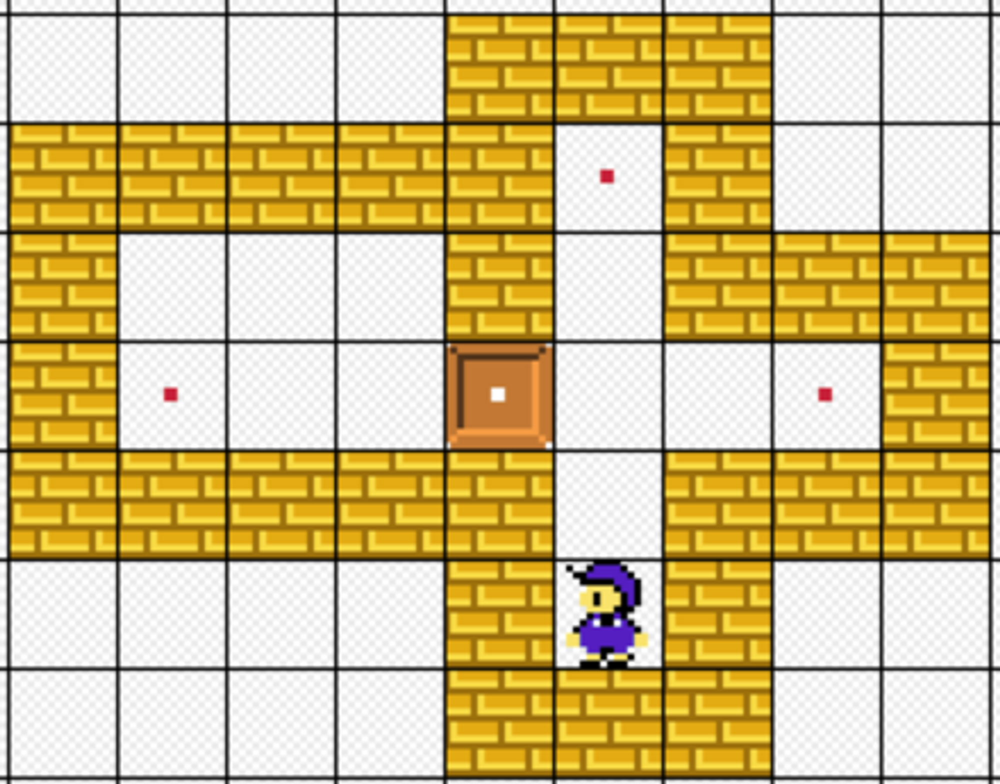

## Add one figure that exclude obvious cases ; add an overall figure and three separate figure for each subtypes


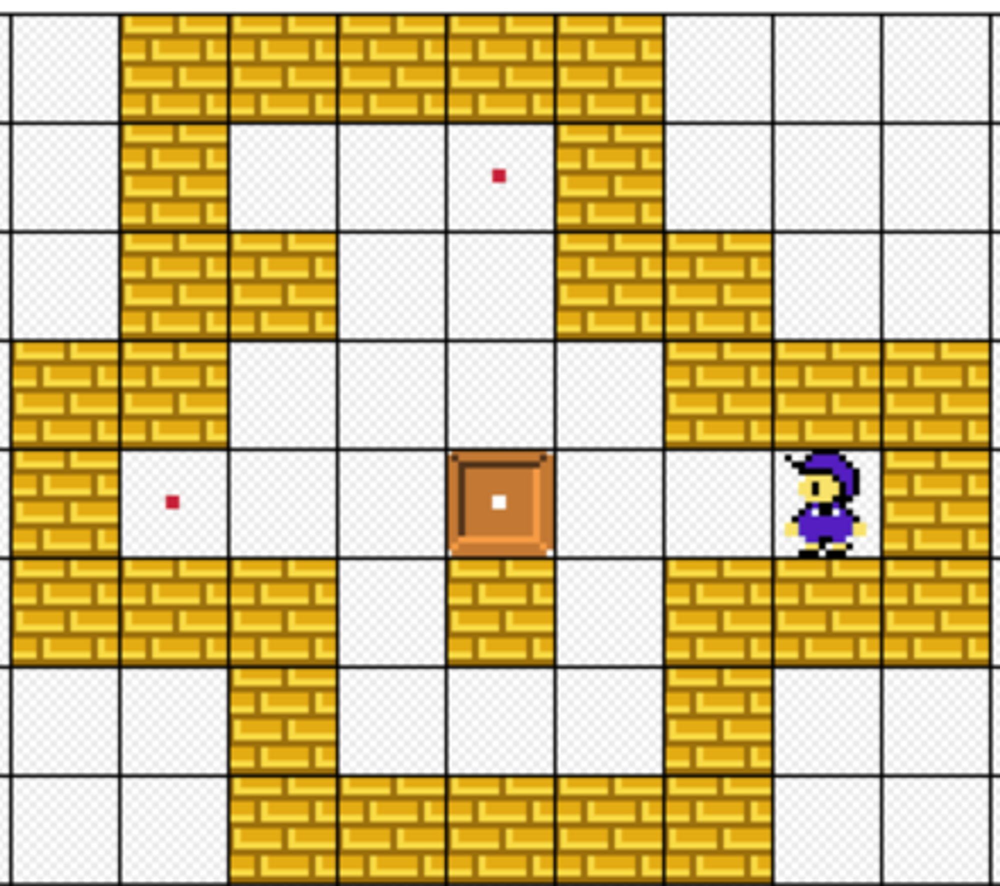

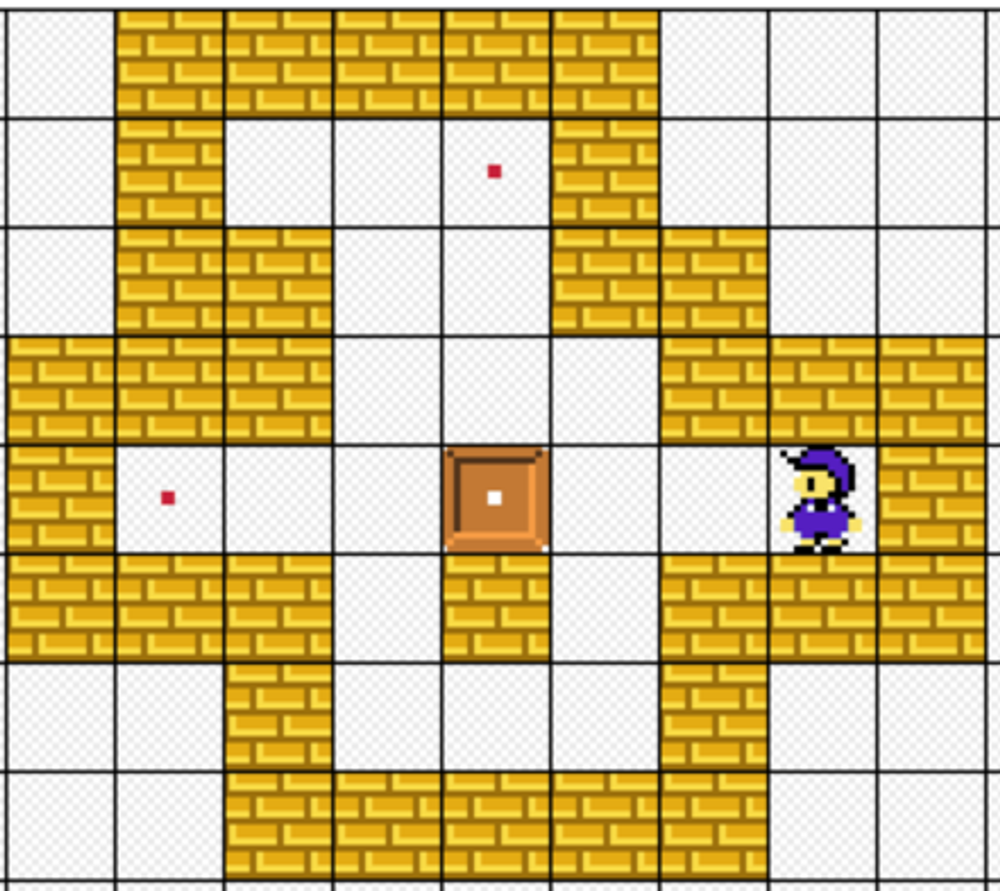

In "competing" instances (the last 4 subfigures), people have low confidence when choosing an unsolvable goal. In the meantime, they slightly prefer instances at a similar horizontal level of the starting position.
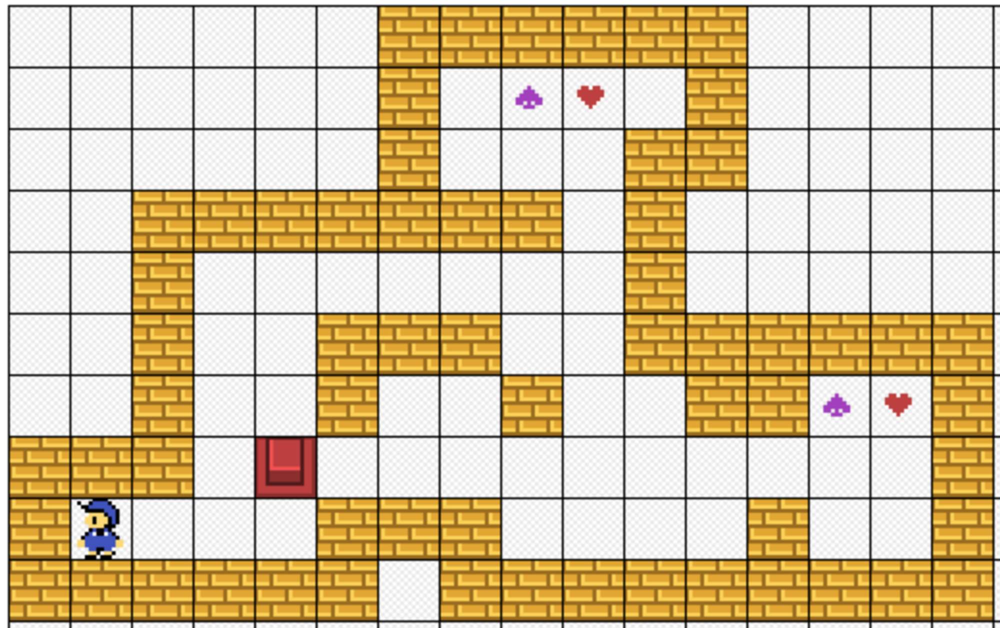


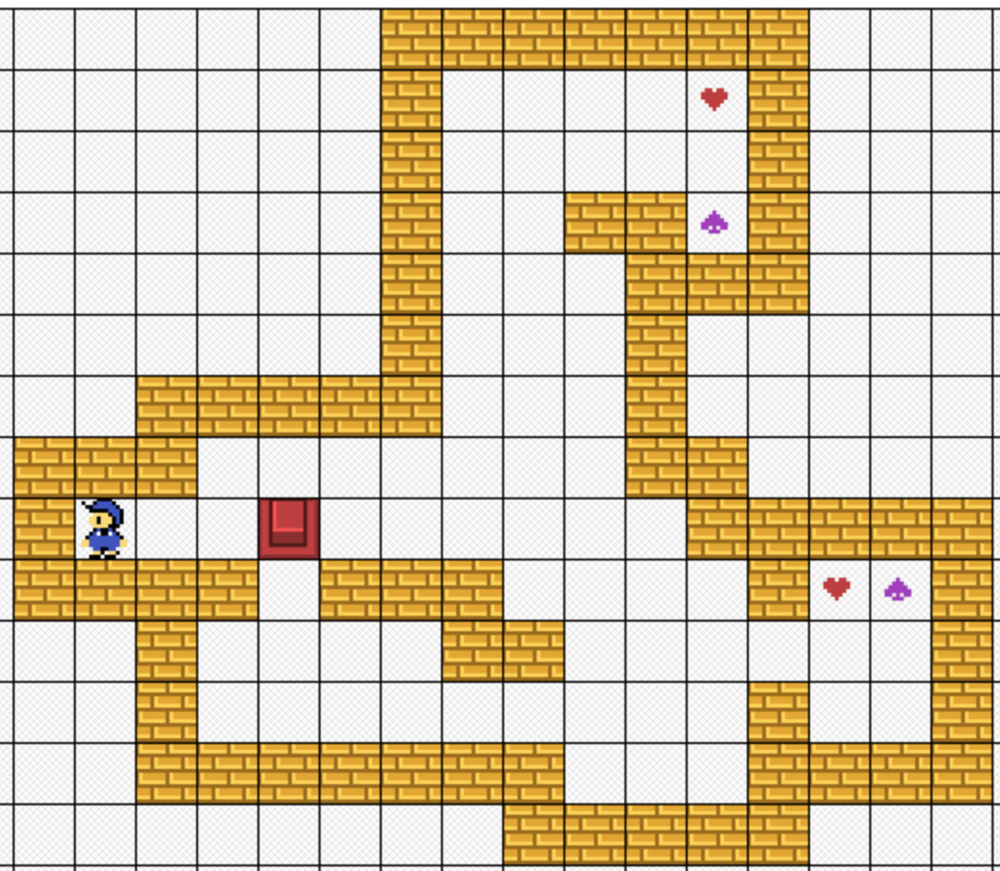

### Refer R for regression analysis 
What kind of overall analysis we want to perform on it besides regression?


# Observation Instances

## Action Instances

Hypothesis: Changes in the action taken at this stage will impact human inferences and confidence levels in all cases, regardless of the solvability of potential goals.


0.19921052631578948
0.4860526315789474
0.8081578947368422


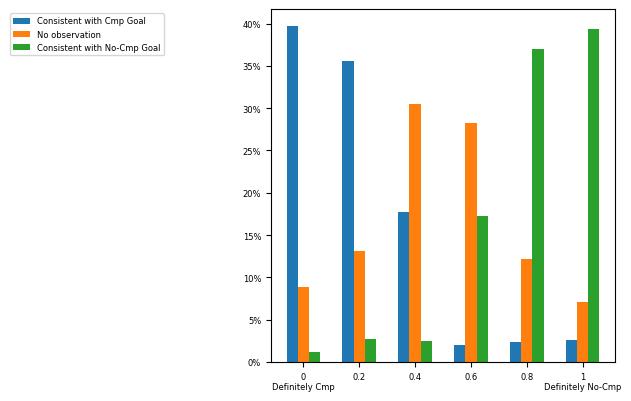

0.14105263157894737
0.3142105263157895
0.25473684210526315


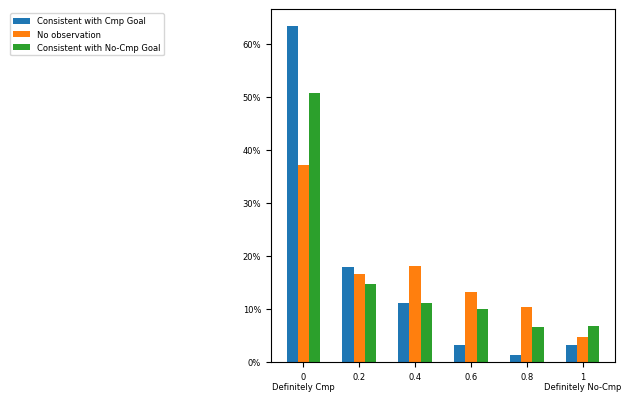

0.5502631578947368
0.5021052631578947
0.5821052631578947


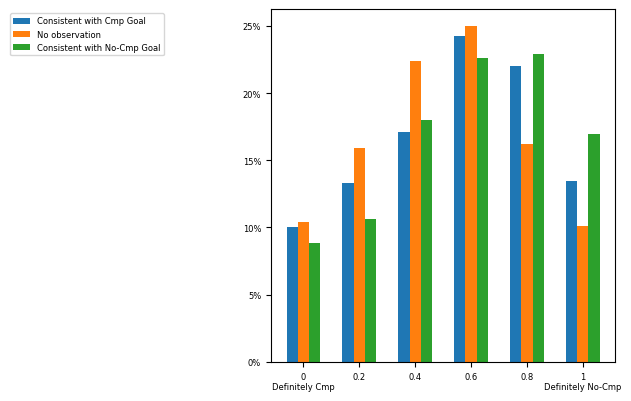

In [10]:
from scipy.stats import norm
from matplotlib.ticker import MaxNLocator


def visualize_prior(target_instances, x, y):
    assert x*y == len(target_instances)
#     f, axs = plt.subplots(x, y, sharey=True)
    options = [-2.5, -1.5, -0.5, 0.5, 1.5, 2.5]

    X_axis = np.arange(len(options))
    sol_responses = 0
    sum_response = 0
    all_count = 0 # num_responses
    count = 0 # subplot id

    # overall counter
    overall_results = [0] * 6


    for instance in target_instances:
        print(instance)
        m, a, b = prior_infos[instance]
        print('map_id: ' + str(m)) # TODO: print map? 
        print('solvability of A: ' + str(a)) # 1 means solvable, -1 means unsolvable
        print('solvability of B: ' + str(b))

        # counter
        instance_responses = {}
        for option in options:
            instance_responses[option] = 0

        for p_responses in gr_datas:
            p_data = p_responses['data']
            for i_response in p_data:
                if i_response['instance'] == instance:
                    instance_responses[i_response['response']] += 1

                    # overall statistics updata
                    all_count += 1
                    if a == -1:
                        if i_response['response'] > 0:
                            sol_responses += 1
                        sum_response += i_response['response']
                    else:
                        if i_response['response'] < 0:
                            sol_responses += 1
                        sum_response += -i_response['response']

        print(instance_responses)


        # convert the response to a list to visualize (convert it as always the left side is unsolable goal)
        results = []
        if a == -1: # a is unsolvable
            for i in range(len(options)):
                results.append(instance_responses[options[i]])
                overall_results[i] += instance_responses[options[i]]
        else:
            for i in range(len(options)):
                results.append(instance_responses[options[-1-i]])
                overall_results[i] += instance_responses[options[-1-i]]

        print("Ratio of solvable goal choice: " + str(round(sum(results[-3:])/95*100,2)) + "%")
        print("Average response: " + str(round(sum([results[i]*option for i, option in enumerate(options)])/95,2)))
        print()

#         if x > 1:
#             axs[int(count/y), count%y].bar(range(len(options)), results)
#             if a == -1:
#                 axs[int(count/y), count%y].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
#             else:
#                 axs[int(count/y), count%y].set_xticks(X_axis, ['BB', 'B', 'b','a','A','AA'])
#             axs[int(count/y), count%y].set_xlabel(instance)
#             count += 1
#         else:
#             axs[count].bar(range(len(options)), results)
#             if a == -1:
#                 axs[count].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
#             else:
#                 axs[count].set_xticks(X_axis, ['BB', 'B', 'b','a','A','AA'])
#             axs[count].set_xlabel(instance)
#             count += 1

#     plt.tight_layout()
#     plt.show()


#     if subplot:
#         plt.subplot(subplot[0], subplot[1],subplot[2])
    
#     half_axis = np.arange(3)
#     plt.bar(half_axis-0.2, overall_results[:3], 0.4, label = "Unsolvable Goal")
#     plt.bar(half_axis+0.2, overall_results[3:][::-1], 0.4, label = "Solvable Goal")
#     plt.xticks(half_axis, ['Very Confident', 'Farily Confident', 'Slightly Confident'])

#     ax = plt.gca()
#     ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=all_count))
#     plt.legend()
    


    print("Ratio of sol responses overall: " + str(round(sol_responses/all_count * 100, 2)) + "%")
    print("Average response overall: " + str(round(sum_response/all_count, 2)))
    
    return overall_results, all_count


action_instance_A = [2001, 2002, 2003, 2004, 2009, 2010, 2011, 2012]
action_instance_B = [2005, 2006, 2007, 2008, 2013, 2014, 2015, 2016]
prior_instance = [20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008]

def compute_average(a_list):
    count = 0
    s = 0
    for i, option in enumerate(options):
        s += option * a_list[i]
        count += a_list[i]
        
    return s/count
average_rs_o = {}
def visualize_observe(a_list, b_list, p_list, left = "A", right = "B", sol = False):
    
    options = [-2.5,-1.5,-0.5,0.5,1.5,2.5]
    
    a_results = [0]*6
    b_results = [0]*6
    p_results = [0]*6
    a_data = []
    b_data = []
    c_data = []
    for i_a, i_b, i_p in zip(a_list, b_list, p_list):
        a_responses = {}
        b_responses = {}
        p_responses = {}
        
        m, a, b = prior_infos[i_p]

        # counter
        for option in options:
            a_responses[option] = 0
            b_responses[option] = 0
            p_responses[option] = 0

        for par_responses in gr_datas:
            p_data = par_responses['data']
            for i_response in p_data:
                if i_response['instance'] == i_a:
                    a_responses[i_response['response']] += 1
                elif i_response['instance'] == i_b:
                    b_responses[i_response['response']] += 1
                elif i_response['instance'] == i_p:
                    p_responses[i_response['response']] += 1

        # convert the response to a list to visualize
        if sol:
            if a == 1:
                for i in range(len(options)):
                    a_results[i] += a_responses[options[-1-i]]
                    b_results[i] += b_responses[options[-1-i]]
                    p_results[i] += p_responses[options[-1-i]]
            else:
                for i in range(len(options)):
                    a_results[i] += a_responses[options[i]]
                    b_results[i] += b_responses[options[i]]
                    p_results[i] += p_responses[options[i]]
        else:
            for i in range(len(options)):
                a_results[i] += a_responses[options[i]]
                b_results[i] += b_responses[options[i]]
                p_results[i] += p_responses[options[i]]
    
    x_axis = np.arange(6)
#     plt.figure(figsize=(6,3))
#     px = 1/plt.rcParams['figure.dpi']
#     figure(figsize=(400*px, 400*px))
    px = 1/plt.rcParams['figure.dpi']
    figure(figsize=(400*px, 400*px))
    n_a_results = normalize_count(a_results)
    plt.bar(x_axis-0.2, n_a_results, 0.2, label = "Consistent with Cmp Goal")
    print(compute_average(a_results))
    average_rs_o[i_a] = compute_average(a_results)
    n_p_results = normalize_count(p_results)
    plt.bar(x_axis, n_p_results, 0.2, label = "No observation")
    print(compute_average(p_results))
    n_b_results = normalize_count(b_results)
    plt.bar(x_axis+0.2, n_b_results, 0.2, label = "Consistent with No-Cmp Goal")
    print(compute_average(b_results))
    average_rs_o[i_b] = compute_average(b_results)
    plt.xticks(x_axis, ['0\nDefinitely Cmp', '0.2','0.4','0.6','0.8', '1\nDefinitely No-Cmp'])
    
    ax = plt.gca()
#     plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=0))
#     ax.yaxis.set_major_locator(MaxNLocator(integer=True))

    plt.tight_layout()
    plt.legend(bbox_to_anchor=(-0.3, 1),loc = 'best')
#     plt.legend(bbox_to_anchor=(2, 0),loc = 'lower right')
    plt.show()

visualize_observe(action_instance_A, action_instance_B, prior_instance)



# # visualize_observe([2001,2007,2012,2014],[2005,2003,2016,2010],[20001,20003,20008,20006], sol= True)

visualize_observe([2017, 2018, 2021, 2023],[2019, 2020, 2022, 2024],[20009,20010,20011,20012])
# visualize_observe([2017, 2023],[2019, 2024],[20009, 20012], left = "Easy", right = "Hard(unsol)")
# visualize_observe([2018, 2021],[2020, 2022],[20010, 20011], left = "Easy", right = "Hard(sol)")

cp_instance_A = [2041, 2042, 2043, 2044,2053,2054,2055,2056]
cp_instance_B = [2045, 2046, 2047, 2048,2049,2050,2051,2052]
prior_instance = [20021, 20022, 20023, 20024, 20025, 20026, 20027, 20028]

visualize_observe(cp_instance_A, cp_instance_B, prior_instance)

# visualize_observe([2042, 2047, 2053, 2055], [2046, 2043, 2049, 2051], [20022, 20023, 20025, 20027], left = "Unsol", right = "Sol", sol = True)
# f, axs = plt.subplots(2, 4, sharey=True)
# f.tight_layout()

# options = [-2.5, -1.5, -0.5, 0.5, 1.5, 2.5]
# count = 0

# for i_a, i_b in zip(action_instance_A, action_instance_B):
#     a_responses = {}
#     b_responses = {}
    
#     # counter
#     for option in options:
#         a_responses[option] = 0
#         b_responses[option] = 0
        
#     for p_responses in gr_datas:
#         p_data = p_responses['data']
#         for i_response in p_data:
#             if i_response['instance'] == i_a:
#                 a_responses[i_response['response']] += 1
#             elif i_response['instance'] == i_b:
#                 b_responses[i_response['response']] += 1
                
#     # convert the response to a list to visualize
#     a_results = []
#     b_results = []
#     for i in range(len(options)):
#         a_results.append(a_responses[options[i]])
#         b_results.append(b_responses[options[i]])
        
#     axs[int(count/4), count%4].bar(X_axis-0.2, a_results,0.4, label = "consistent with A")
#     axs[int(count/4), count%4].bar(X_axis+0.2, b_results,0.4, label = "consistent with B")
#     axs[int(count/4), count%4].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
#     axs[int(count/4), count%4].set_xlabel(str(i_a) + " vs " + str(i_b))
#     count += 1

# plt.legend(bbox_to_anchor=(2, 0),loc = 'lower right')
# plt.show()


## add the prior distribution of the figures in observation instance comparision
## summarize figures into three figures

### Discussion
In general the observation dominate the choice of target regardless the solvablity, while there are a few particpant refuse to choose the unsolable goals while the another is solvable (2001 vs 2005 A is unsolvable and B is solable; 2011 vs 2015, B is unsolvable and A is solvable). 

### Refer R for regression analysis

In [11]:
print(average_rs_o)

{2012: 0.19921052631578948, 2016: 0.8081578947368422, 2023: 0.14105263157894737, 2024: 0.25473684210526315, 2056: 0.5502631578947368, 2052: 0.5821052631578947}


## Obvious instances

Hypothesis: Prolonged thinking time will decrease human preference for the easy goal

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


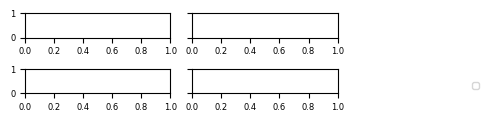

In [12]:
obvious_instance_A = [2001, 2002, 2003, 2004, 2009, 2010, 2011, 2012, 2017, 2018, 2021, 2023]
obvious_instance_B = [2005, 2006, 2007, 2008, 2013, 2014, 2015, 2016, 2019, 2020, 2022, 2024]

average_rs_o = {}

f, axs = plt.subplots(2, 2, sharey=True)
f.tight_layout()

options = [-2.5, -1.5, -0.5, 0.5, 1.5, 2.5]
count = 0
X_axis = np.arange(len(options))
for i_a, i_b in zip(obvious_instance_A, obvious_instance_B):
    a_responses = {}
    b_responses = {}
    
    # counter
    for option in options:
        a_responses[option] = 0
        b_responses[option] = 0
        
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i_a:
                a_responses[i_response['response']] += 1
            elif i_response['instance'] == i_b:
                b_responses[i_response['response']] += 1
                
    # convert the response to a list to visualize
    a_results = []
    b_results = []
    for i in range(len(options)):
        a_results.append(a_responses[options[i]])
        b_results.append(b_responses[options[i]])
        
    average_rs_o[i_a] = compute_average(a_results)
    average_rs_o[i_b] = compute_average(b_results)

#     axs[int(count/2), count%2].bar(X_axis-0.2, a_results,0.4, label = "consistent with A")
#     axs[int(count/2), count%2].bar(X_axis+0.2, b_results,0.4, label = "consistent with B")
#     axs[int(count/2), count%2].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
#     axs[int(count/2), count%2].set_xlabel(str(i_a) + " vs " + str(i_b))
    count += 1

plt.legend(bbox_to_anchor=(2, 0),loc = 'lower right')
plt.show()

### Discussion
In general the long thinking time slightly shift the preference of the subject from easy goal to the difficult goal in all cases no matter the difficult goal is solvable or not.

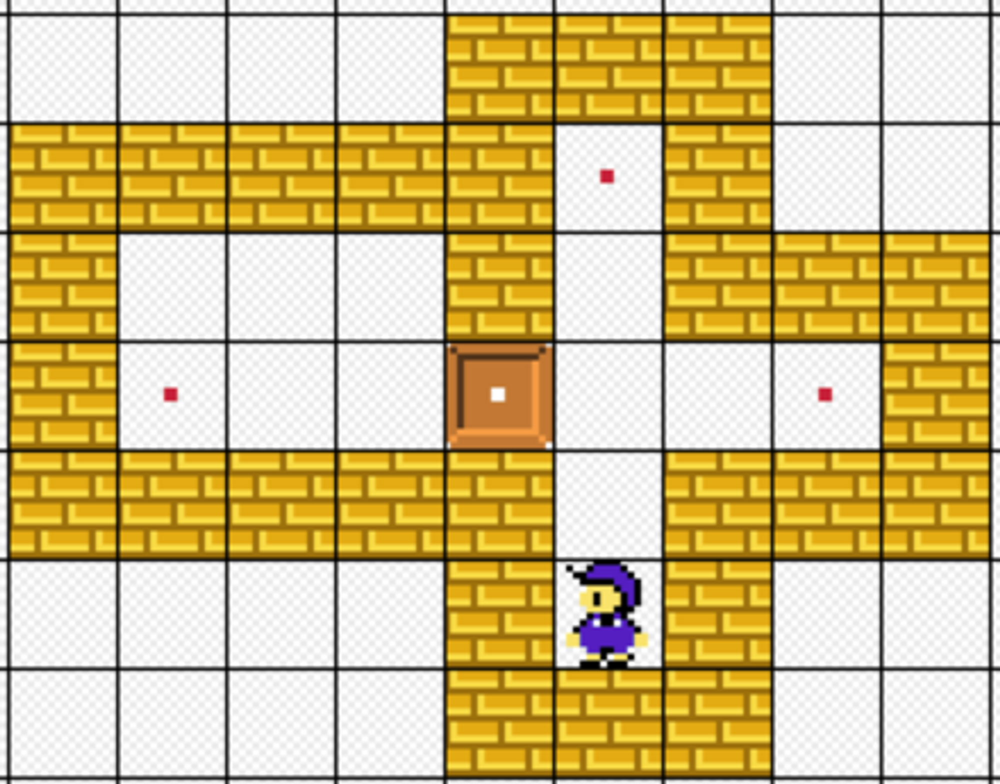



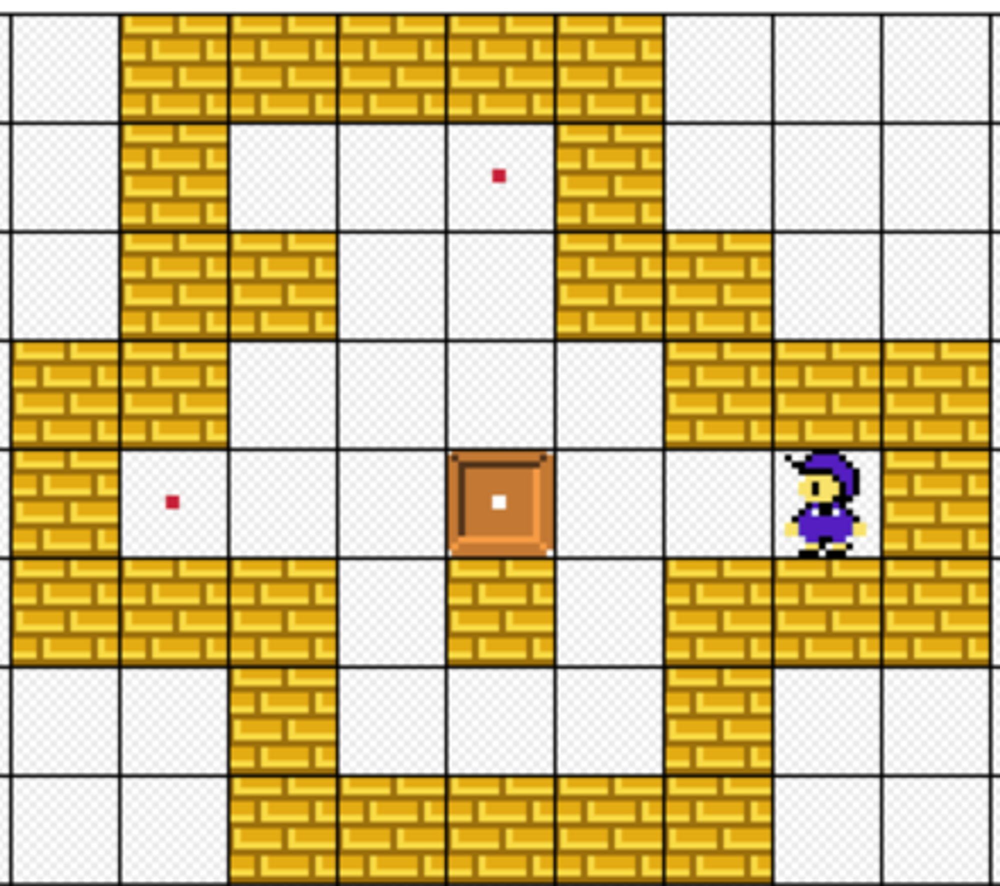

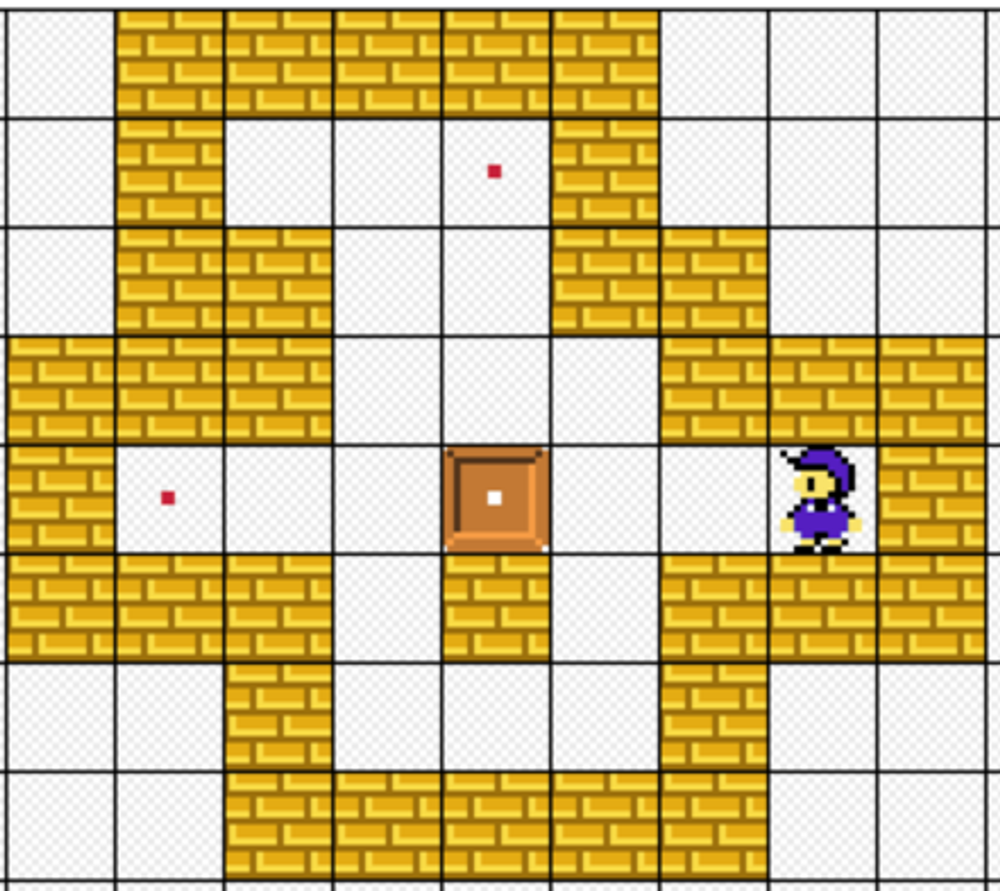


### Refer R for regression analysis

## Competing instances

Hypothesis: Prolonged thinking time will decrease human preference for the goal with a single option


2041
(5, -1, -1, 1)
Average Response: 0.8789473684210526

2045
(5, -1, -1, -1)
Average Response: 1.2052631578947368

paired T-test: 
TtestResult(statistic=-2.0938706530691236, pvalue=0.019481548402442584, df=94)


2042
(5, -1, 1, 1)
Average Response: 0.9421052631578948

2046
(5, -1, 1, -1)
Average Response: 1.2052631578947368

paired T-test: 
TtestResult(statistic=-1.3980073262914625, pvalue=0.08270050876920129, df=94)


2043
(5, 1, -1, 1)
Average Response: 0.19473684210526315

2047
(5, 1, -1, -1)
Average Response: 0.2578947368421053

paired T-test: 
TtestResult(statistic=-0.31472469445248286, pvalue=0.37683410999977207, df=94)


2044
(5, 1, 1, 1)
Average Response: 0.5

2048
(5, 1, 1, -1)
Average Response: 0.8578947368421053

paired T-test: 
TtestResult(statistic=-1.7129415056636783, pvalue=0.04500995780549041, df=94)


2053
(6, 1, -1, -1)
Average Response: -0.41578947368421054

2049
(6, 1, -1, 1)
Average Response: -0.05789473684210526

paired T-test: 
TtestResult(statistic=-2.22123621

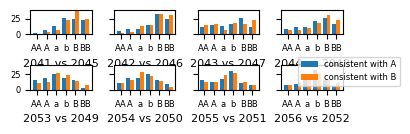

In [13]:
from statistics import mean
from scipy.stats import ttest_rel

cp_instance_A = [2041, 2042, 2043, 2044,2053,2054,2055,2056]
cp_instance_B = [2045, 2046, 2047, 2048,2049,2050,2051,2052]


f, axs = plt.subplots(2, 4, sharey=True)
f.tight_layout()

options = [-2.5, -1.5, -0.5, 0.5, 1.5, 2.5]
count = 0
X_axis = np.arange(len(options))
for i_a, i_b in zip(cp_instance_A, cp_instance_B):
    a_responses = {}
    b_responses = {}
    
    a_rs_list = []
    b_rs_list = []
    
    # counter
    for option in options:
        a_responses[option] = 0
        b_responses[option] = 0
        
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i_a:
                a_responses[i_response['response']] += 1
                a_rs_list.append(i_response['response'])
            elif i_response['instance'] == i_b:
                b_responses[i_response['response']] += 1
                b_rs_list.append(i_response['response'])
                
    # convert the response to a list to visualize
    a_results = []
    b_results = []
    for i in range(len(options)):
        a_results.append(a_responses[options[i]])
        b_results.append(b_responses[options[i]])
        
    average_rs_o[i_a] = compute_average(a_results)
    average_rs_o[i_b] = compute_average(b_results)
    axs[int(count/4), count%4].bar(X_axis-0.2, a_results,0.4, label = "consistent with A")
    axs[int(count/4), count%4].bar(X_axis+0.2, b_results,0.4, label = "consistent with B")
    axs[int(count/4), count%4].set_xticks(X_axis, ['AA', 'A', 'a','b','B','BB'])
    axs[int(count/4), count%4].set_xlabel(str(i_a) + " vs " + str(i_b))
    count += 1
    
    # statistic info
    print(i_a)
    print(obs_infos[i_a])
    print("Average Response: " + str(mean(a_rs_list)))
    print()
    print(i_b)
    print(obs_infos[i_b])
    print("Average Response: " + str(mean(b_rs_list)))
    print()
    print("paired T-test: ")
    print(ttest_rel(a_rs_list, b_rs_list, alternative='less'))
    print()
    print()

plt.legend(bbox_to_anchor=(2, 0),loc = 'lower right')
plt.show()

### Discussion

Things went a bit complexed in competing instances. In map 5:
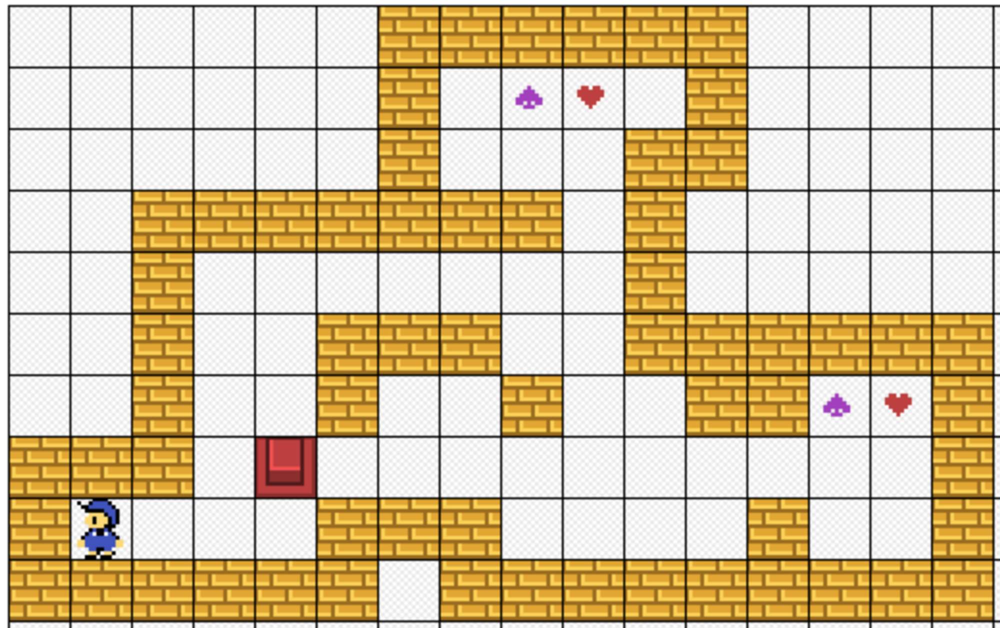

In cases where both targets have some degree of solvability, the extended thinking time causes a slight shift in preference towards goals with multiple possible paths. However, when there is a difference in solvability between the targets, the manipulation of timing becomes ineffective.

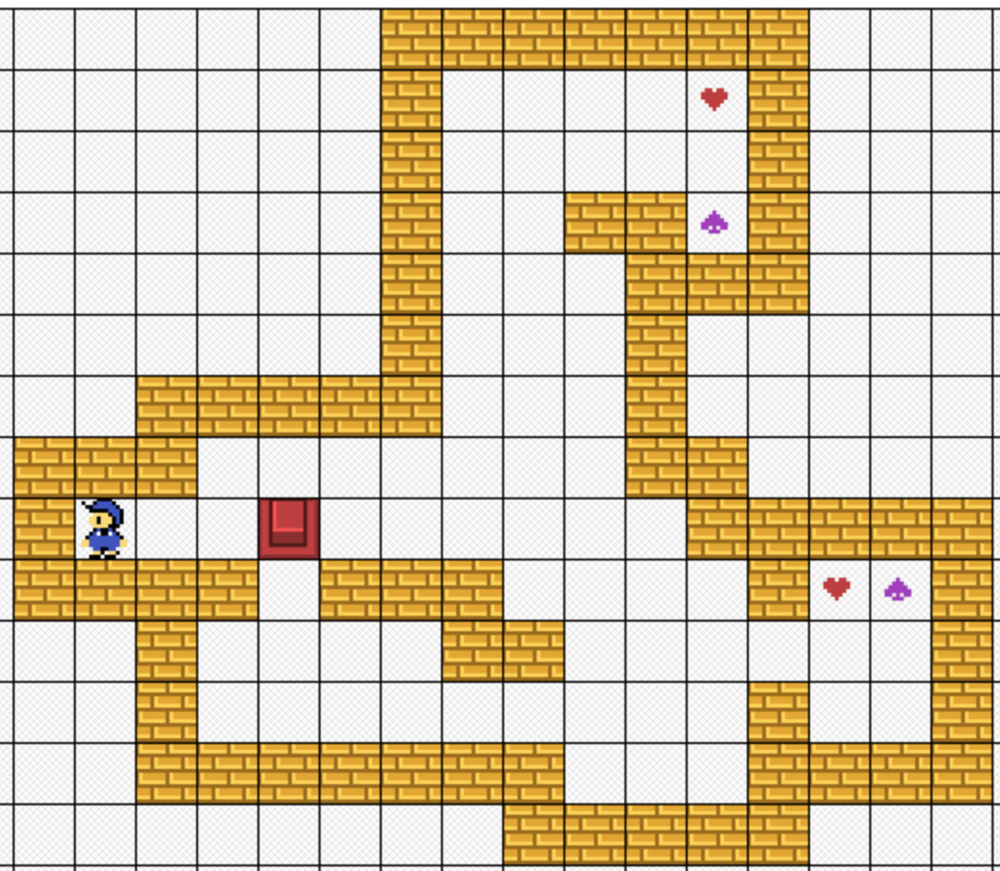

In map 6, I mistakenly assumed that both targets in the upper area were solvable. Overall, the manipulation did not produce the expected preference shift. However, when one goal is unsolvable in the left area, an extended thinking time leads to a preference shift towards the solvable option. This observation suggests that when the available evidence is insufficient, people tend to seek additional evidence to make more informed inferences.


## Summary for goal recognition part

1. In prior instances, solvable goal are slightly preferred.
2. In action instances, solvability does not affect goal inference as action provide very strong information.
3. In obvious instances, easy goal are strongly preferred even without information but the long thinking time shift the preference to the difficult one.
4. In competing instances, the timing information only useful in map 5 when the solvability of both targets are same. But this effect does not observed in map 6. 

Could we come up with a theory to explain all results? Here is one attempt (we might raise it in discussion part):
The evidence has the order of accessibility (which might corresponding to the level of cognitive effort to evaluate the evidence): action, timing for easy/hard goals, solvability, timing for competing goals... This shows the bayesian explaination might not hold for human goal inference. People does not consider all information at once. 

In [14]:
import json
# Instance Information Preparation and Data Loading

# Observation instances
ps_instances = [30001, 30002, 30003, 30004, 30005, 30006, 30007, 30008, 30009, 30010, 30011, 30012, 30013, 30014, 30015, 30026, 30027, 30028, 30029, 30030, 30031, 30032, 30033]
maps = [1,1,1,1,2,2,2,2,3,3,3,4,4,4,4,5,5,5,5,6,6,6,6]
sov = [-1, 15, 17, -1, 21, 21, -1, -1, -1, 5, 13, 17, 5, -1, 5, -1, 16, -1, 16, 24, 26, -1, 25]

ps_infos = {}

for n,i in enumerate(ps_instances):
    ps_infos[i] = (maps[n],sov[n])
    
    
# Load data
filename = 'ps_data_2.json'
with open(filename) as f:
    ps_datas = json.load(f)

# Problem solving

# Unsolvable instance

Initially, we are interested in examining participants' behavior in unsolvable instances. Specifically, we aim to investigate the number of steps they take before becoming aware of the unsolvability.

30001
Number of reset: 18
Average Number of Steps: 12.421052631578947


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 30.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


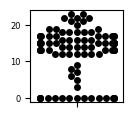

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 46.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


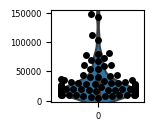

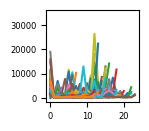

Number of outliers: 3

Average Number of Steps: 12.5
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30004
Number of reset: 10
Average Number of Steps: 15.694736842105263


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 37.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


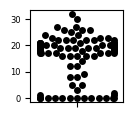

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 51.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


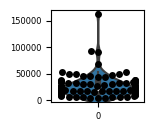

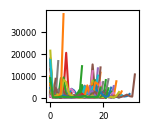

Number of outliers: 2

Average Number of Steps: 15.548387096774194
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30007
Number of reset: 20
Average Number of Steps: 21.305263157894736


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 22.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


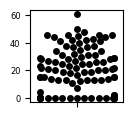

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 57.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


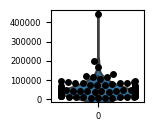

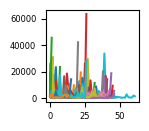

Number of outliers: 1

Average Number of Steps: 21
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30008
Number of reset: 25
Average Number of Steps: 21.05263157894737


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 25.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


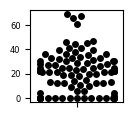

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 56.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


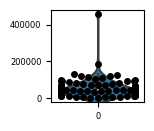

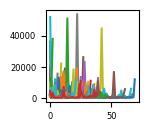

Number of outliers: 1

Average Number of Steps: 21.27659574468085
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30009
Number of reset: 11
Average Number of Steps: 8.23157894736842


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 63.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


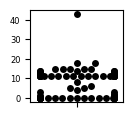

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 70.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


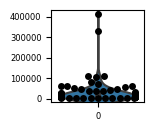

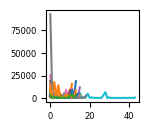

Number of outliers: 2

Average Number of Steps: 8.150537634408602
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30014
Number of reset: 35
Average Number of Steps: 11.578947368421053


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 35.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


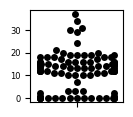

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 66.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


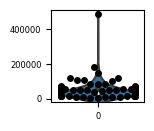

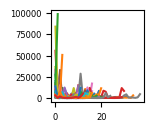

Number of outliers: 1

Average Number of Steps: 11.702127659574469
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30026
Number of reset: 10
Average Number of Steps: 14.694736842105263


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 62.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


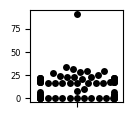

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 38.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


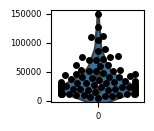

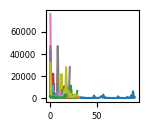

Number of outliers: 2

Average Number of Steps: 14.46236559139785
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30028
Number of reset: 12
Average Number of Steps: 12.536842105263158


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 44.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


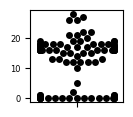

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 52.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


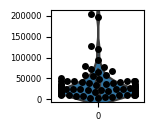

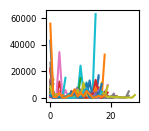

Number of outliers: 2

Average Number of Steps: 12.32258064516129
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30032
Number of reset: 15
Average Number of Steps: 20.221052631578946


/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 41.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


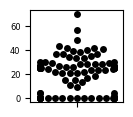

/home/student.unimelb.edu.au/chenyuanz/notebook/jupyterenv/lib/python3.10/site-packages/seaborn/categorical.py:3544: UserWarning: 57.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


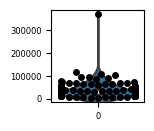

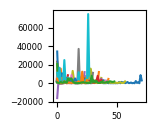

Number of outliers: 1

Average Number of Steps: 20.138297872340427
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
[30001, 30004, 30007, 30008, 30009, 30014, 30026, 30028, 30032]
[30001, 30004, 30007, 30008, 30009, 30014, 30026, 30028, 30032]
840
PearsonRResult(statistic=0.650339688067153, pvalue=0.05789784146147122)
15.233432471593076
35.7843232781328


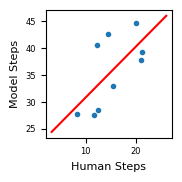

In [66]:
from seaborn import boxplot, swarmplot, violinplot, stripplot
from scipy.stats import zscore
# select unsolvable instances
target_instances = []
for instance in ps_instances:
    m, s = ps_infos[instance]
    if s == -1:
        target_instances.append(instance)

average_steps = []
planning_times = []
all_steps = []
for instance in target_instances:
    reset_count = 0
    steps = []
    total_times = []
    all_rts = []
    for p_responses in ps_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == str(instance):
                this_count = 0
                rts = []
                for i in range(len(i_response['responses'])):
                    rt, key = i_response['responses'][i]
 
                    if key == 'reset':
                        reset_count += 1
                        this_count = 0
                        rts = []
                    elif key == "give_up":
                        rts.append(rt - i_response['responses'][i-1][0])
                    elif key != "space":
                        rts.append(rt - i_response['responses'][i-1][0])
                        this_count += 1
                
                steps.append(this_count)
                total_times.append(i_response['responses'][-1][0]-i_response['responses'][0][0])
                all_rts.append(rts)
                

                

    print(instance)
    print("Number of reset: " + str(reset_count))
    print("Average Number of Steps: " + str(mean(steps)))
#     ax = violinplot(steps)
    swarmplot(steps, color = 'black')
    plt.show()
    
    ax = violinplot(total_times)
    swarmplot(total_times, color = 'black')
    plt.show()
    
    z_time = zscore(total_times)
    
    filter_steps = []
    outlier_count = 0
    sum_planning_time = 0
    for z_t, s, rts in zip(z_time, steps, all_rts):
        if -3<= z_t <= 3:
            plt.plot(rts)
            filter_steps.append(s)
            sum_planning_time += sum(rts[:3])
        else:
            outlier_count += 1
            
    all_steps += filter_steps
    average_steps.append(mean(filter_steps))
    planning_times.append(sum_planning_time/(95-outlier_count))
    plt.show()
    
    print("Number of outliers: " + str(outlier_count))
    print()
    print("Average Number of Steps: " + str(mean(filter_steps)))
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")
    
print(target_instances)
plt.rcParams["figure.figsize"] = [3.5, 3.50]
plt.rcParams["figure.autolayout"] = True

# plt.scatter(average_steps[:4],[i/1000 for i in planning_times[:4]],label="action",marker="d",s=50)
    
hard = [4,5]
left = [7, 8]
top = [6]



# print(mean(all_steps))
# print(mean([int(i/3) for i in model_steps]))
# plt.rcParams["figure.figsize"] = [7.5, 7.5]
# plt.rcParams["figure.autolayout"] = True
# swarmplot(all_steps, color = 'black',label = 'Human')
# swarmplot([i for i in model_steps], color = 'red',label = 'Model')
# plt.ylabel("Number of Steps")
# plt.legend()

SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [1.8, 1.8]
plt.rcParams['lines.markersize'] = 3
print(target_instances)
print(len(all_steps))
plt.scatter(average_steps, [model_steps[i] for i in target_instances])
m, b = np.polyfit(average_steps, [model_steps[i] for i in target_instances], 1)

#add linear regression line to scatterplot 
plt.plot(np.arange(min(average_steps)-5, max(average_steps)+5), m*np.arange(min(average_steps)-5, max(average_steps)+5)+b, color = 'r')
# plt.bar(x_axis+0.2, [(70+71)/(79+77),(49+47)/(74+76)], 0.4, label = "Unsolvable")
# plt.xticks(x_axis, ['Human', "Model"])
from scipy.stats import pearsonr
print(pearsonr(average_steps, [model_steps[i] for i in target_instances]))
ax = plt.gca()
print(mean(average_steps))
print(mean([model_steps[i] for i in target_instances]))
# plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
# ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=sum(a_results)))
# plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2))
plt.ylabel("Model Steps")
plt.xlabel("Human Steps")
# ax.spines[['top']].set_visible(False)
# plt.tight_layout()
plt.savefig("fig2.pdf", format = "pdf", dpi=1200)
plt.show()

# plt.scatter([average_steps[i] for i in hard], [planning_times[i]/1000 for i in hard],label="easy-goal(hard)", marker = "s",s=50)
# plt.scatter([average_steps[i] for i in left], [planning_times[i]/1000 for i in left],label="competing-path(right)", marker = "*",s=50) 
# plt.scatter([average_steps[i] for i in top], [planning_times[i]/1000 for i in top],label="competing-path(top)", marker = "^",s=50)
# plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
# plt.ylabel("Average Time in First three steps")
# plt.xlabel("Average Number of Steps")
plt.show()

### Discussion

As expected, many participants attempted to move the worker when the target was actually unsolvable, but there were evident individual differences in their responses. (clustering using number of moves in each instance and initial thinking time ratio as the features?)

## Solvable instances

We want to look how close their sollution to the optimal solution.

[30002, 30003, 30005, 30006, 30010, 30011, 30012, 30013, 30015, 30027, 30029, 30030, 30031, 30033]
30002
Number of reset: 2
Ratio of giveup: 4.21%


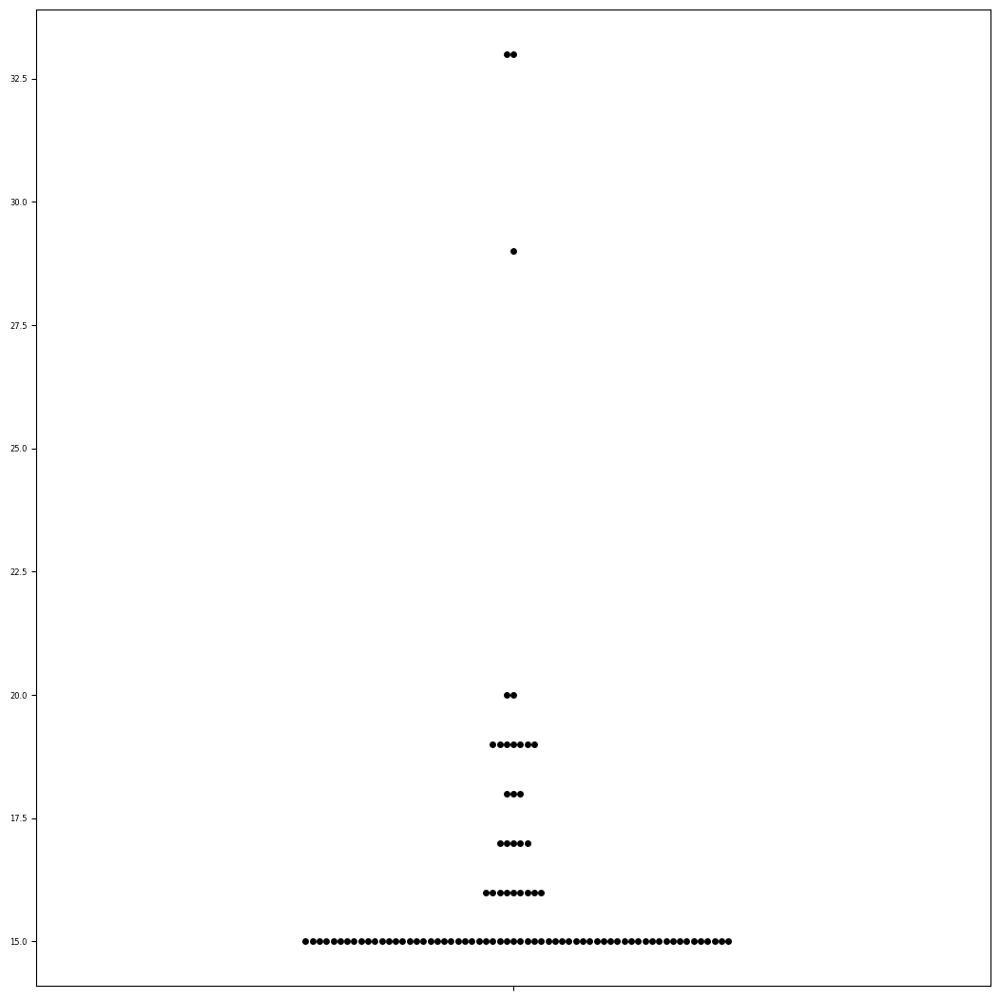

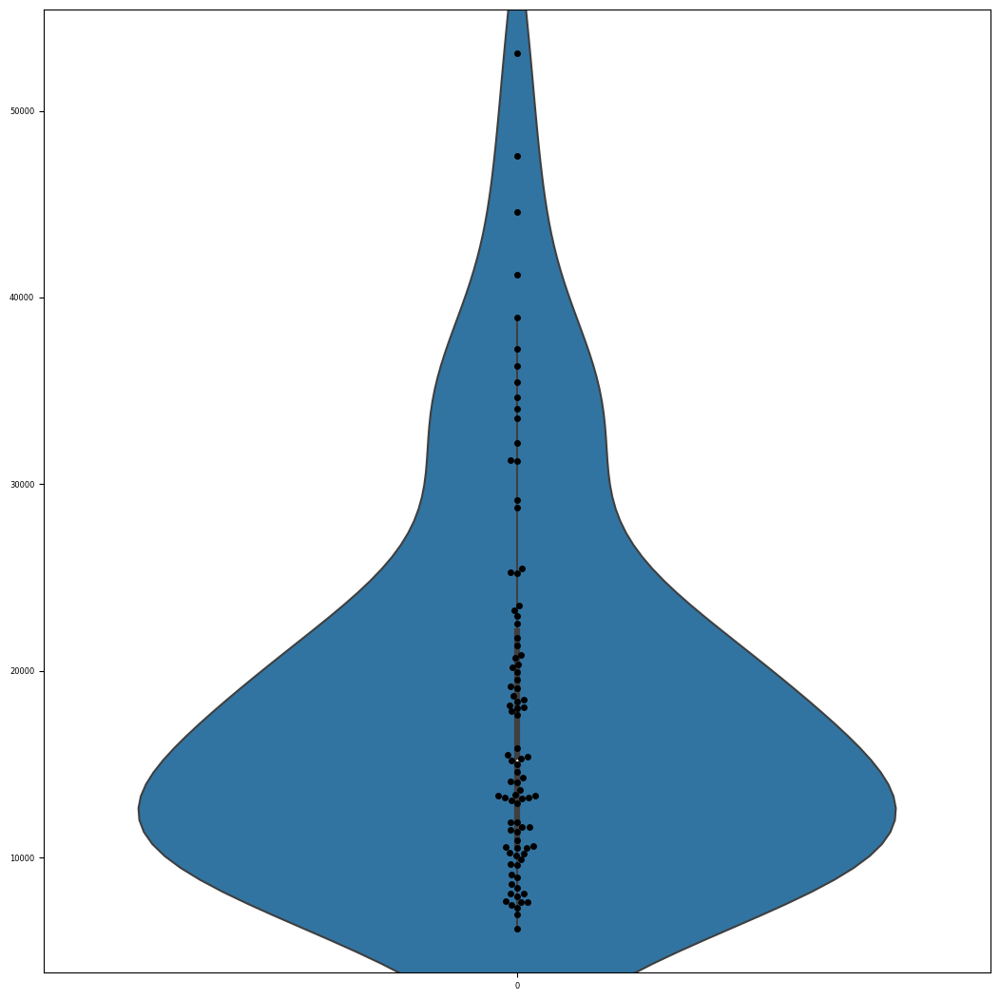

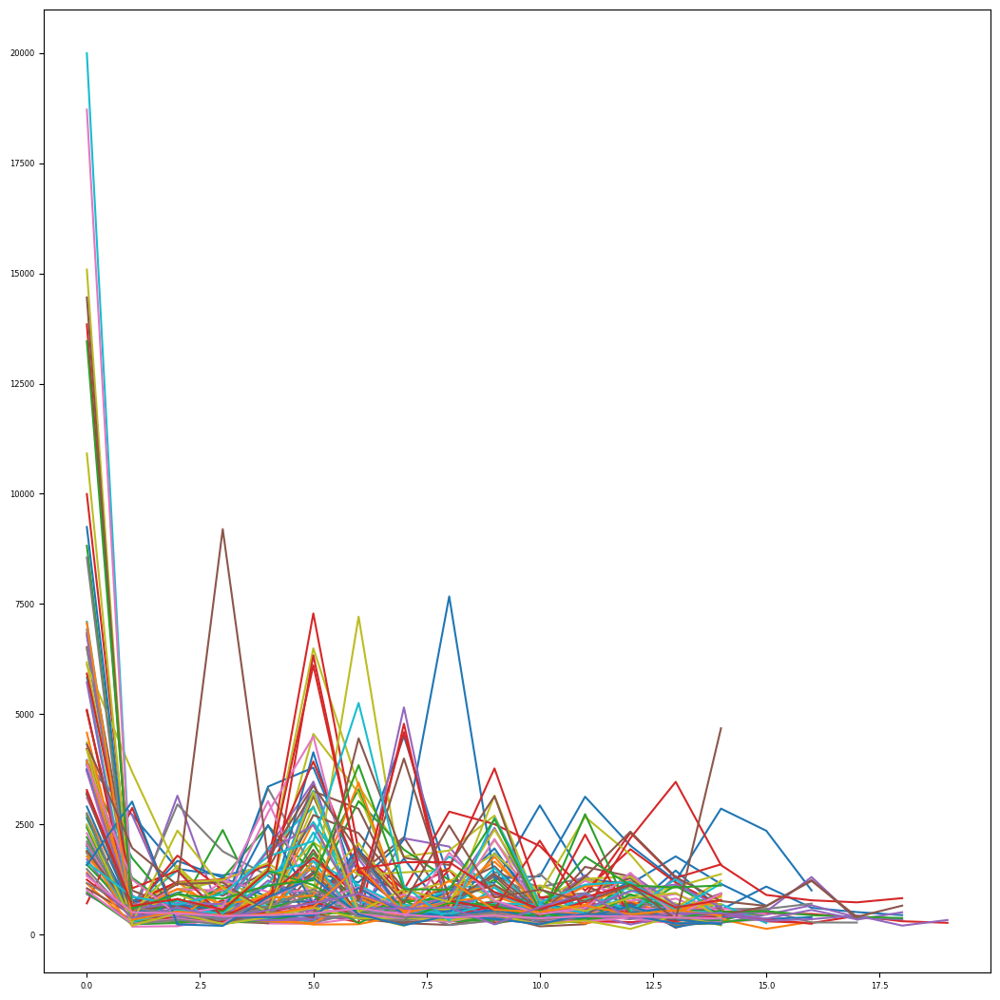

Number of outliers: 4

Optimal cost: 15
Ratio of optimal solutions: 65.26%
Average Number of Steps: 15.758620689655173
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30003
Number of reset: 6
Ratio of giveup: 3.16%


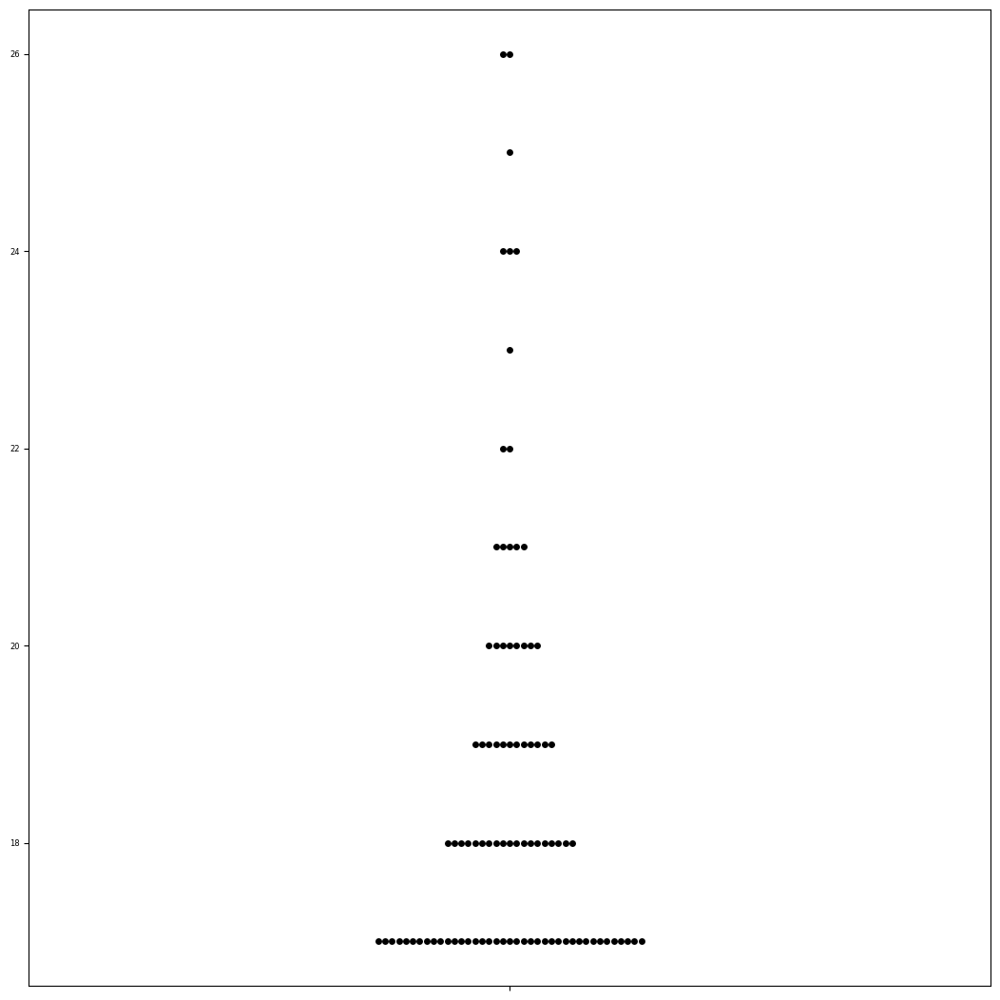

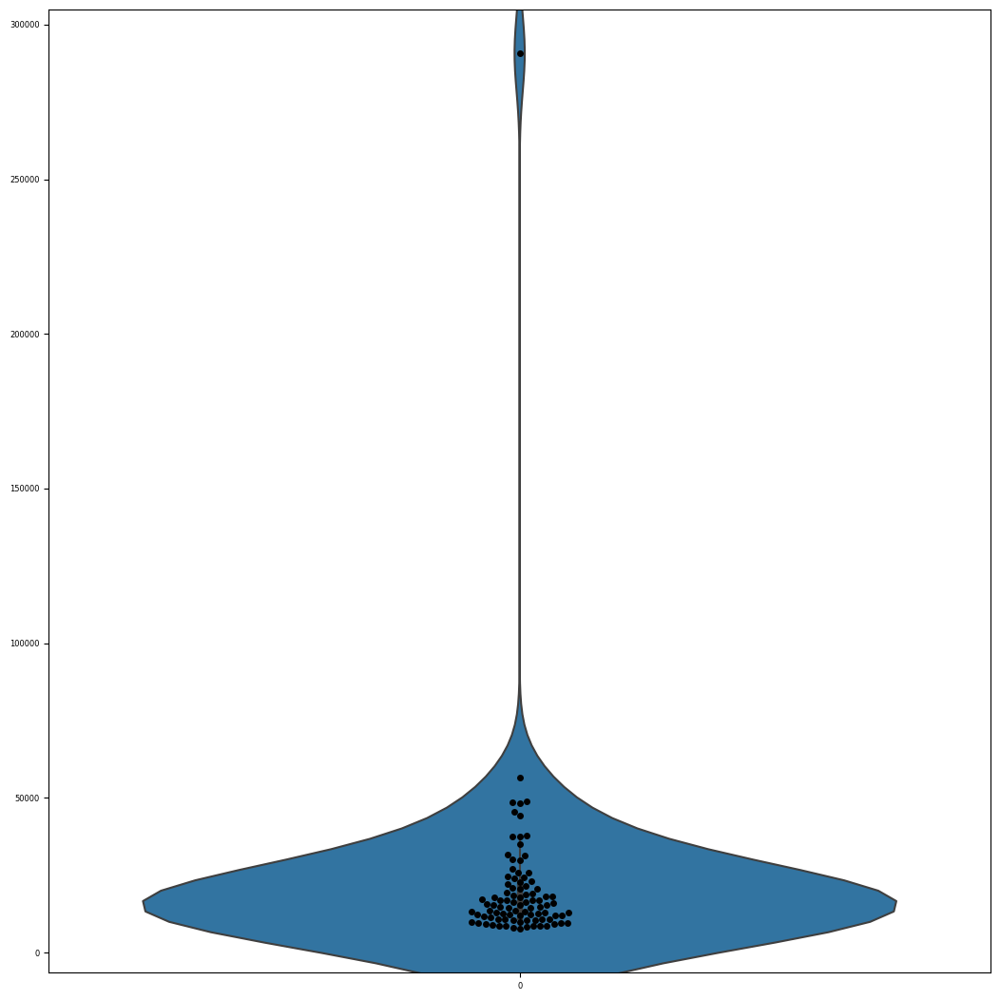

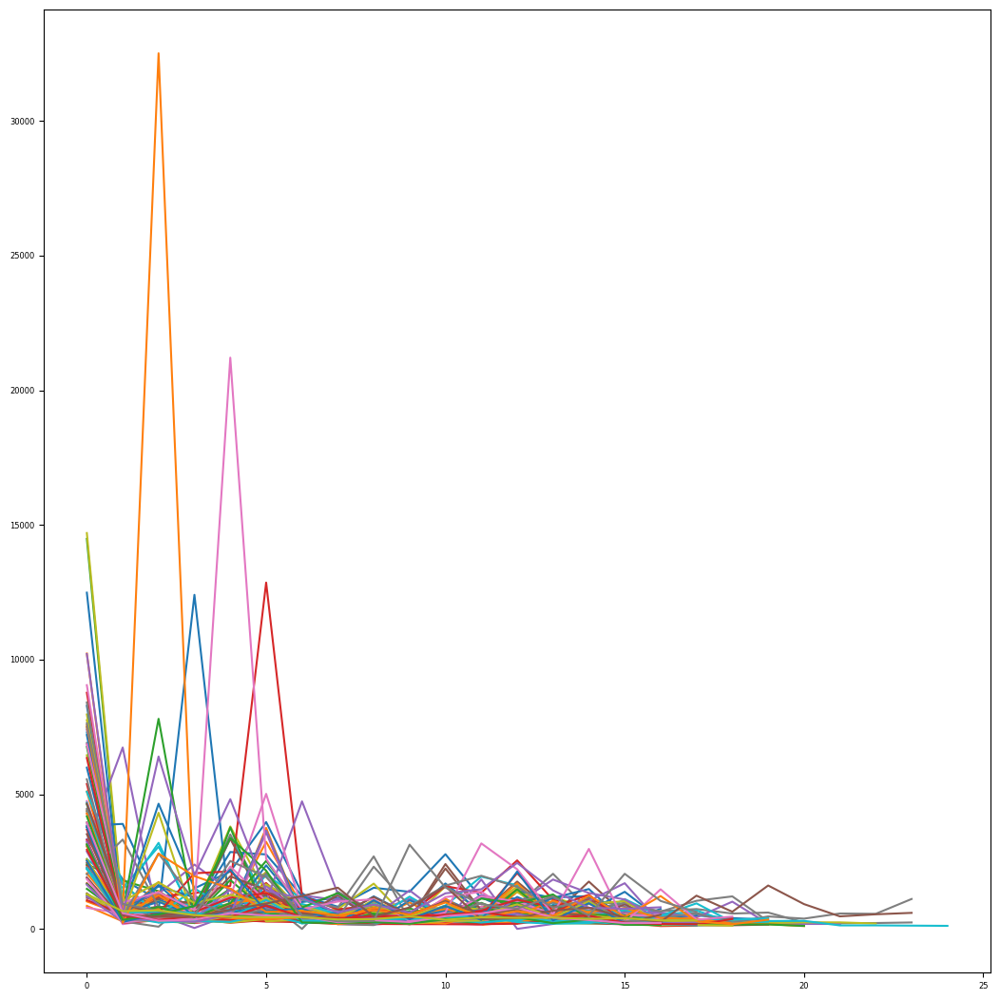

Number of outliers: 3

Optimal cost: 17
Ratio of optimal solutions: 41.05%
Average Number of Steps: 18.471910112359552
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30005
Number of reset: 15
Ratio of giveup: 25.26%


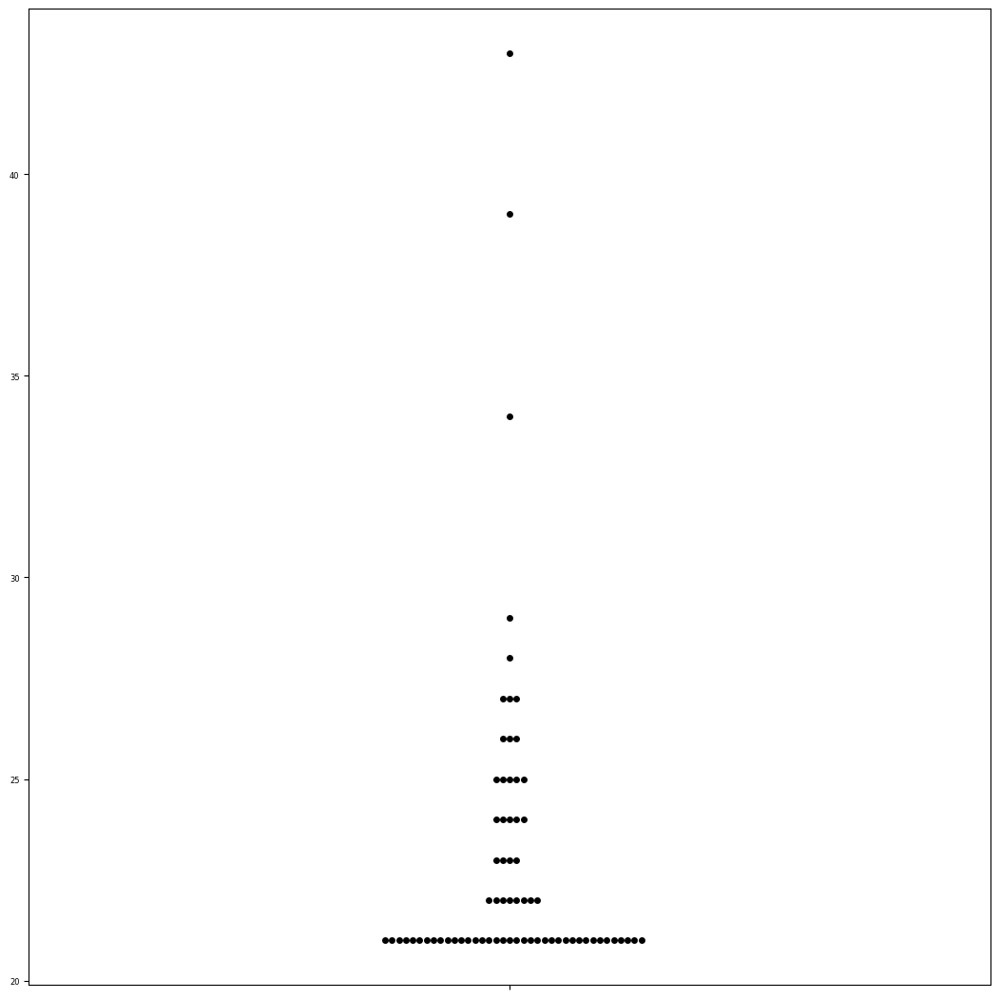

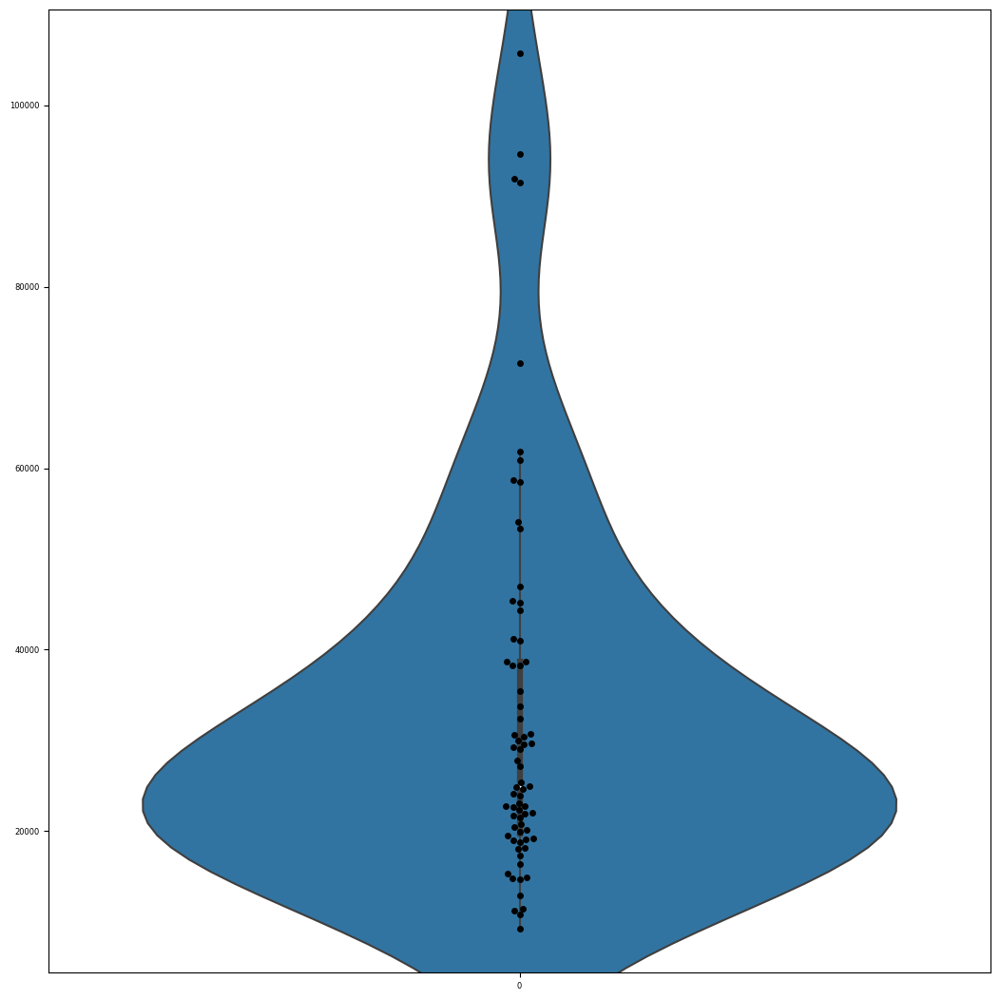

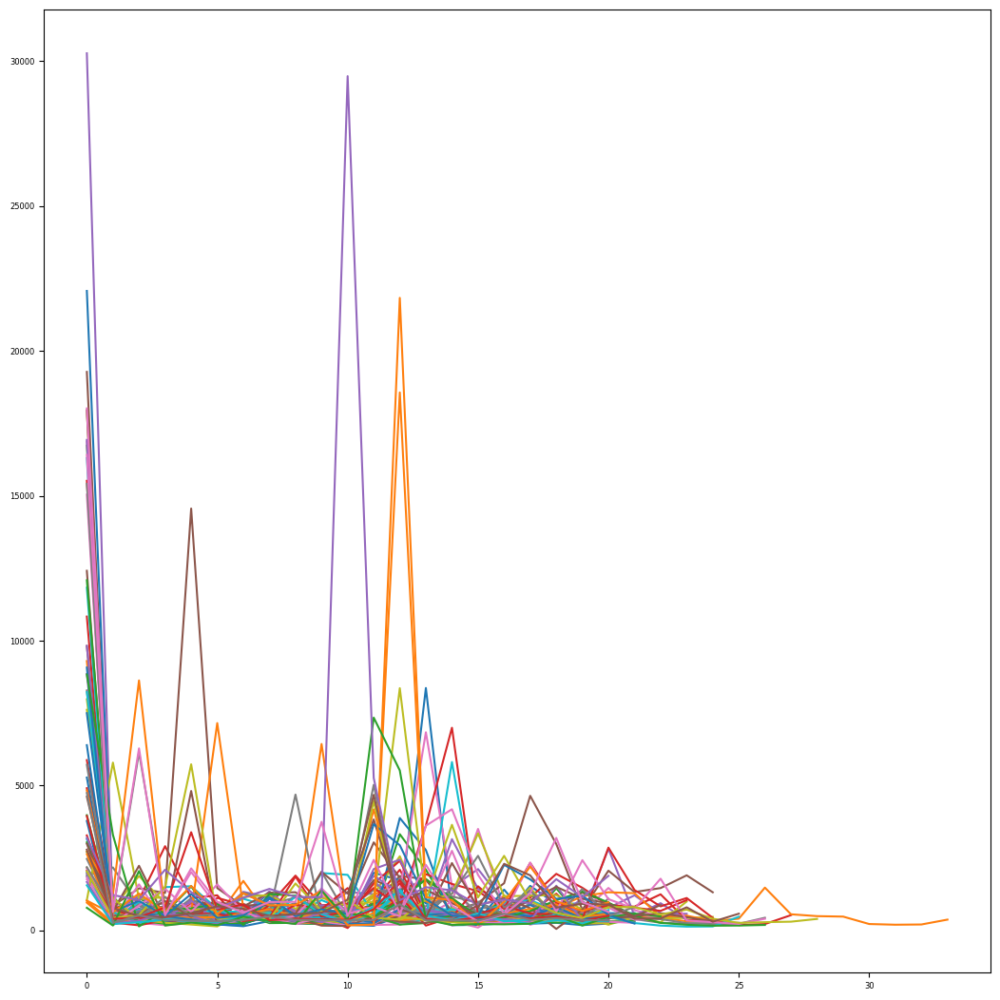

Number of outliers: 3

Optimal cost: 21
Ratio of optimal solutions: 40.0%
Average Number of Steps: 22.647058823529413
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30006
Number of reset: 15
Ratio of giveup: 21.05%


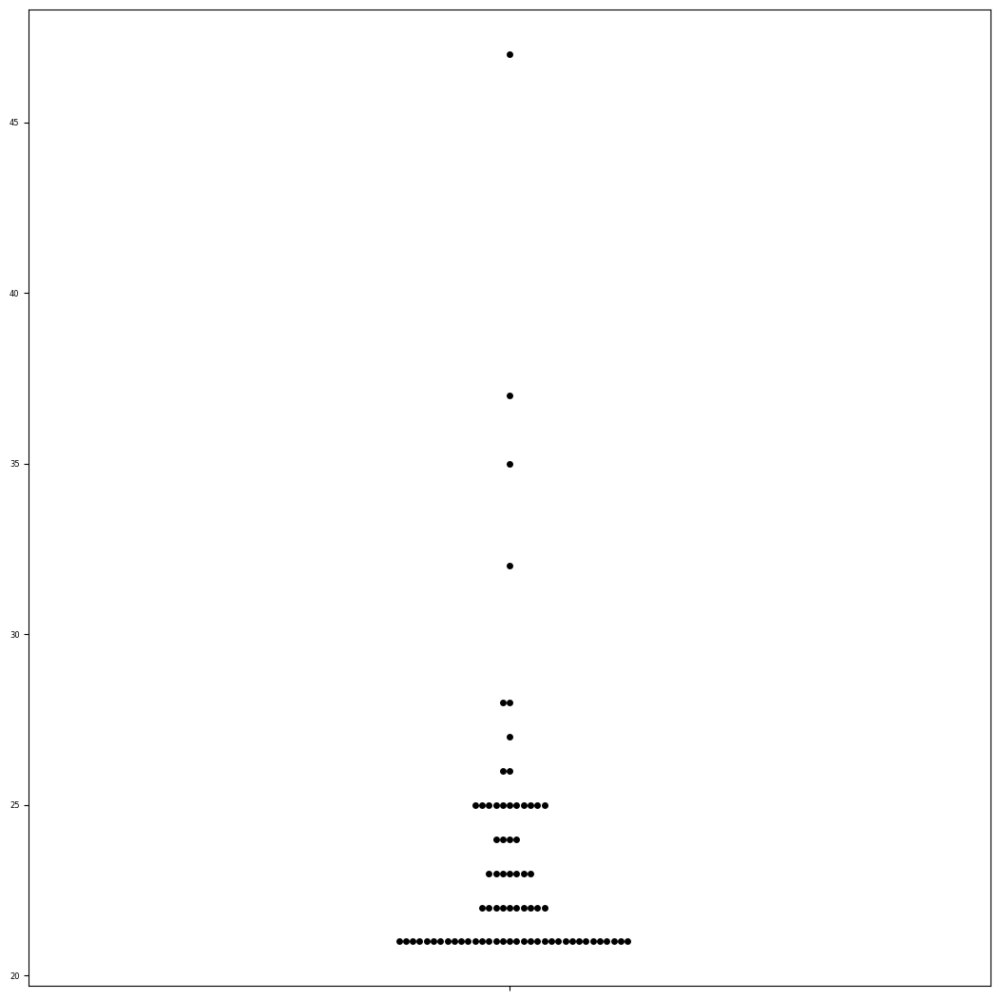

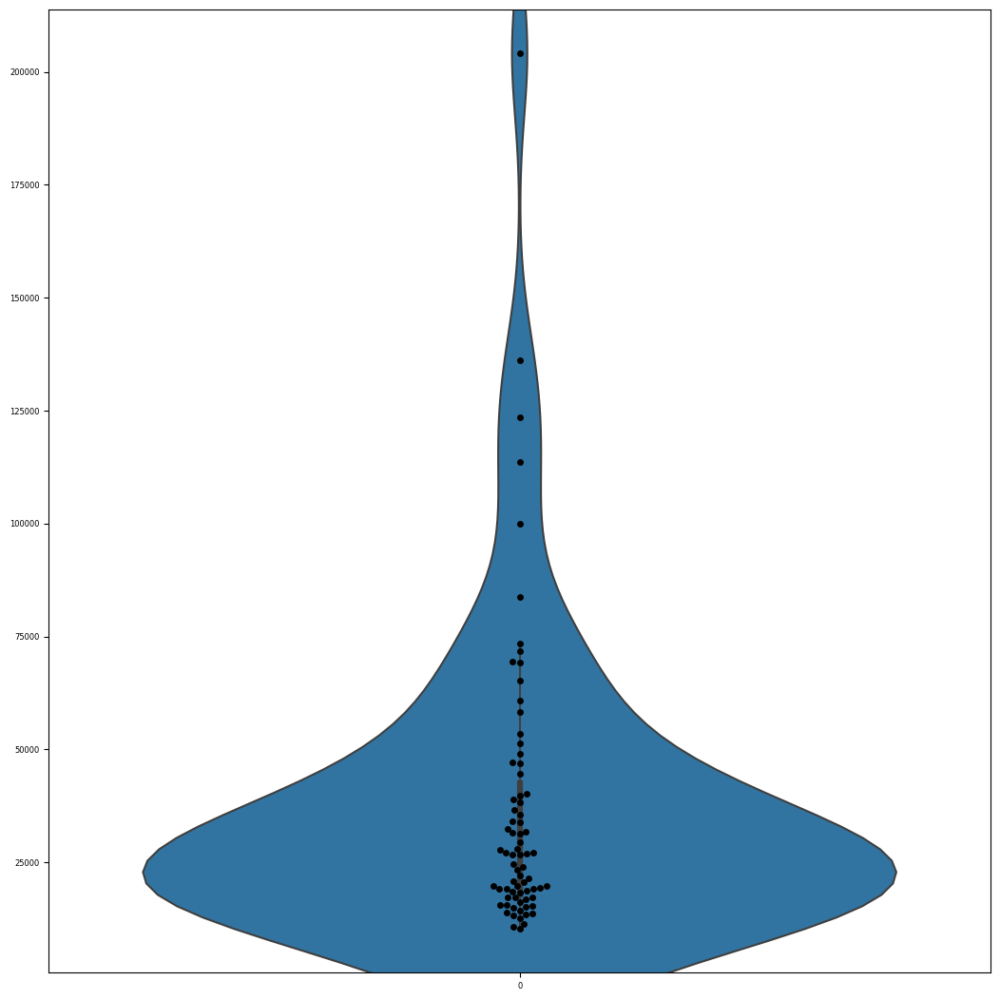

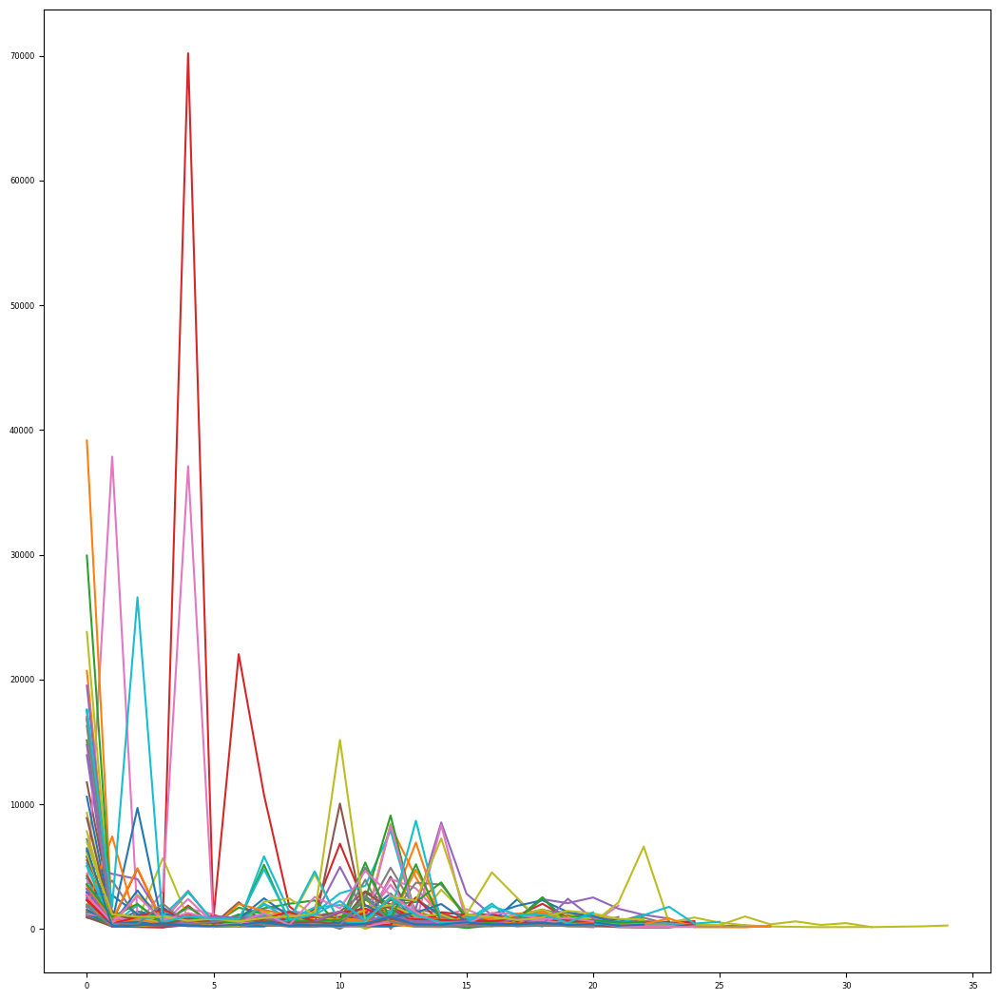

Number of outliers: 4

Optimal cost: 21
Ratio of optimal solutions: 35.79%
Average Number of Steps: 22.802816901408452
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30010
Number of reset: 0
Ratio of giveup: 1.05%


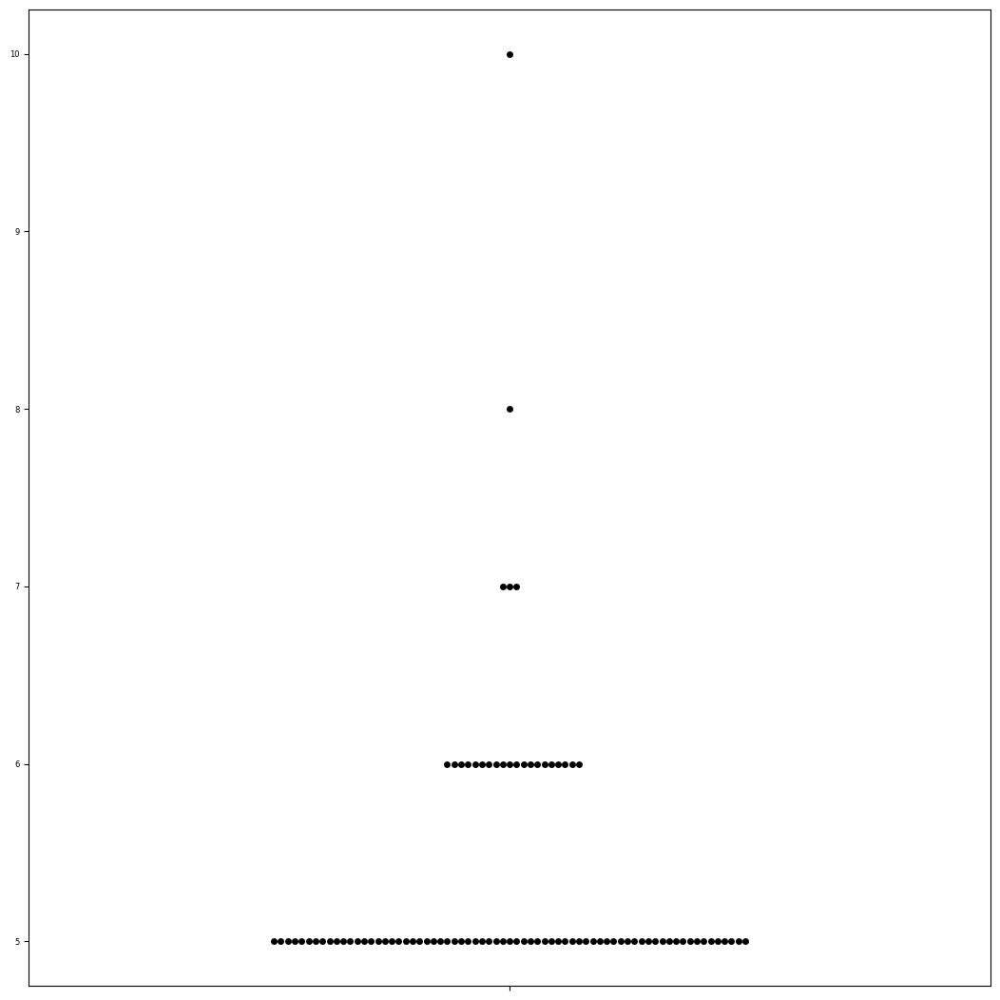

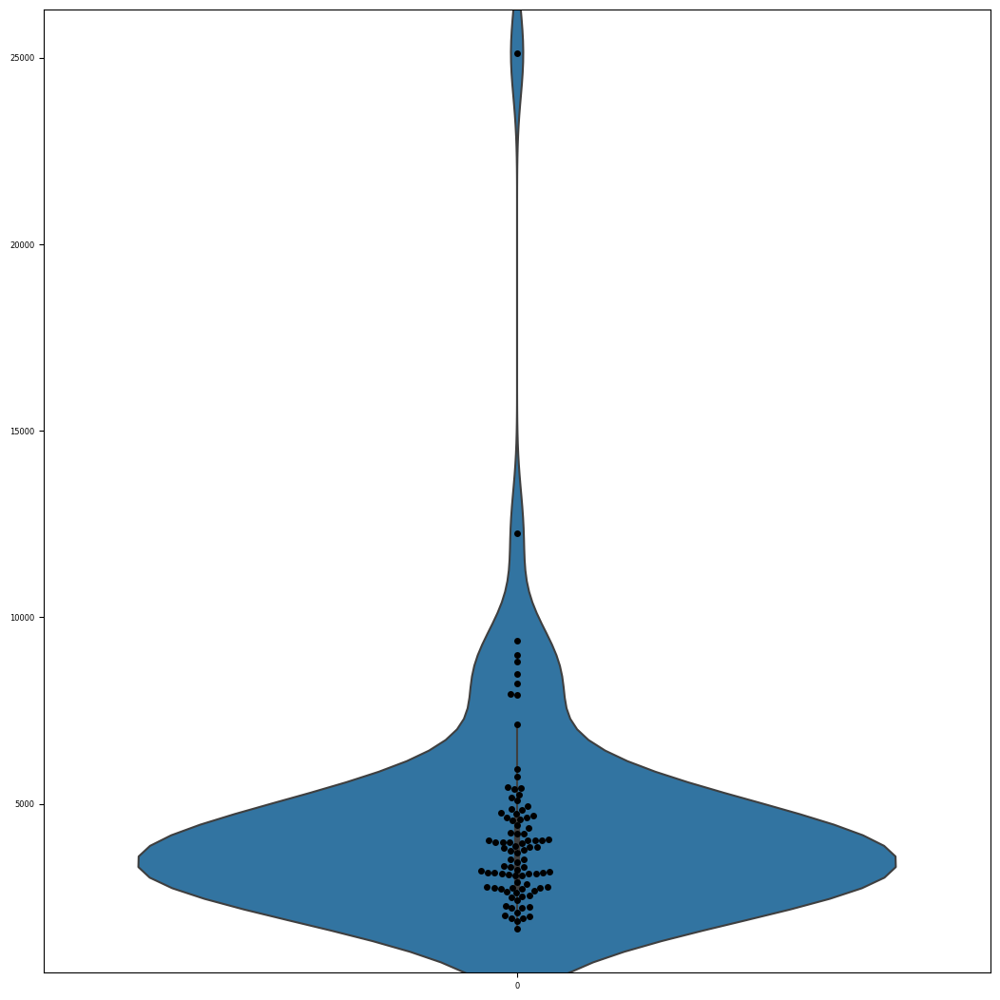

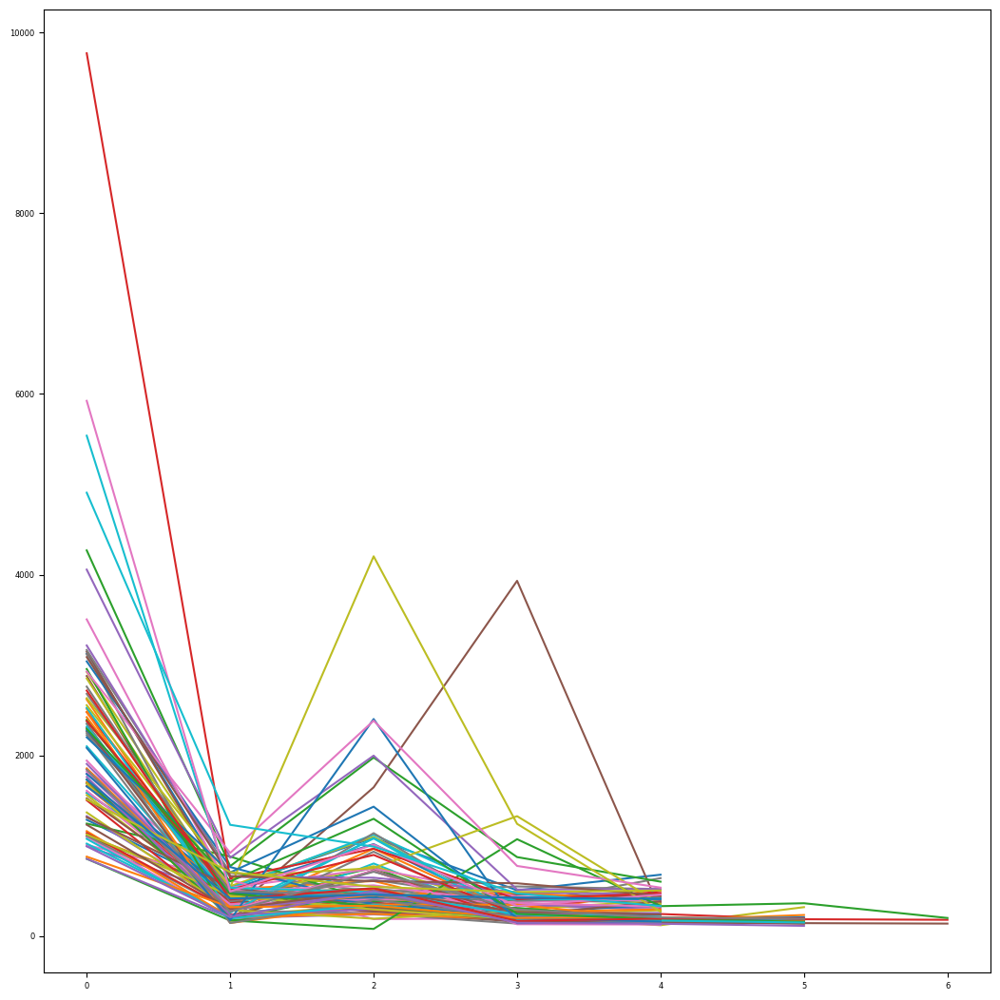

Number of outliers: 3

Optimal cost: 5
Ratio of optimal solutions: 72.63%
Average Number of Steps: 5.285714285714286
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30011
Number of reset: 1
Ratio of giveup: 25.26%


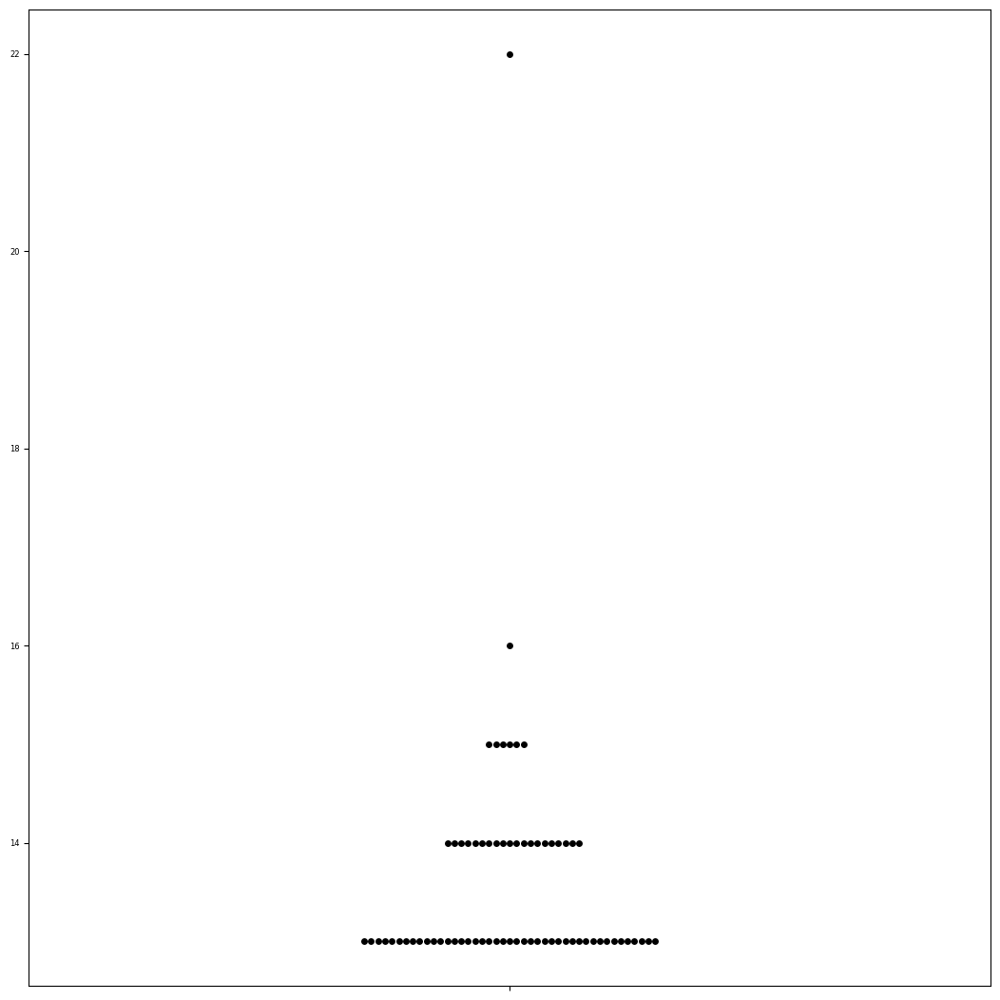

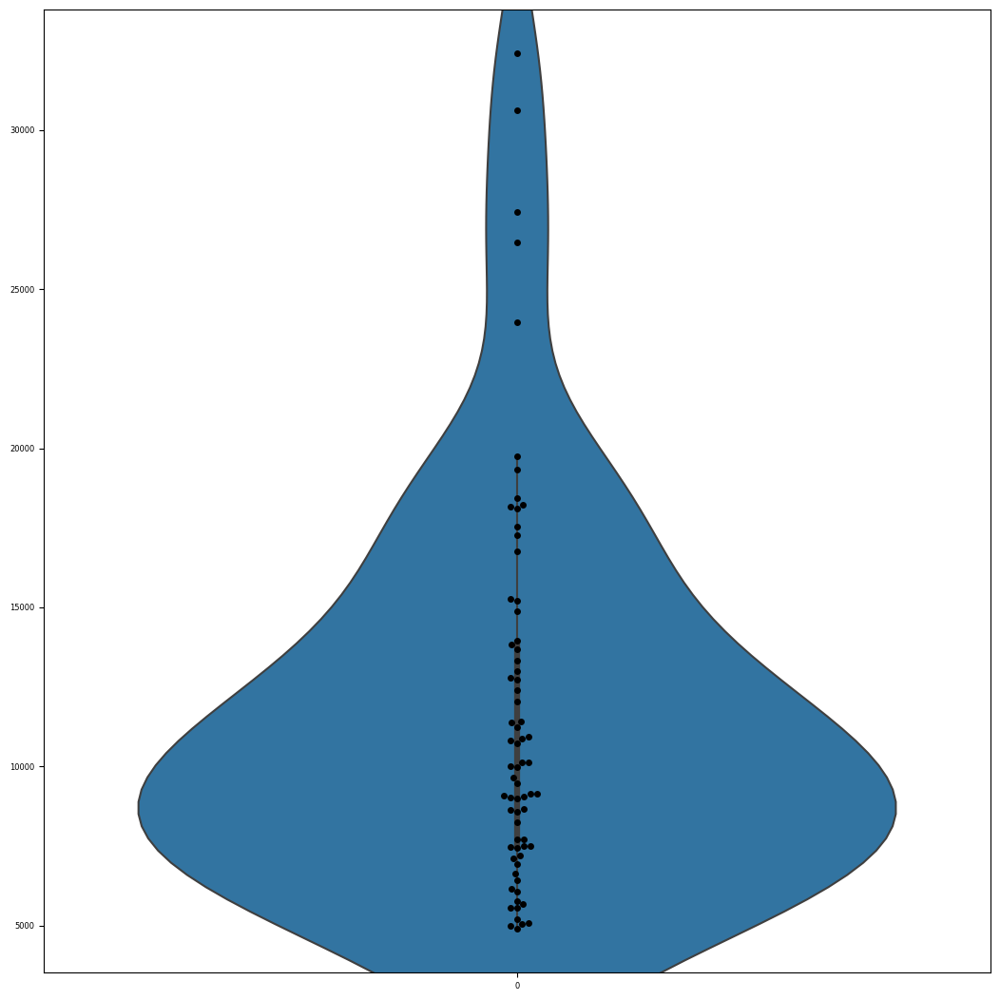

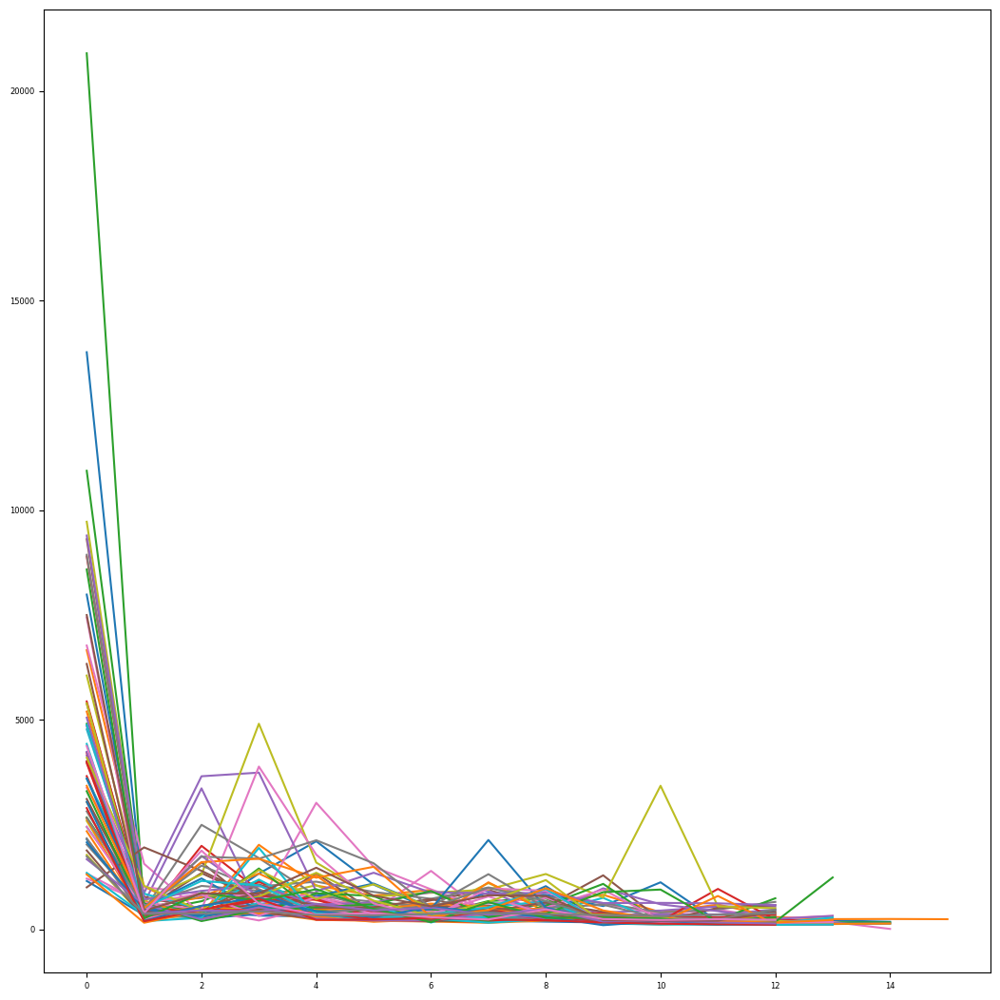

Number of outliers: 3

Optimal cost: 13
Ratio of optimal solutions: 45.26%
Average Number of Steps: 13.5
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30012
Number of reset: 15
Ratio of giveup: 10.53%


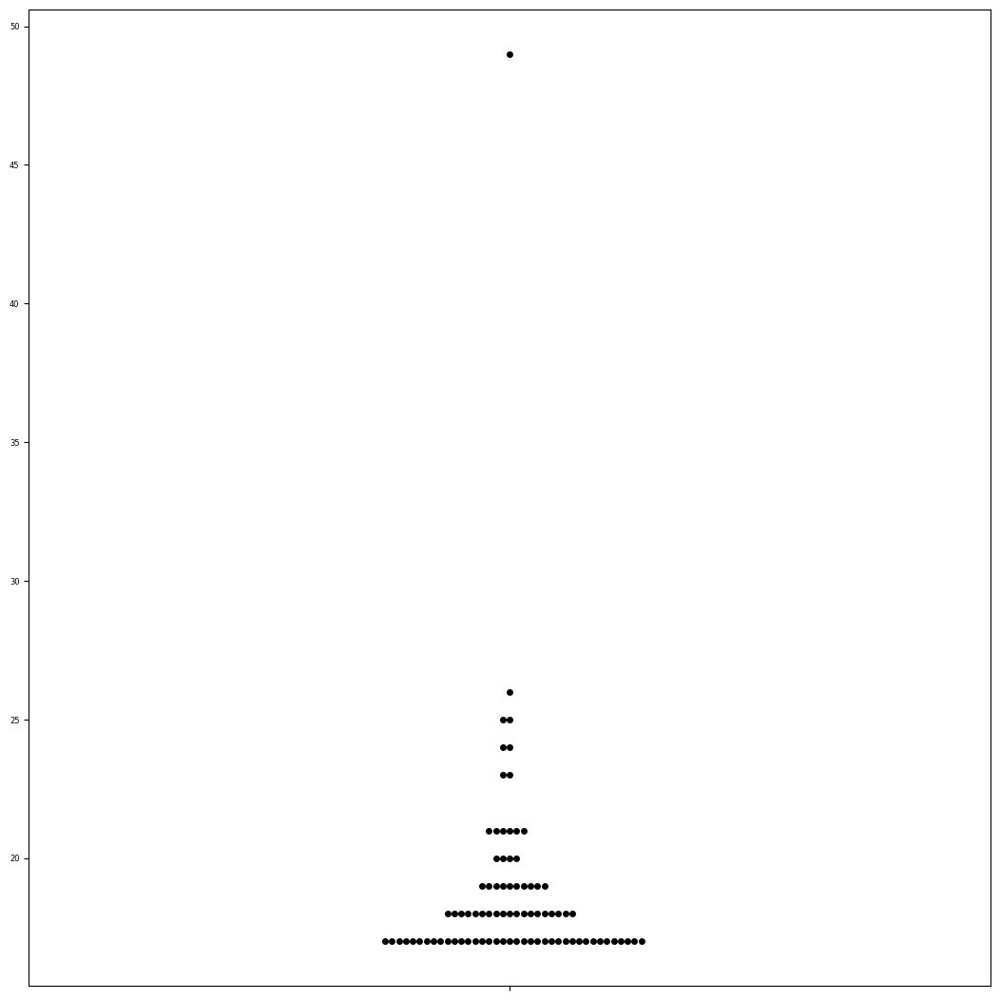

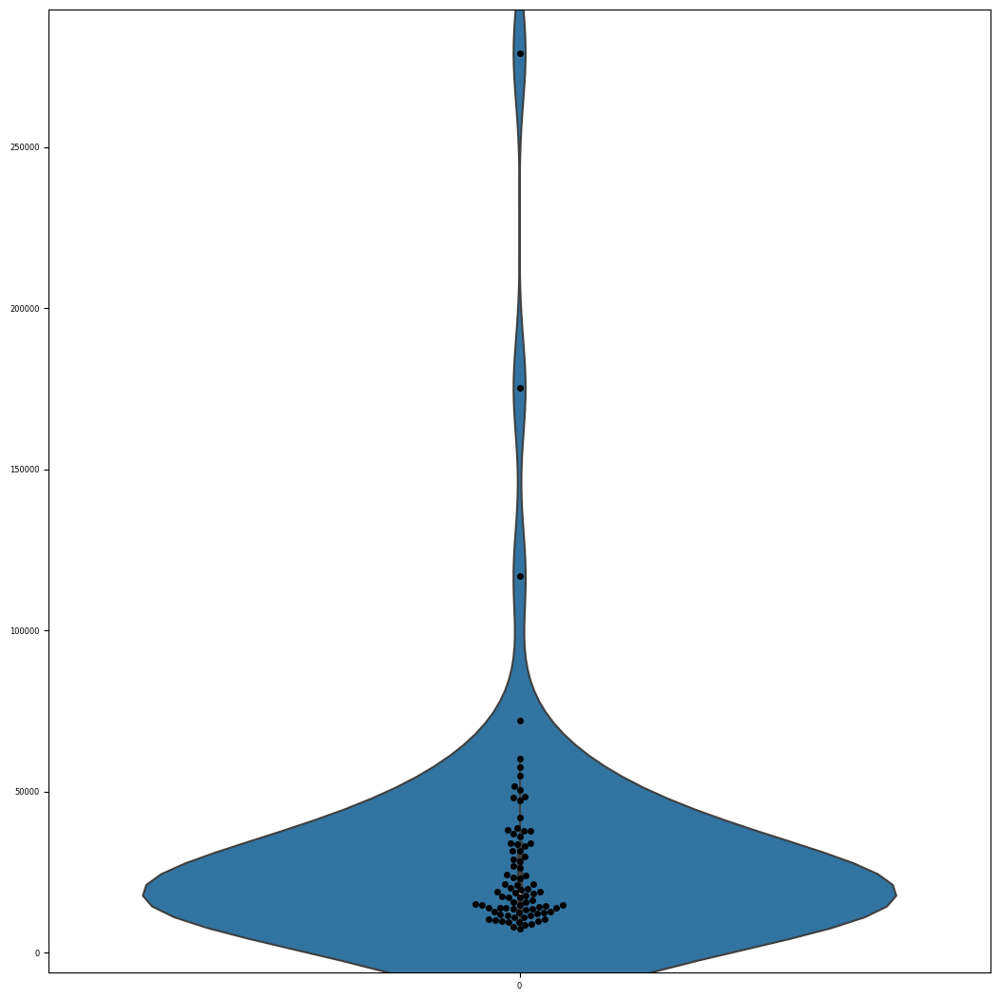

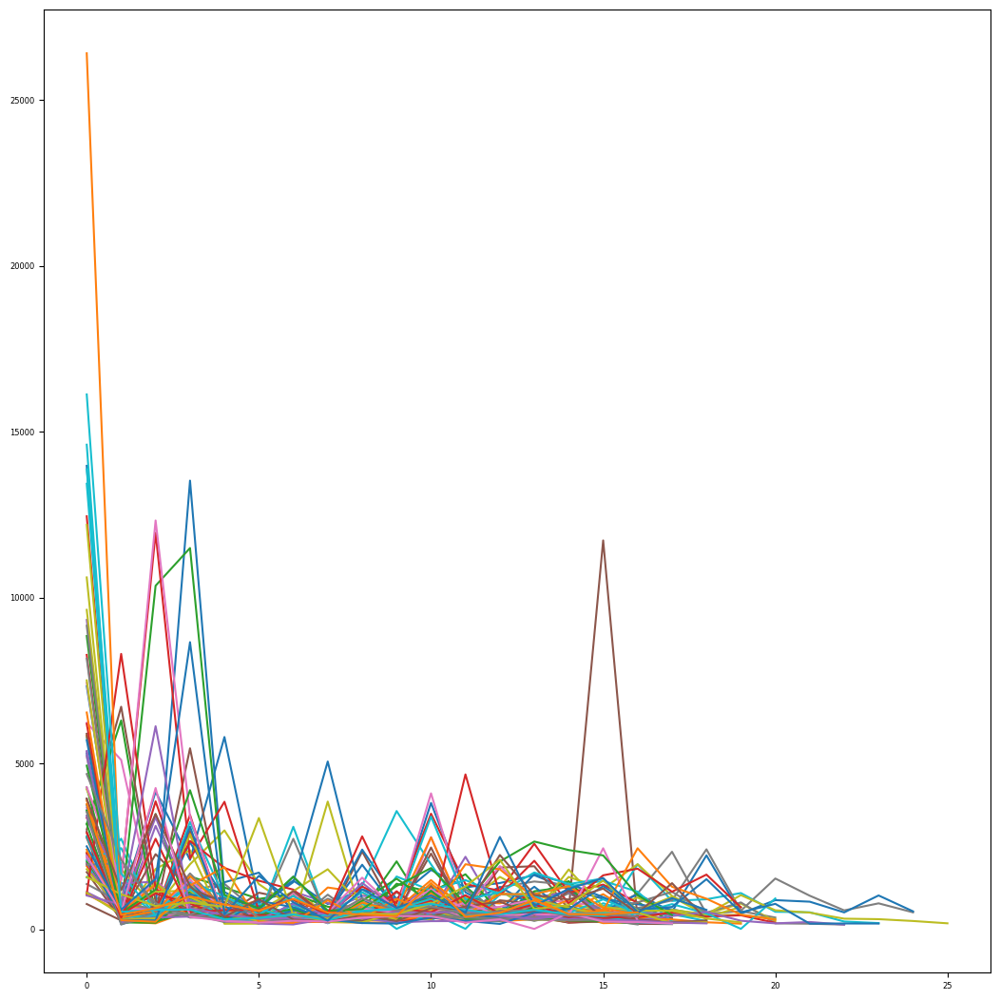

Number of outliers: 3

Optimal cost: 17
Ratio of optimal solutions: 40.0%
Average Number of Steps: 18.524390243902438
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30013
Number of reset: 0
Ratio of giveup: 0.0%


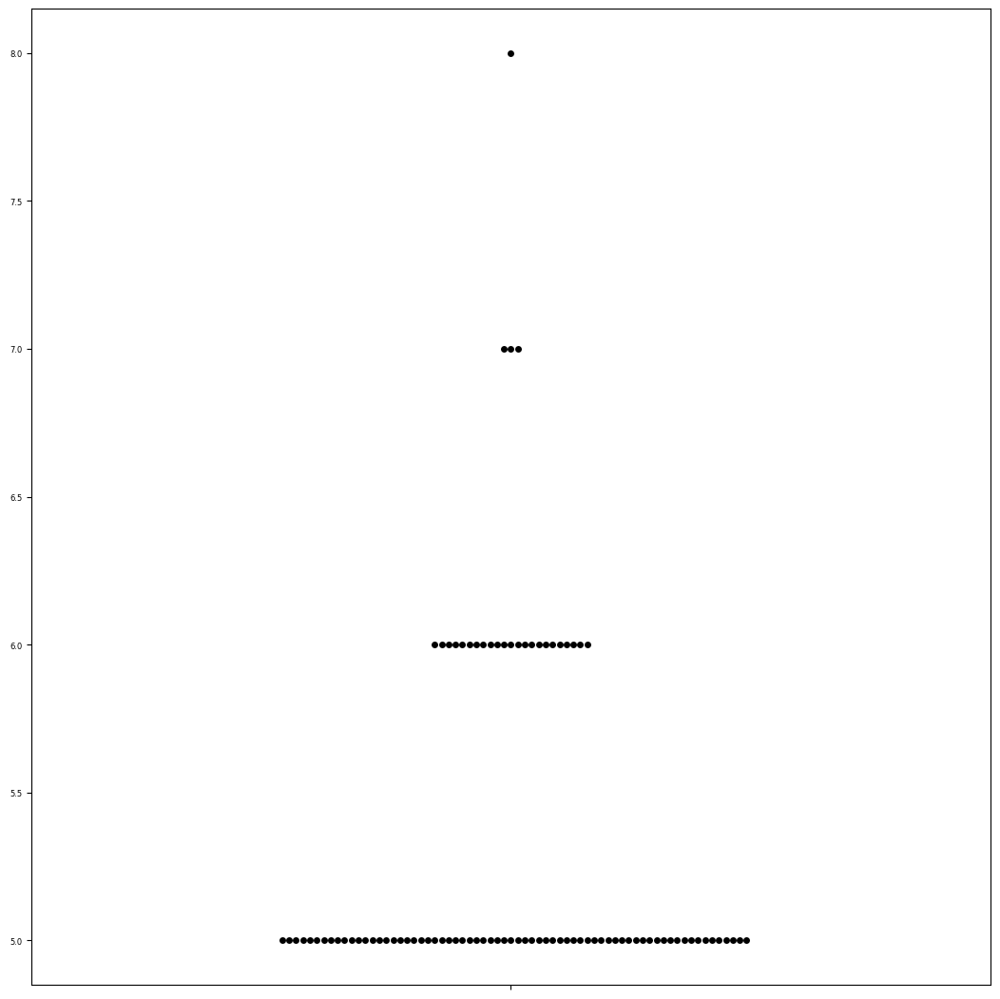

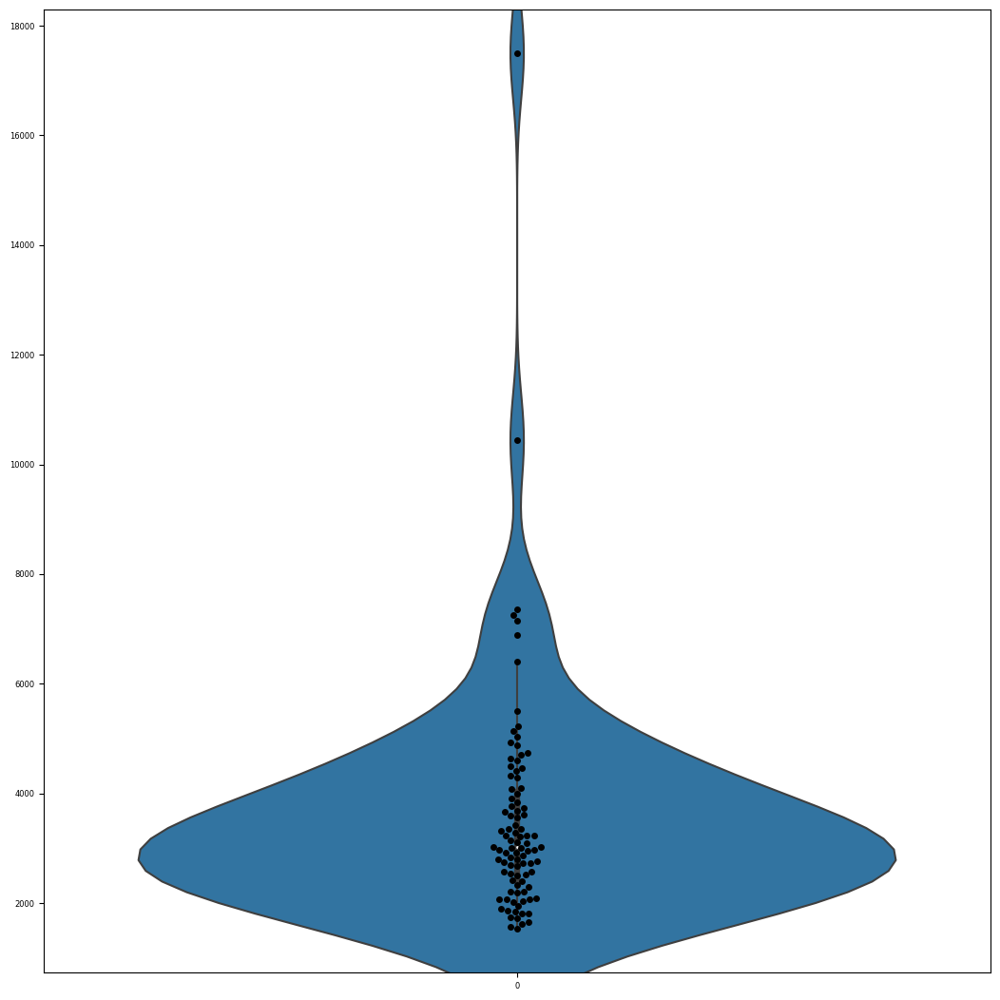

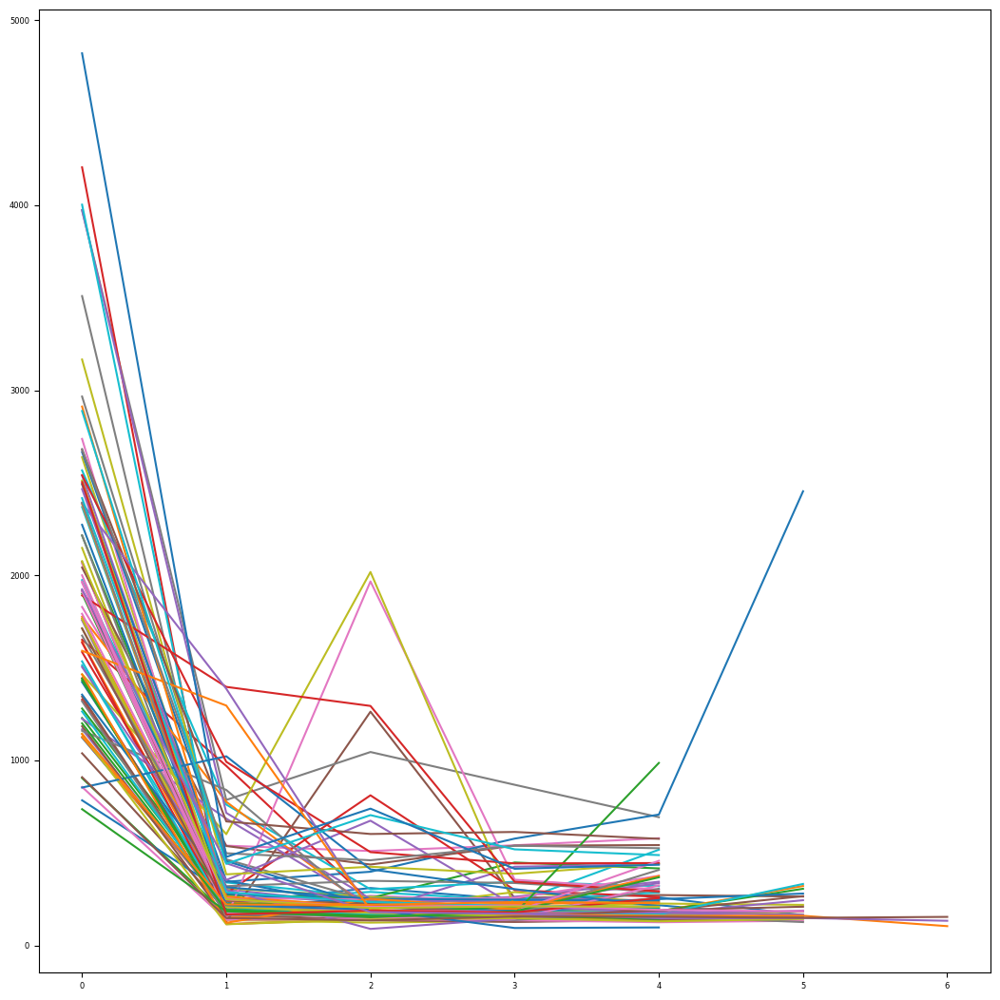

Number of outliers: 3

Optimal cost: 5
Ratio of optimal solutions: 71.58%
Average Number of Steps: 5.315217391304348
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30015
Number of reset: 0
Ratio of giveup: 0.0%


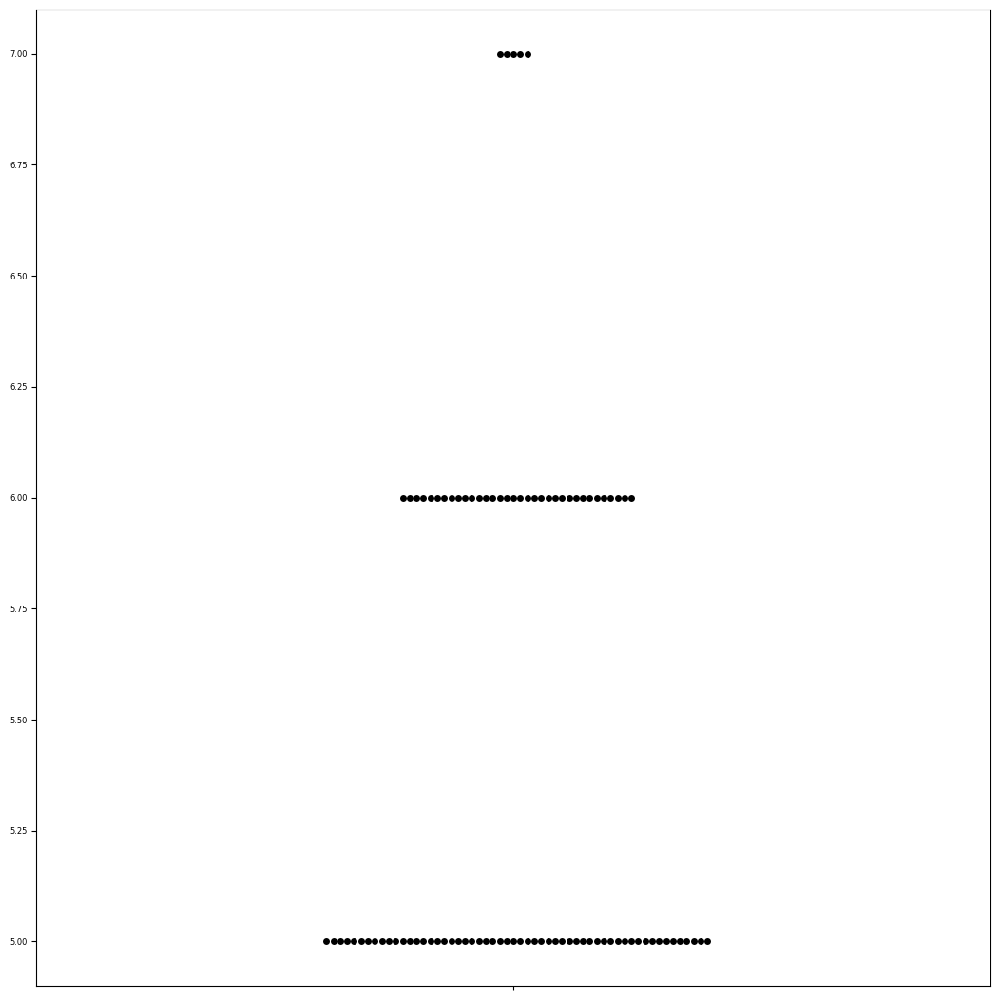

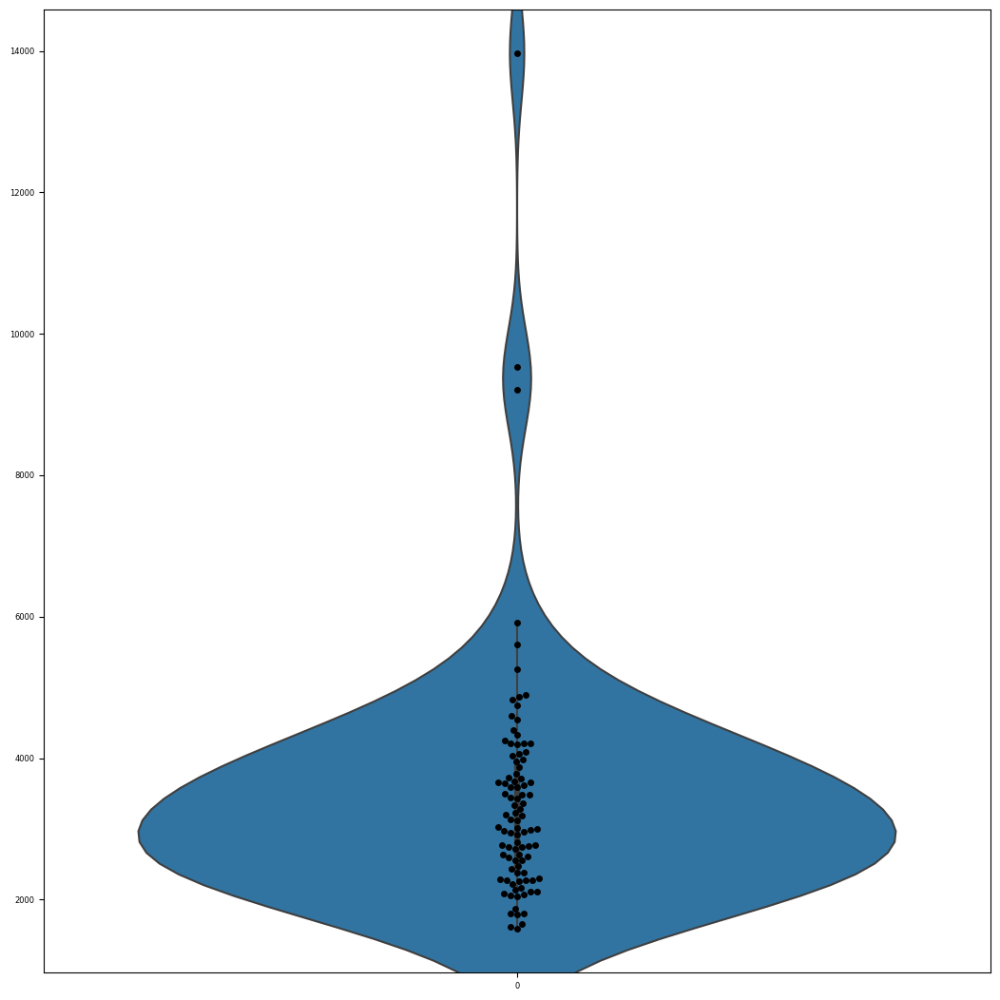

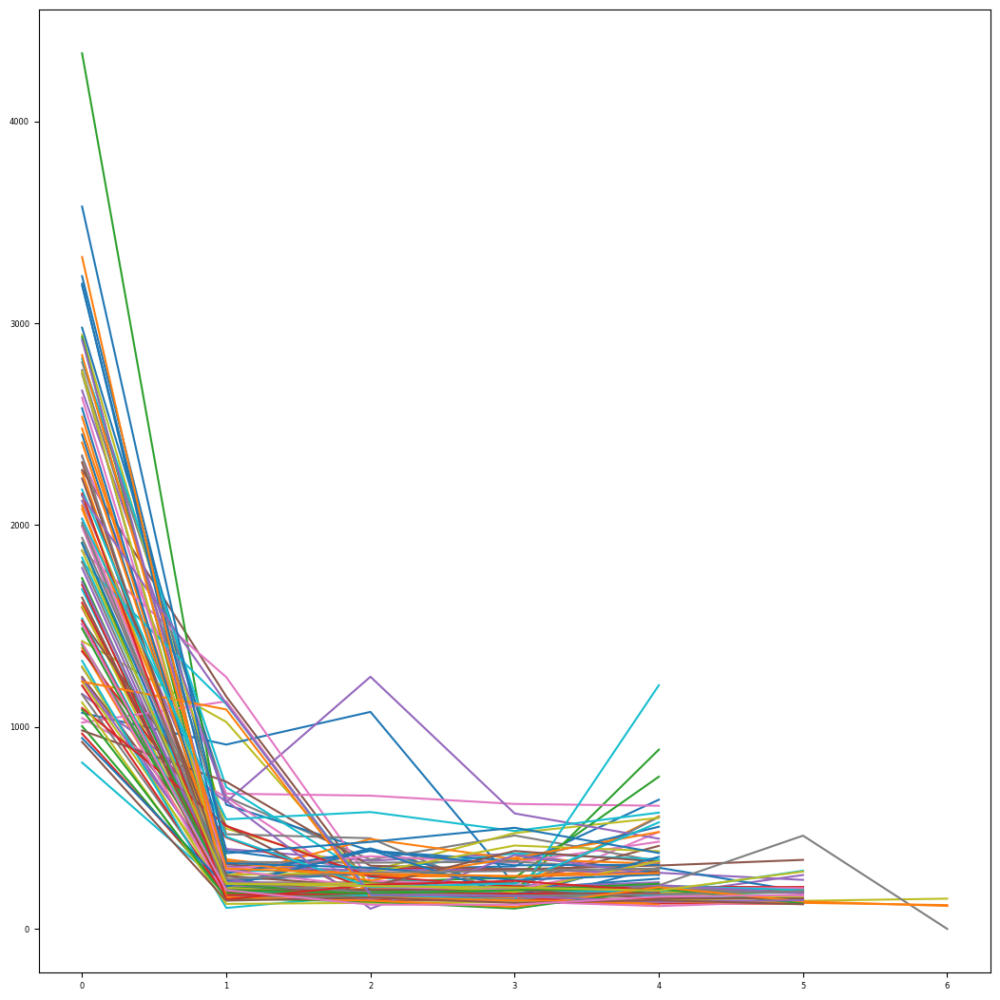

Number of outliers: 3

Optimal cost: 5
Ratio of optimal solutions: 58.95%
Average Number of Steps: 5.445652173913044
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30027
Number of reset: 2
Ratio of giveup: 1.05%


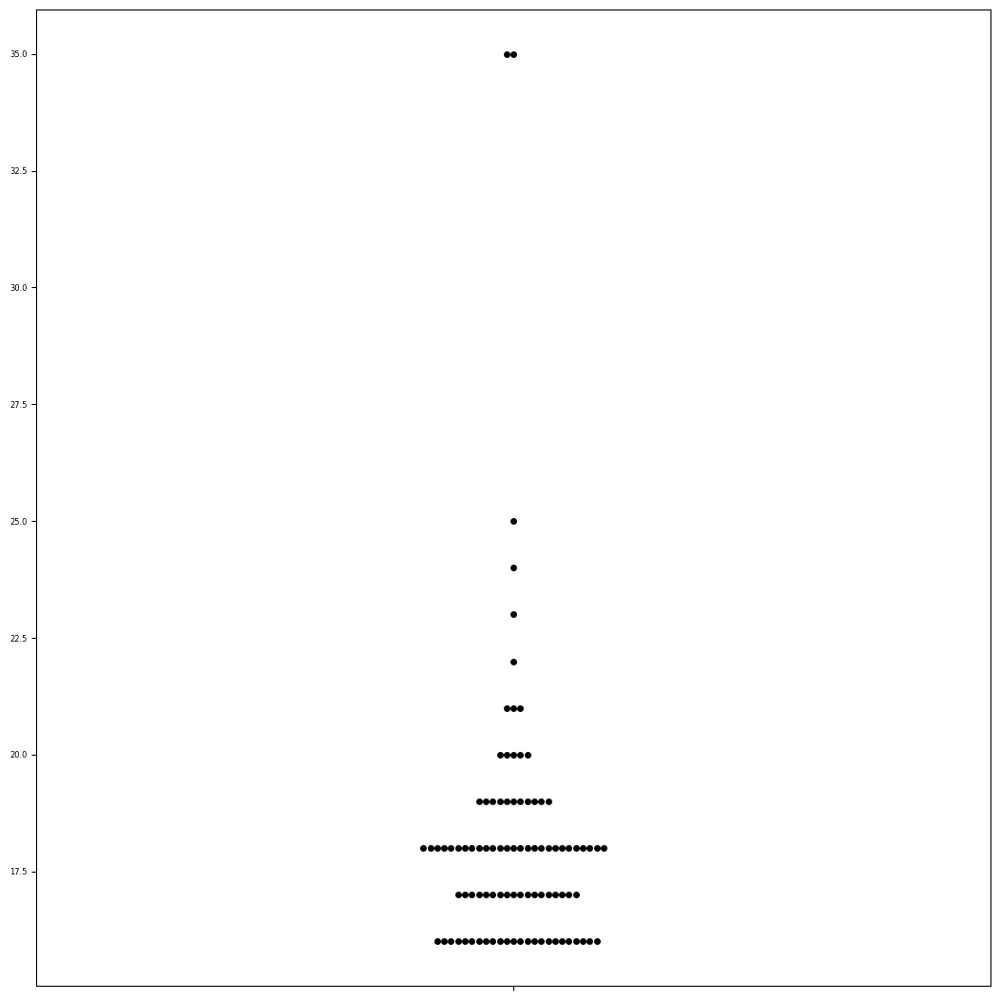

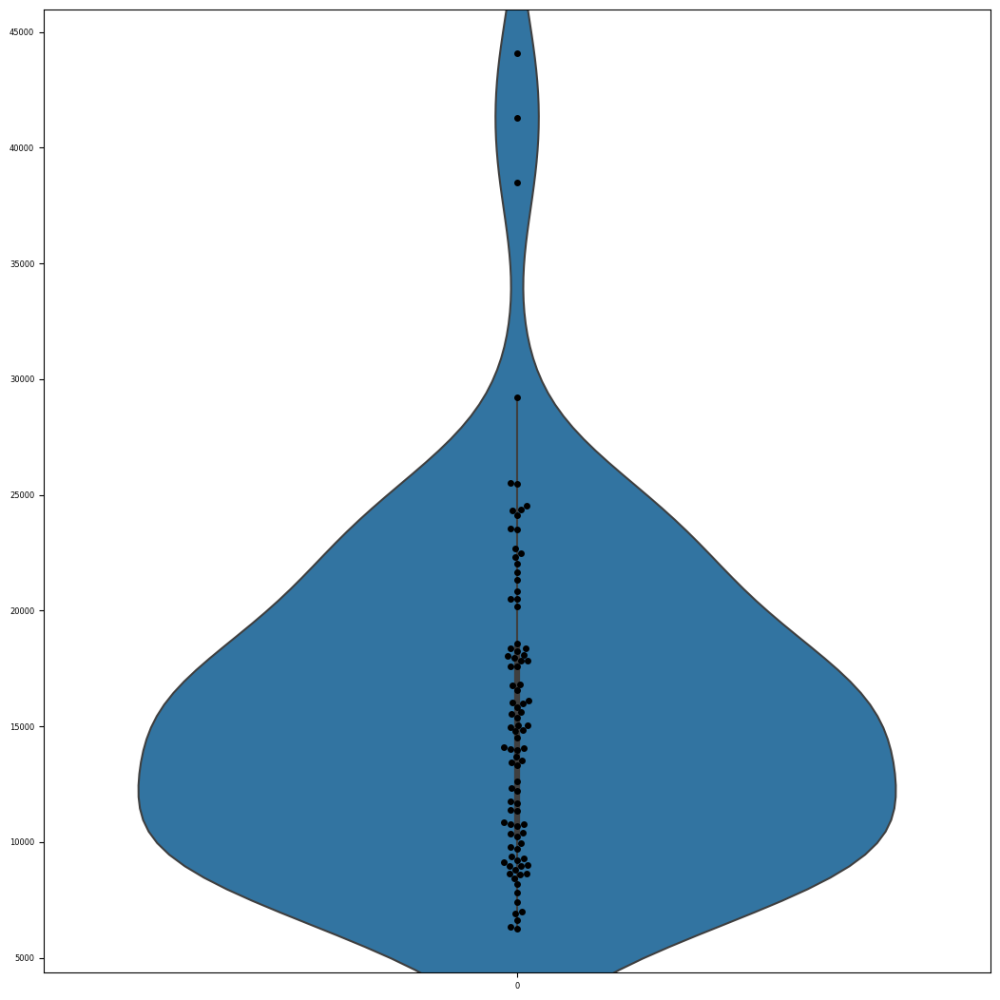

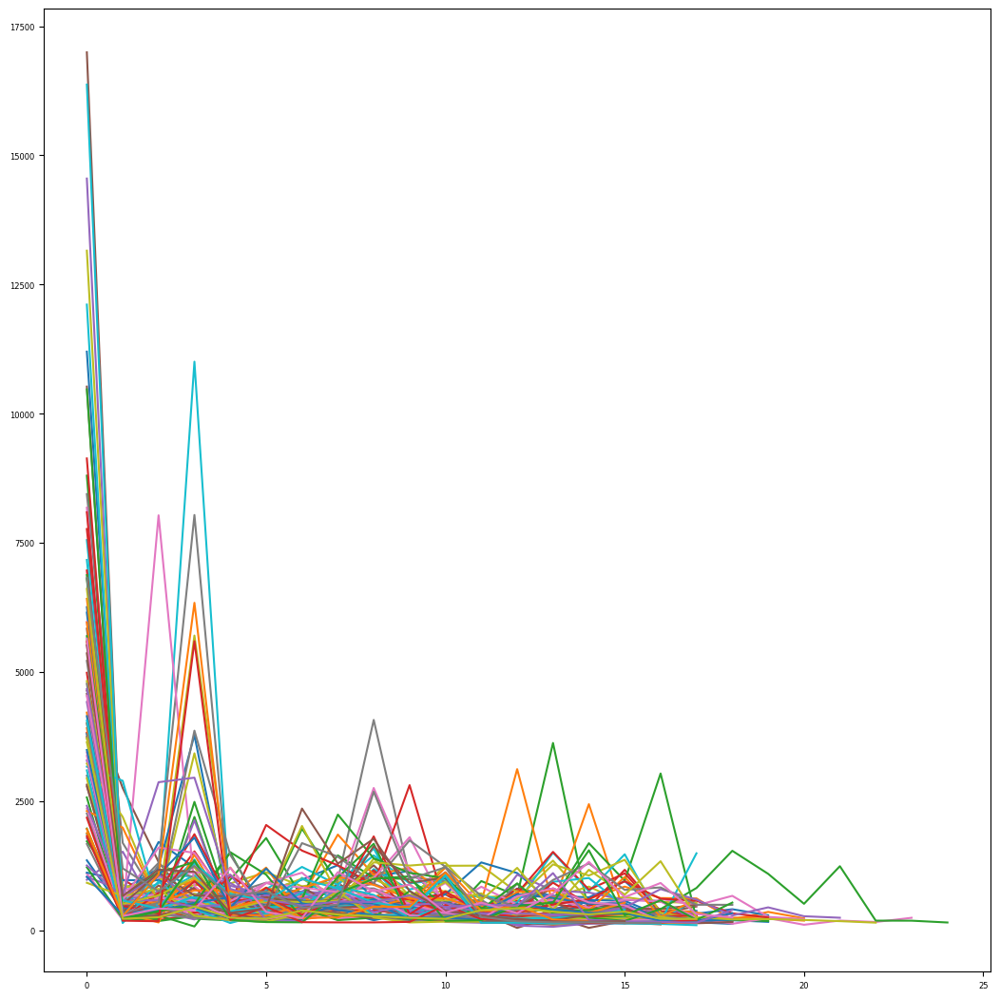

Number of outliers: 5

Optimal cost: 16
Ratio of optimal solutions: 25.26%
Average Number of Steps: 17.865168539325843
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30029
Number of reset: 2
Ratio of giveup: 1.05%


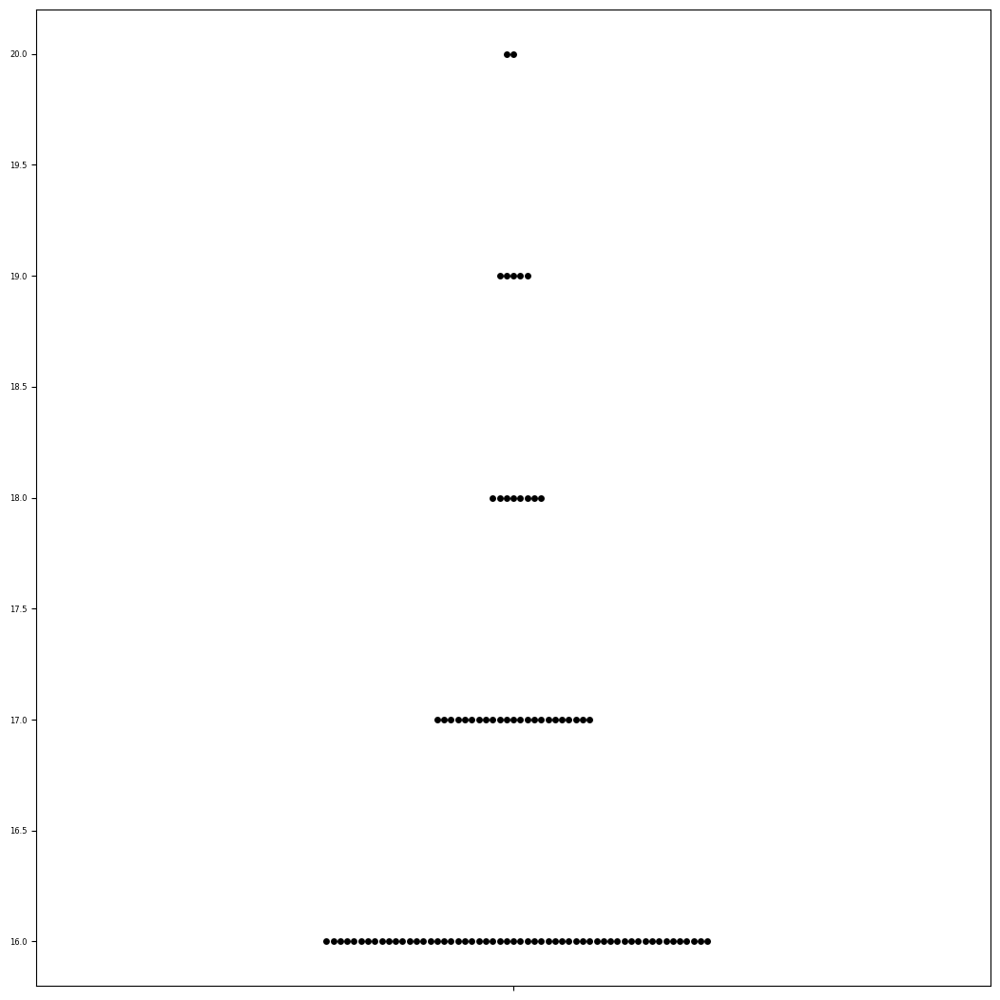

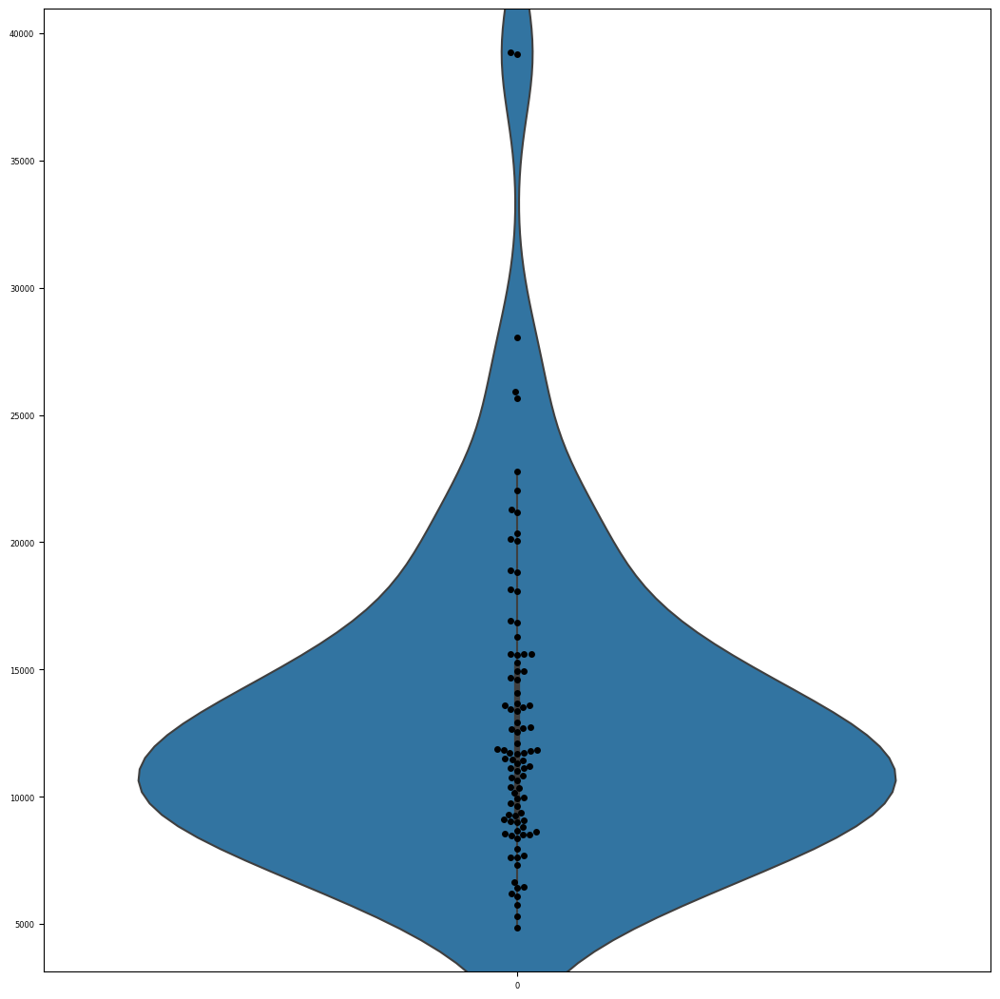

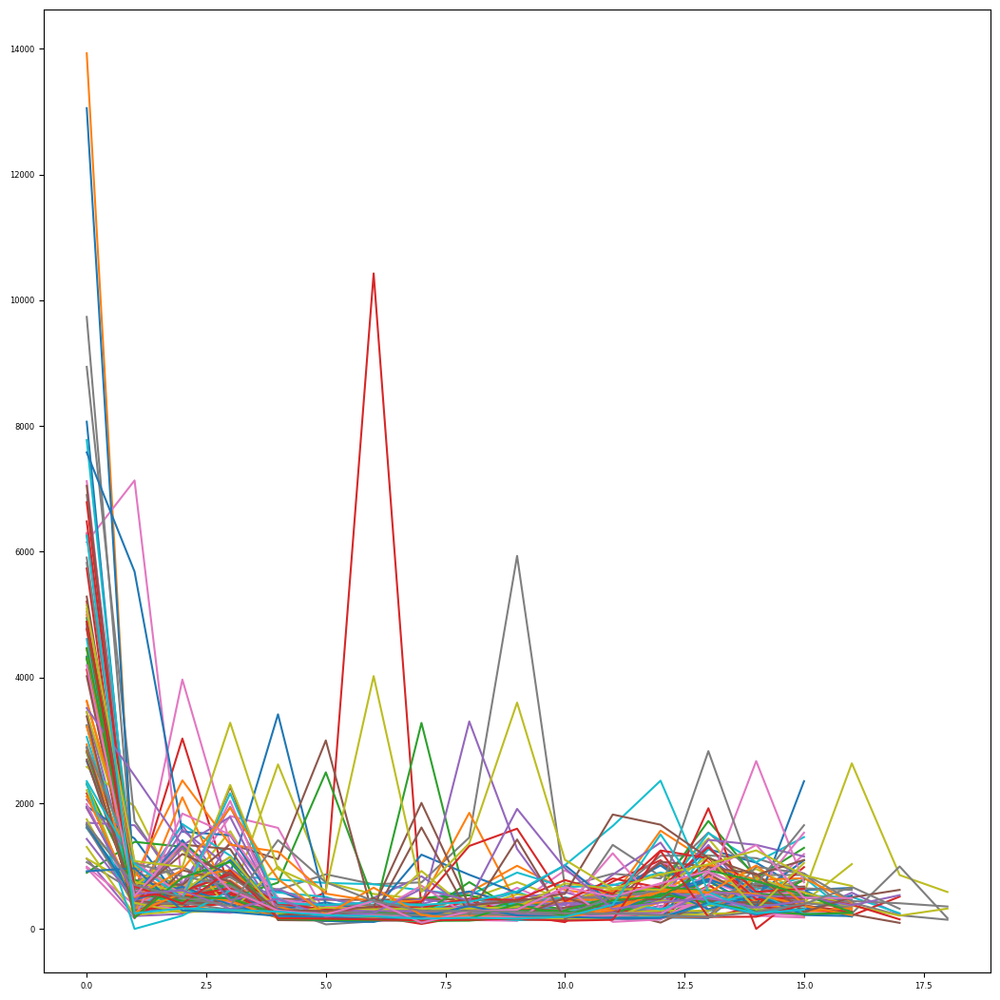

Number of outliers: 4

Optimal cost: 16
Ratio of optimal solutions: 58.95%
Average Number of Steps: 16.58888888888889
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30030
Number of reset: 15
Ratio of giveup: 2.11%


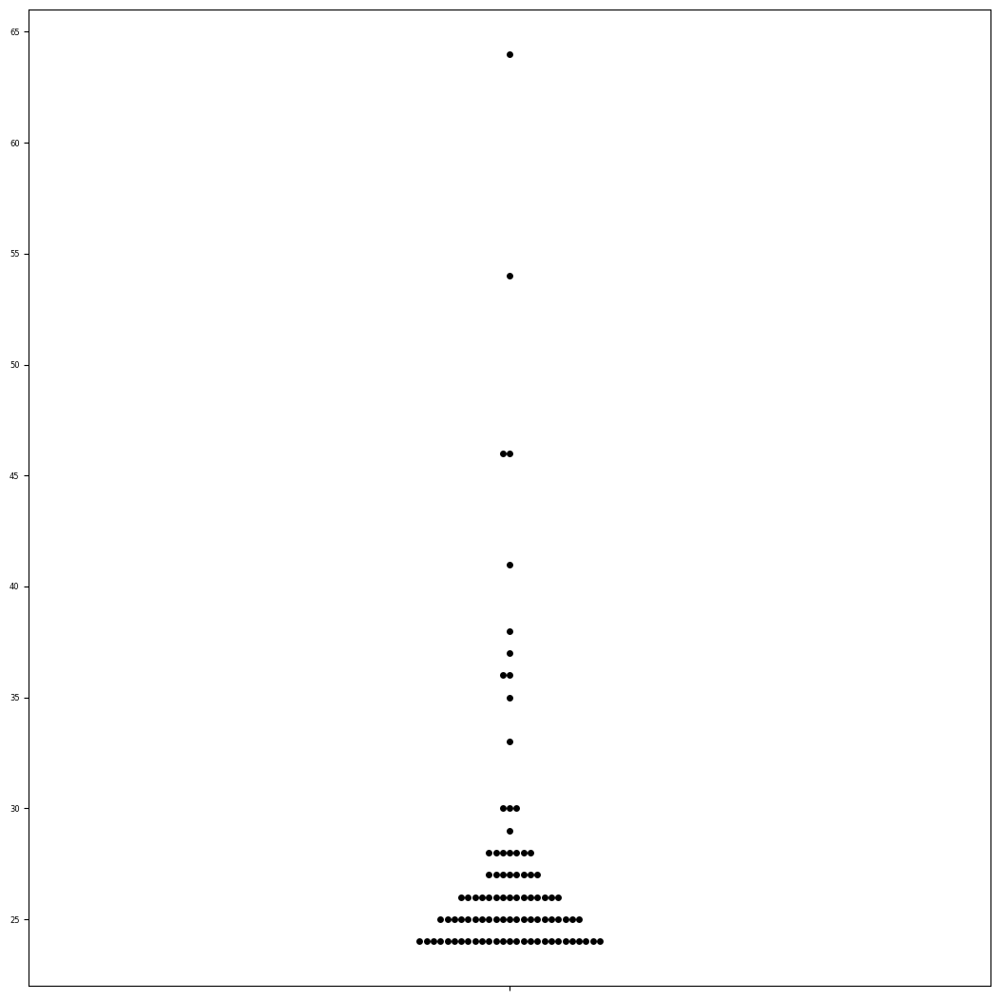

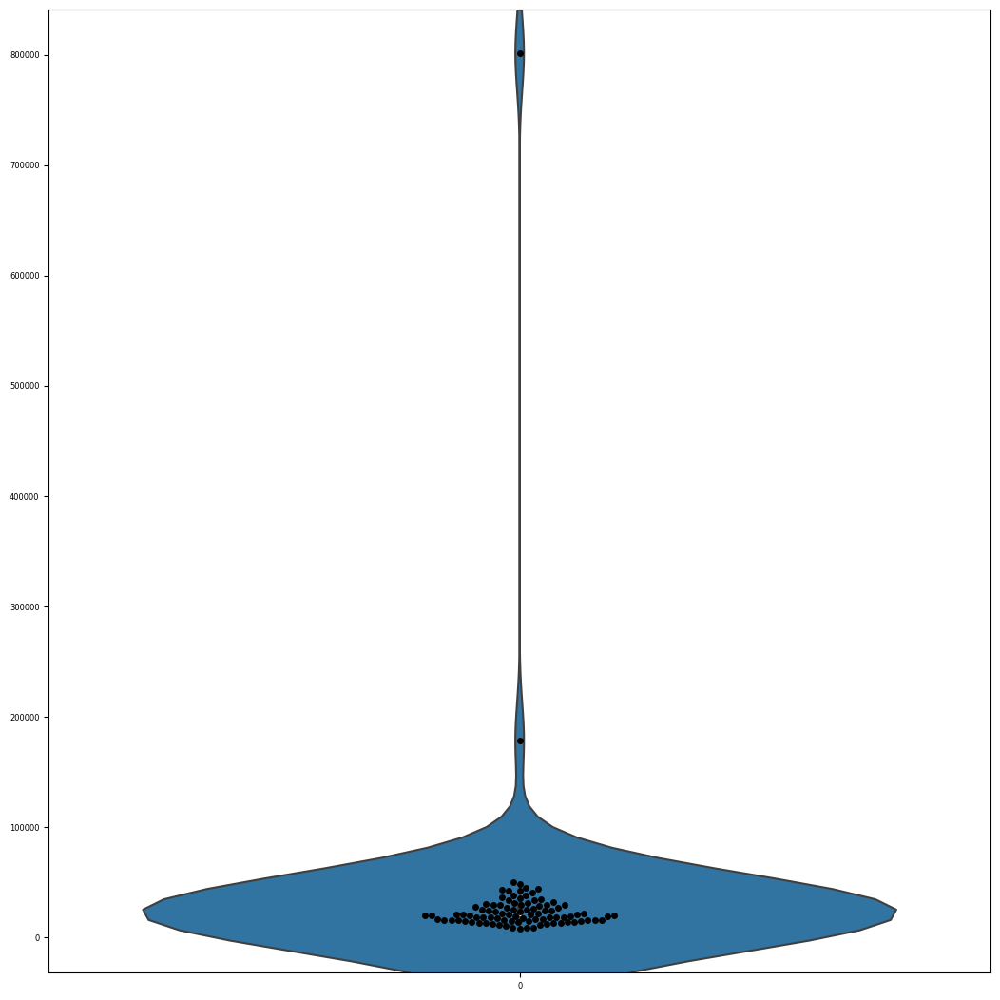

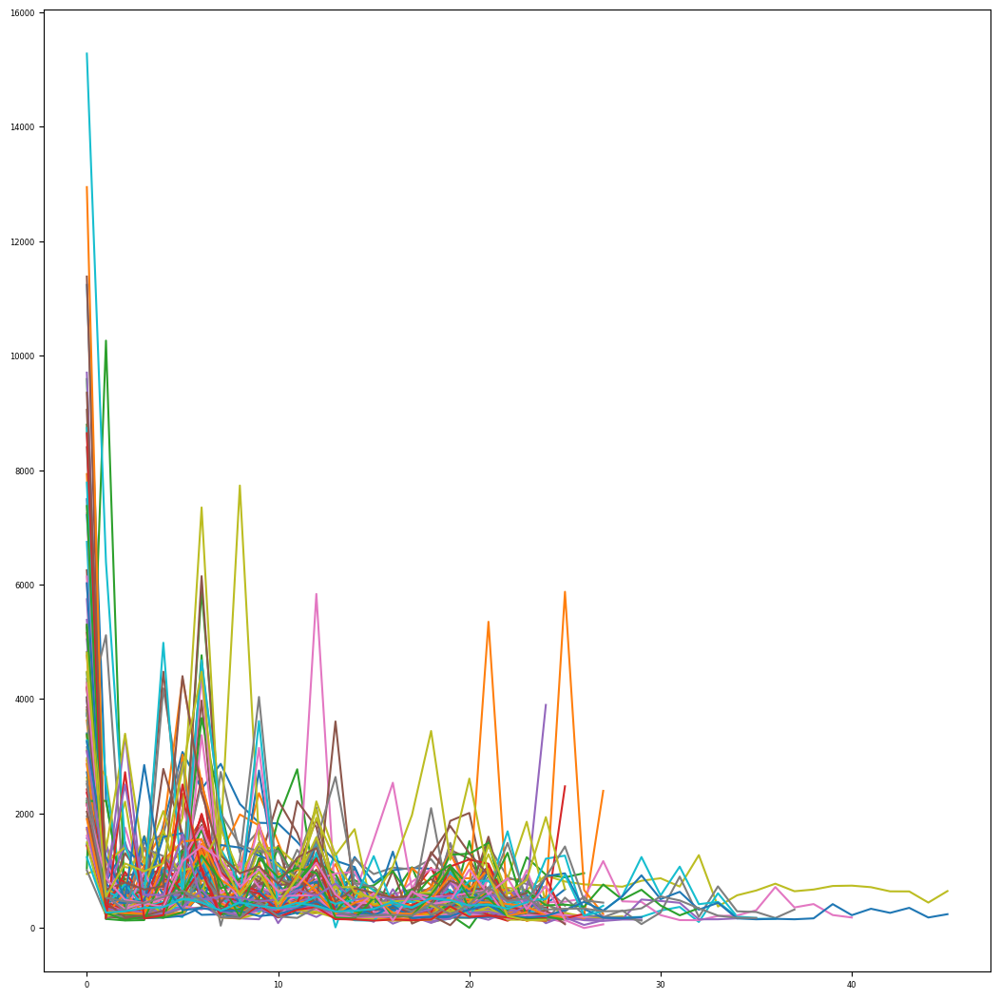

Number of outliers: 3

Optimal cost: 24
Ratio of optimal solutions: 28.42%
Average Number of Steps: 26.833333333333332
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30031
Number of reset: 18
Ratio of giveup: 3.16%


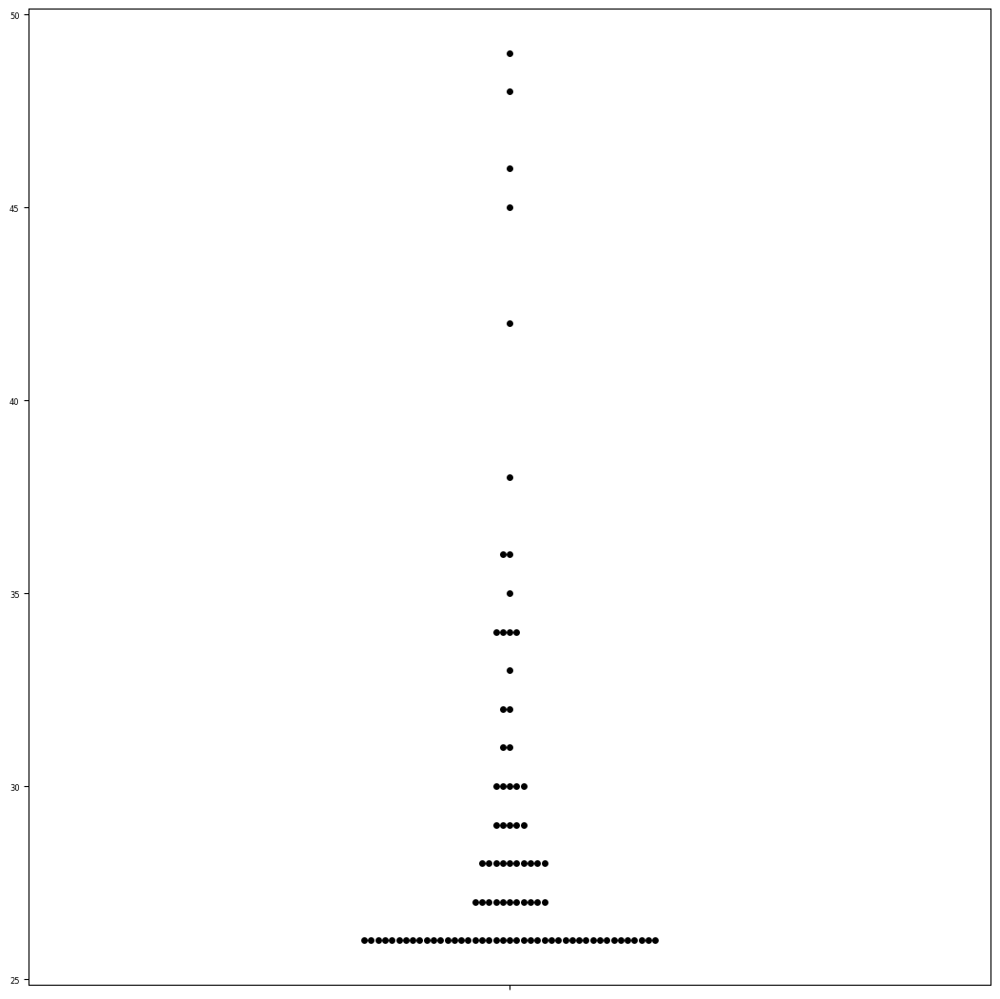

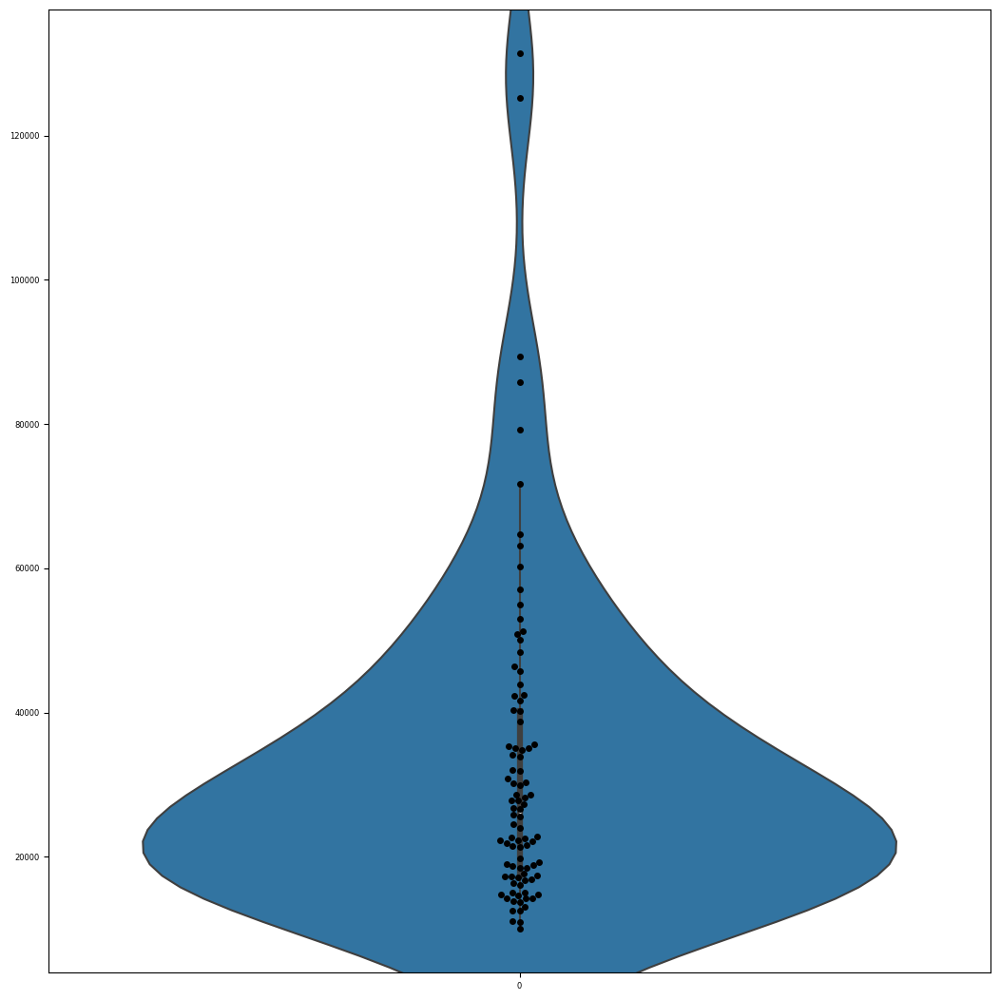

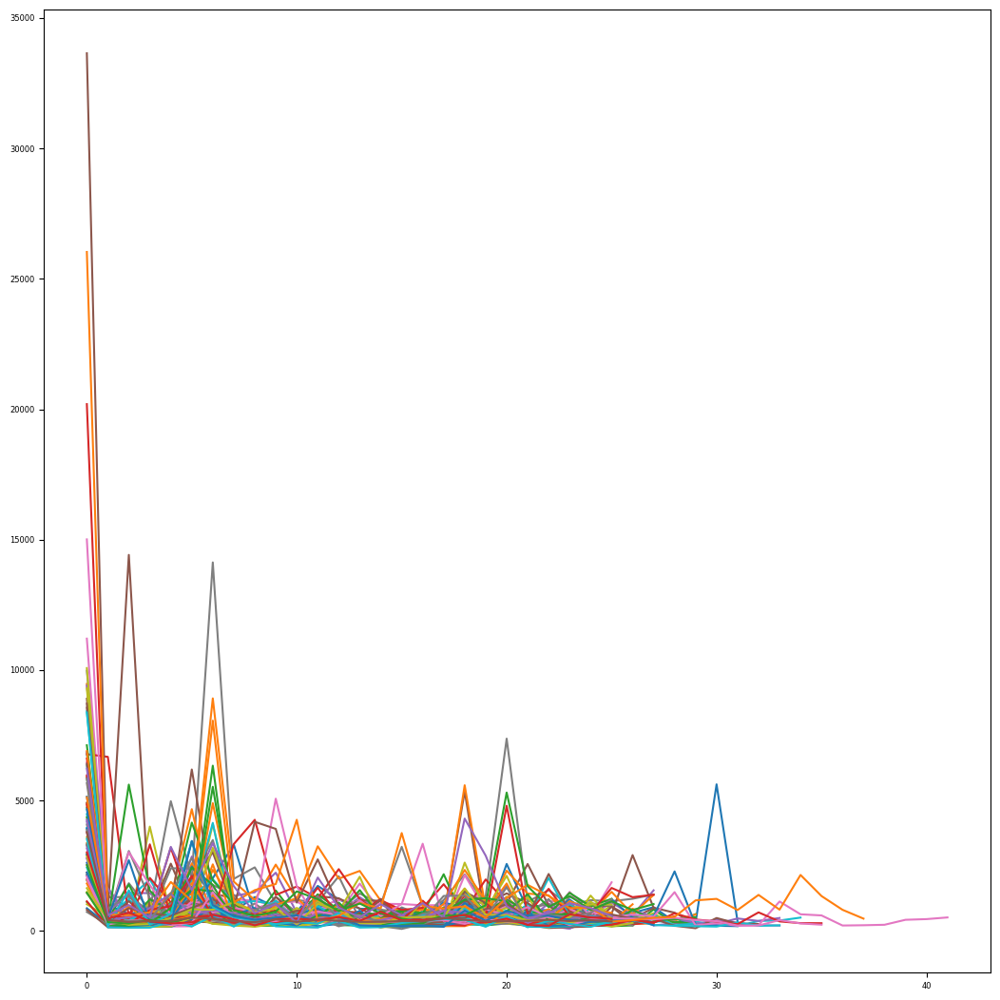

Number of outliers: 6

Optimal cost: 26
Ratio of optimal solutions: 45.26%
Average Number of Steps: 27.988372093023255
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30033
Number of reset: 13
Ratio of giveup: 11.58%


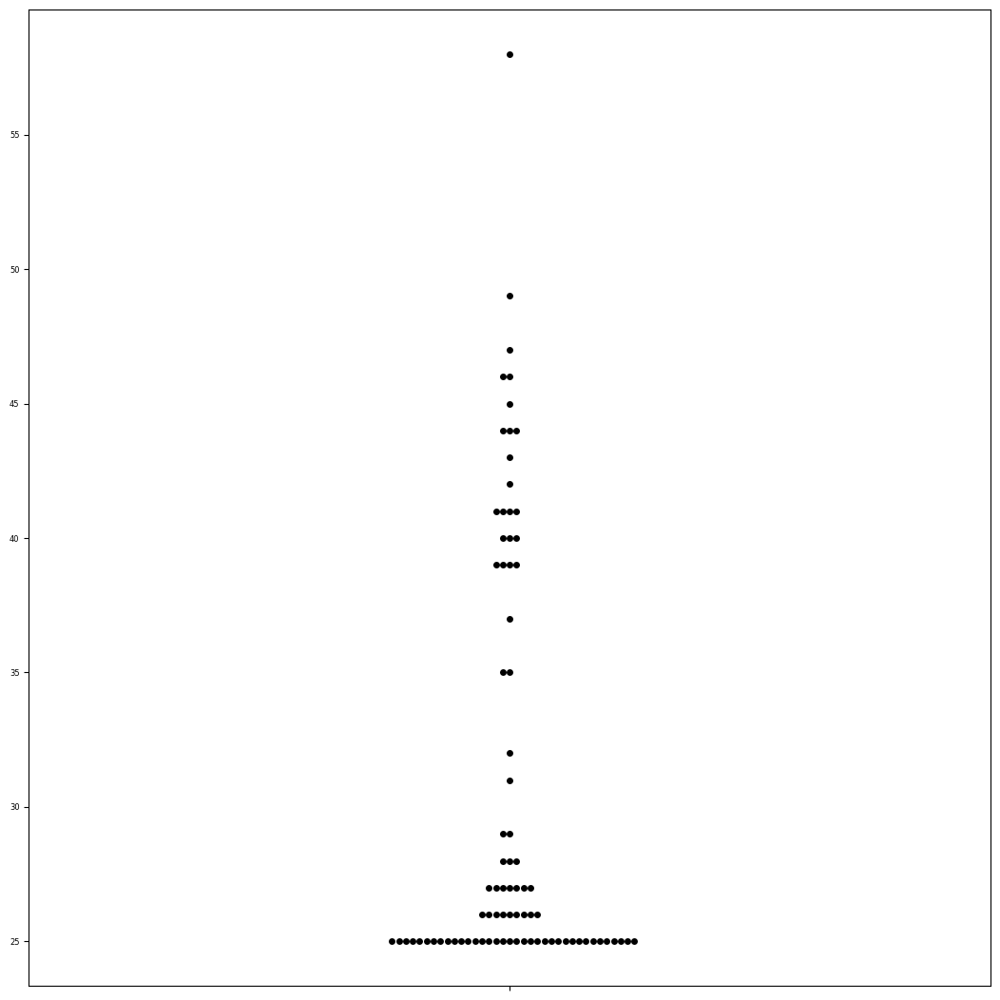

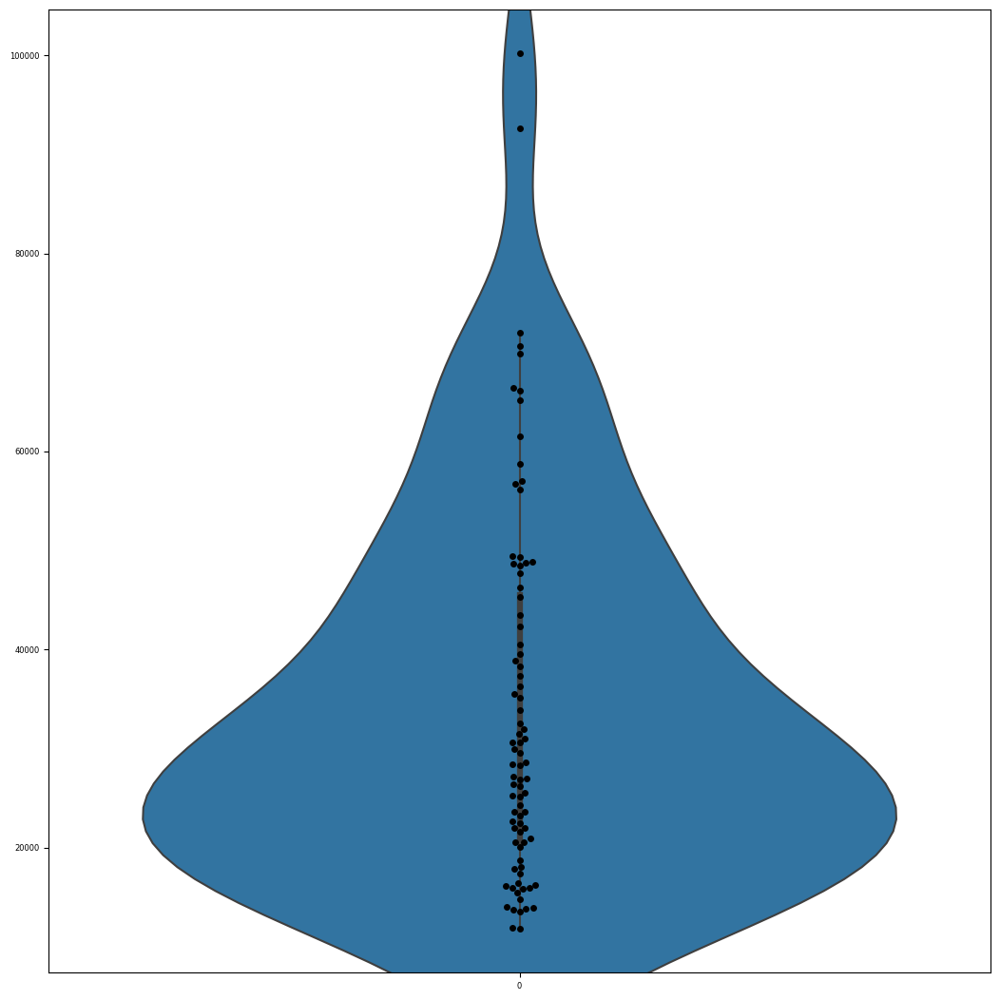

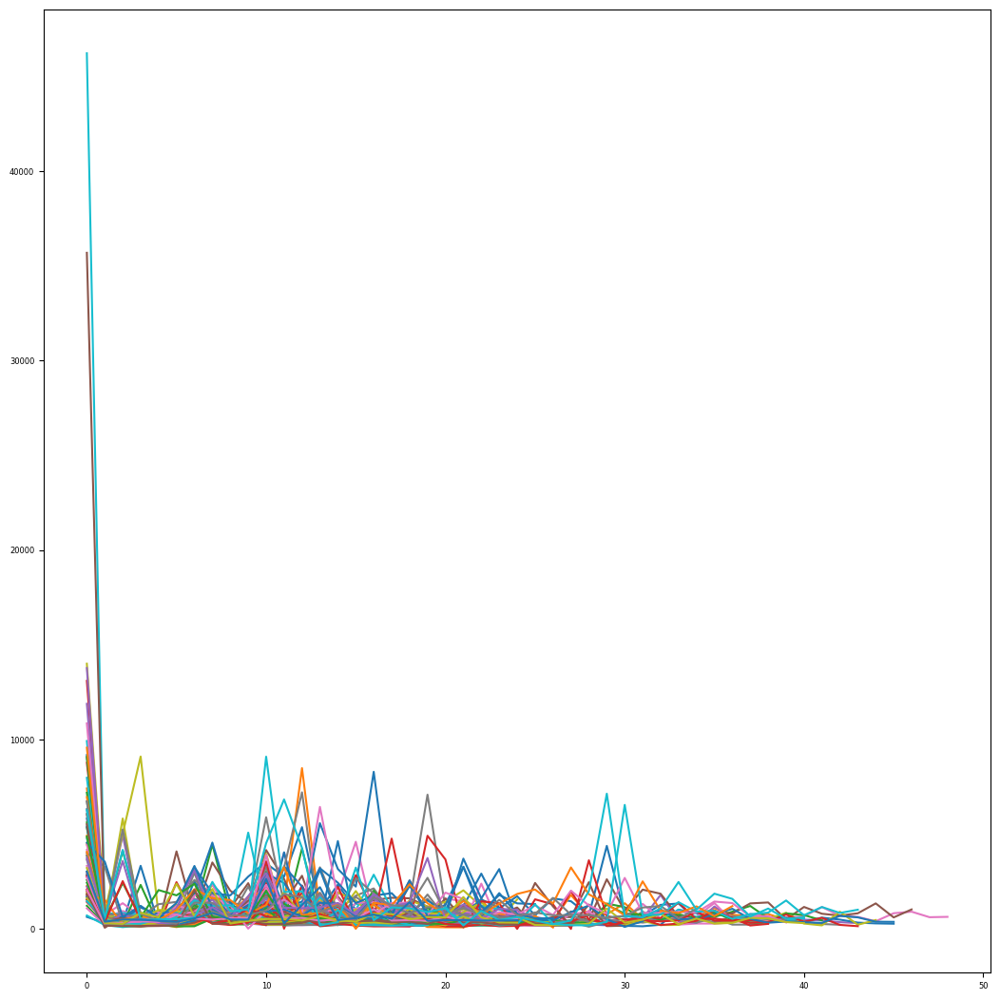

Number of outliers: 3

Optimal cost: 25
Ratio of optimal solutions: 37.89%
Average Number of Steps: 30.37037037037037
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------


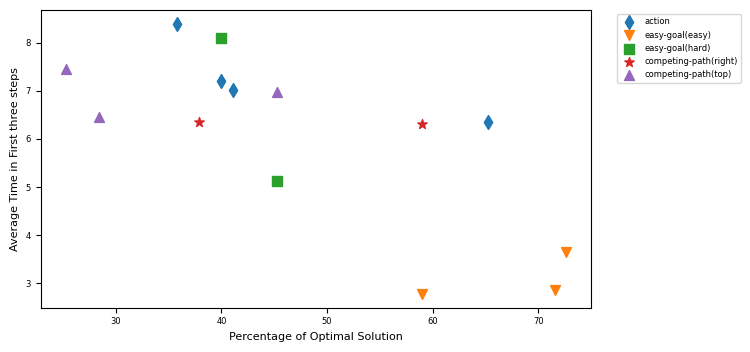

In [106]:
from seaborn import boxplot, swarmplot, violinplot
from scipy.stats import zscore
# select solvable instances
target_instances = []
for instance in ps_instances:
    m, s = ps_infos[instance]
    if s > 0:
        target_instances.append(instance)


print(target_instances)

optimal_ratios = []
planning_times = []
        
for instance in target_instances:
    reset_count = 0
    giveup_count = 0
    optimal_count = 0
    steps = []
    total_times = []
    all_rts = []
    key_steps = []
    for p_responses in ps_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == str(instance):
                this_count = 0
                rts = []
                giveup = False
                for i in range(len(i_response['responses'])):
                    rt, key = i_response['responses'][i]
                    if key == 'reset':
                        reset_count += 1
                        this_count = 0
                        rts = []
                    elif key == 'give_up':
                        giveup_count += 1
                        giveup = True
                        break
                    elif key != 'space':
                        rts.append(rt - i_response['responses'][i-1][0])
                        this_count += 1
                        
#                     if i>=3:
#                         if i_response['response'][i][1] in ['left', 'right']:
#                             key_steps.append[i]
                
                if not giveup:
                    steps.append(this_count)
                    total_times.append(i_response['responses'][-1][0]-i_response['responses'][0][0])
                    all_rts.append(rts)
   
                if this_count == ps_infos[instance][1]:
                    optimal_count += 1
                    
                
                
                    
    
    
    print(instance)
    print("Number of reset: " + str(reset_count))
    print("Ratio of giveup: " + str(round(giveup_count/95*100,2)) + "%")
    
    
    swarmplot(steps, color = 'black')
    plt.show()

    ax = violinplot(total_times)
    swarmplot(total_times, color = 'black')
    plt.show()
    
    z_time = zscore(total_times)
    z_step = zscore(steps)
    
    filter_steps = []
    outlier_count = 0
    sum_planning_time = 0
    for z_t, z_s, s, rts in zip(z_time, z_step, steps, all_rts):
        if -3<= z_t <= 3 and -3<=z_s<=3:
            plt.plot(rts)
            filter_steps.append(s)
            sum_planning_time += sum(rts[:4])
        else:
            outlier_count += 1
            
    plt.show()
    
    optimal_ratios.append(round(optimal_count/95*100,2))
    planning_times.append(sum_planning_time/(95-outlier_count))
    
    print("Number of outliers: " + str(outlier_count))
    print()
    print("Optimal cost: " + str(ps_infos[instance][1]))
    print("Ratio of optimal solutions: " + str(round(optimal_count/95*100,2)) + "%")
    print("Average Number of Steps: " + str(mean(filter_steps)))
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")
    
markers = ["d","d", "d", "d", "v","s","s","v","v","*", "^", "*","*","^"]

plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

plt.scatter(optimal_ratios[:4],[i/1000 for i in planning_times[:4]],label="action",marker="d",s=50)
    
easy = [4, 7,8]
hard = [5,6]
left = [10, 13]
top = [9,11,12]


plt.scatter([optimal_ratios[i] for i in easy], [planning_times[i]/1000 for i in easy],label="easy-goal(easy)", marker = "v",s=50)
    
plt.scatter([optimal_ratios[i] for i in hard], [planning_times[i]/1000 for i in hard],label="easy-goal(hard)", marker = "s",s=50)
plt.scatter([optimal_ratios[i] for i in left], [planning_times[i]/1000 for i in left],label="competing-path(right)", marker = "*",s=50) 
plt.scatter([optimal_ratios[i] for i in top], [planning_times[i]/1000 for i in top],label="competing-path(top)", marker = "^",s=50)
plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
plt.ylabel("Average Time in First three steps")
plt.xlabel("Percentage of Optimal Solution")
plt.show()

[30001, 30002, 30003, 30004, 30005, 30006, 30007, 30008]
Number of outliers: 2
3.9589333333333334
30001
78
78
(1, -1)
4334.961038961039



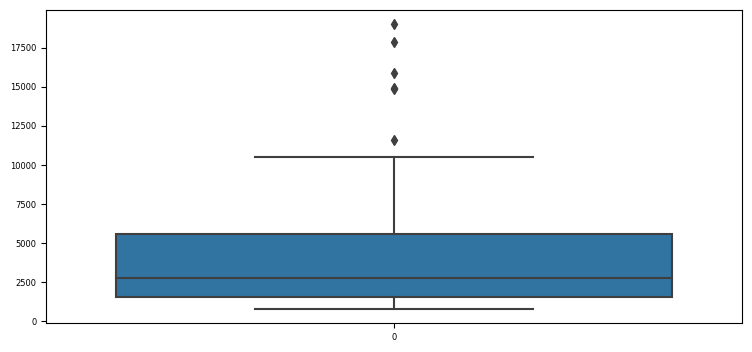

Number of outliers: 2
4.300521739130435
30002
94
93
(1, 15)
4620.904255319149



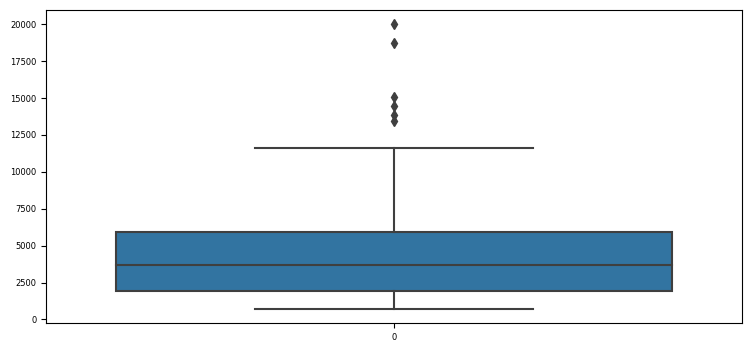

Number of outliers: 3
4.193043956043956
30003
95
85
(1, 17)
4531.776595744681



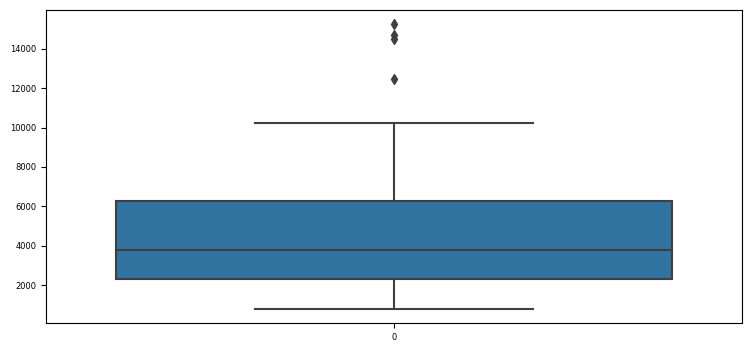

Number of outliers: 1
4.619822784810126
30004
77
76
(1, -1)
4830.875



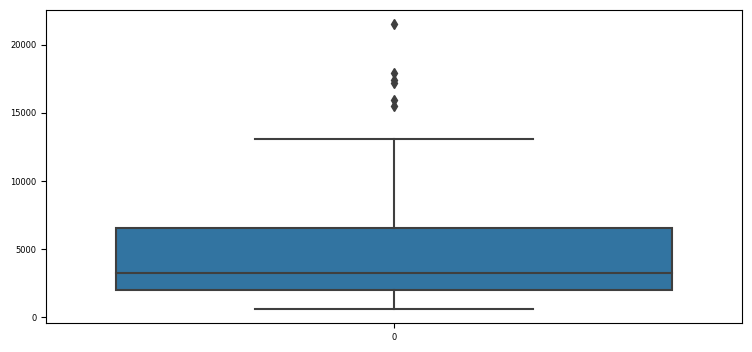

Number of outliers: 2
6.566788235294117
30005
88
71
(2, 21)
7278.494252873563



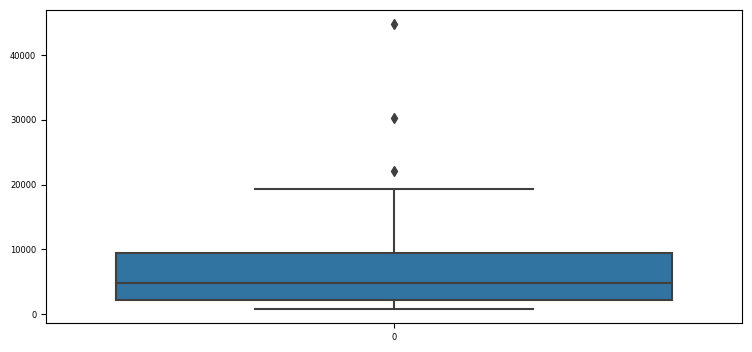

Number of outliers: 1
6.892635294117647
30006
84
70
(2, 21)
7753.2441860465115



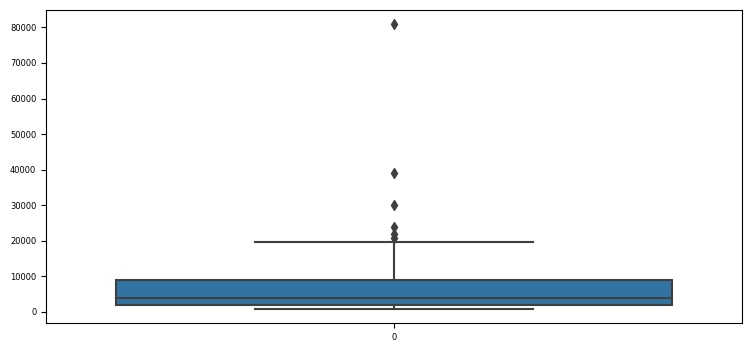

Number of outliers: 1
6.976906666666666
30007
74
57
(2, -1)
8192.144736842105



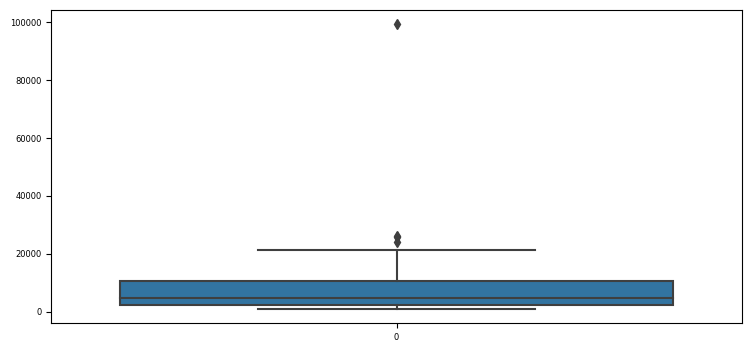

Number of outliers: 1
7.149581081081081
30008
76
58
(2, -1)
7749.4



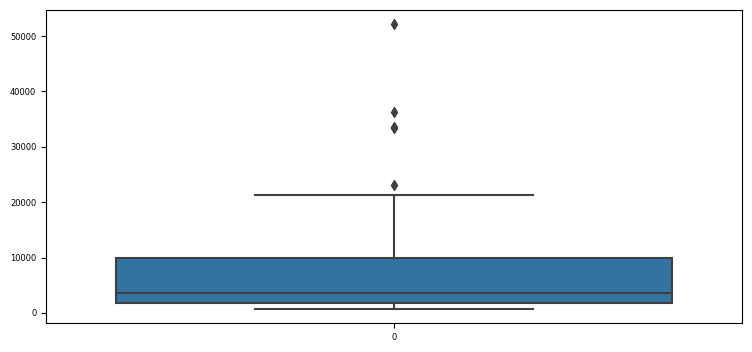

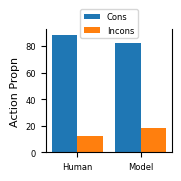

In [107]:
from seaborn import boxplot, swarmplot, violinplot
from scipy.stats import zscore
from statistics import mean
# select solvable instances

planning_times = {}

target_instances = []
for instance in ps_instances:
    m, s = ps_infos[instance]
    if s > 0:
        target_instances.append(instance)
        
action_instance_step_prob = {}
target_instances = [i for i in range(30001, 30009)]
expected_steps = ['right','right','left','left','right','left','right','left']

print(target_instances)

# target_instances = [30007, 30008]

# expected_steps = ['right','left']
for instance, key_step in zip(target_instances, expected_steps):
    reset_count = 0
    giveup_count = 0
    optimal_count = 0
    steps = []
    total_times = []
    all_rts = []
    key_steps_count = 0
    key_steps_all = 0
    
    for p_responses in ps_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == str(instance):
#                 print(i_response['responses'])
#                 input()
                this_count = 0
                rts = []
                giveup = False
                key_flag = False
                for i in range(len(i_response['responses'])):
                    rt, key = i_response['responses'][i]
                    if key == 'reset':
                        reset_count += 1
                        this_count = 0
                        rts = []
                    elif key == 'give_up':
                        giveup_count += 1
                        giveup = True
                        break
                    elif key != 'space':
                        rts.append(rt - i_response['responses'][i-1][0])
                        this_count += 1
                        
                    if i>=3 and not key_flag:
                        if i_response['responses'][i][1] in ['left', 'right']:
                            if i_response['responses'][i][1] == key_step:
                                key_steps_count += 1
#                             else:
#                                 print(i_response['responses'])

                            key_steps_all += 1

                            key_flag = True
                
                if not giveup:
                    steps.append(this_count)
                    all_rts.append(rts)
   
                if len(rts):
                    total_times.append(rts[0])
                if this_count == ps_infos[instance][1]:
                    optimal_count += 1
                    
    z_time = zscore(total_times)
#     z_step = zscore(steps)
    
#     filter_steps = []
    filter_times = []
    outlier_count = 0
    for z_t, rts in zip(z_time, total_times):
        if -3<= z_t <= 3:
            filter_times.append(rts/1000)
        else:
            outlier_count += 1
#     all_seq.append(filter_times)
    
    print("Number of outliers: " + str(outlier_count))
    print(mean(filter_times))   
    
    planning_times[instance] = mean(filter_times)
                
     
    
    
    print(instance)
    print(key_steps_all)
    print(key_steps_count)
    print(ps_infos[instance])
    print(mean(total_times))
    print()
    action_instance_step_prob[instance] = key_steps_count/key_steps_all
    ax = boxplot(total_times)
    plt.show()

    
SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [1.8, 1.8]
x_axis = np.arange(2)
plt.bar(x_axis-0.2, [88, 82], 0.4, label = "Cons")
plt.bar(x_axis+0.2, [12,18],0.4, label = "Incons")
# plt.bar(x_axis+0.2, [(70+71)/(79+77),(49+47)/(74+76)], 0.4, label = "Unsolvable")
plt.xticks(x_axis, ['Human', "Model"])

ax = plt.gca()
# plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
# ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=sum(a_results)))
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2))
plt.ylabel("Action Propn")
ax.spines[['top']].set_visible(False)
# plt.tight_layout()
plt.savefig("fig1.pdf", format='pdf', dpi=1200)
#     print("Number of reset: " + str(reset_count))
#     print("Ratio of giveup: " + str(round(giveup_count/95*100,2)) + "%")
    
    
#     swarmplot(steps, color = 'black')
#     plt.show()

#     ax = violinplot(total_times)
#     swarmplot(total_times, color = 'black')
#     plt.show()
    
#     z_time = zscore(total_times)
#     z_step = zscore(steps)
    
#     filter_steps = []
#     outlier_count = 0
#     for z_t, z_s, s, rts in zip(z_time, z_step, steps, all_rts):
#         if -3<= z_t <= 3 and -3<=z_s<=3:
#             plt.plot(rts)
#             filter_steps.append(s)
#         else:
#             outlier_count += 1
            
#     plt.show()
    
    
#     print("Number of outliers: " + str(outlier_count))
#     print()
#     print("Optimal cost: " + str(ps_infos[instance][1]))
#     print("Ratio of optimal solutions: " + str(round(optimal_count/95*100,2)) + "%")
#     print("Average Number of Steps: " + str(mean(filter_steps)))
#     print("-----------------------------------------------------------------------------------")
#     print("-----------------------------------------------------------------------------------")
#     print("-----------------------------------------------------------------------------------")
    
# markers = ["d","d", "d", "d", "v","s","s","v","v","*", "^", "*","*","^"]

# plt.rcParams["figure.figsize"] = [1, 3.50]
# plt.rcParams["figure.autolayout"] = True

# plt.scatter(optimal_ratios[:4],planning_times[:4],label="action",marker="d",s=50)
    
# easy = [4, 7,8]
# hard = [5,6]
# left = [10, 13]
# top = [9,11,12]


# plt.scatter([optimal_ratios[i] for i in easy], [planning_times[i] for i in easy],label="easy-goal(easy)", marker = "v",s=50)
    
# plt.scatter([optimal_ratios[i] for i in hard], [planning_times[i] for i in hard],label="easy-goal(hard)", marker = "s",s=50)
# plt.scatter([optimal_ratios[i] for i in left], [planning_times[i] for i in left],label="competing-path(right)", marker = "*",s=50) 
# plt.scatter([optimal_ratios[i] for i in top], [planning_times[i] for i in top],label="competing-path(top)", marker = "^",s=50)
# plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
# plt.ylabel("Average Time in First three steps")
# plt.xlabel("Percentage of Optimal Solution")
# plt.show()

[30009, 30010, 30011, 30012, 30013, 30014, 30015]
30009
(3, -1)

Number of outliers: 1
7.2680983606557374
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30010
(3, 5)

Number of outliers: 1
3.31289247311828
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30011
(3, 13)

Number of outliers: 3
5.704217391304348
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30012
(4, 17)

Number of outli

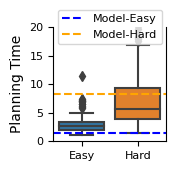

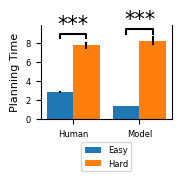

In [108]:
from seaborn import boxplot, swarmplot, violinplot
from scipy.stats import zscore,sem
from statistics import mean
# select solvable instances
target_instances = []
for instance in ps_instances:
    m, s = ps_infos[instance]
    if s > 0:
        target_instances.append(instance)

target_instances = [i for i in range(30009, 30016)]
easy_instances = [1,4,6]
# expected_steps = ['right','right','left','left','right','left','right','left']

print(target_instances)

# target_instances = [30007, 30008]

# expected_steps = ['right','left']
all_seq = []
easy_times = {}
easy_actions = {}
for instance in target_instances:
    steps = []
    total_times = []
    all_rts = []

    key_actions = []
    for p_responses in ps_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == str(instance):
#                 print(i_response['responses'])
#                 input()
#                 this_count = 0
                rts = []
#                 giveup = False
#                 key_flag = False
                actions = []
                for i in range(len(i_response['responses'])):
                    rt, key = i_response['responses'][i]
                    if key == 'reset':
                        reset_count += 1
                        this_count = 0
                        rts = []
                        actions = []
                    elif key == 'give_up':
                        giveup_count += 1
                        giveup = True
                        break
                    elif key != 'space':
                        rts.append(rt - i_response['responses'][i-1][0])
                        actions.append(key)
                        this_count += 1
                        
#                     if i>=3 and not key_flag:
#                         if i_response['responses'][i][1] in ['left', 'right']:
#                             if i_response['responses'][i][1] == key_step:
#                                 key_steps_count += 1
#                         key_steps_all += 1
#                         key_flag = True
                
                if len(rts) > 3:
                    total_times.append(sum(rts[:3]))
                    key_actions.append(actions[3])
#                 if len(rts):
#                     total_times.append(rts[0])
#                 if not giveup:
#                     steps.append(this_count)
#                     total_times.append(i_response['responses'][-1][0])
#                     all_rts.append(rts)
   
#                 if this_count == ps_infos[instance][1]:
#                     optimal_count += 1
                    
                
                
     
    
    
    print(instance)
#     print(key_steps_all)
#     print(key_steps_count)
    print(ps_infos[instance])
    print()

# x_axis = np.arange(2)
# plt.bar(x_axis-0.2, [(79+74)/(94+95),(58+59)/(84+88)], 0.4, label = "Solvable")
# plt.bar(x_axis+0.2, [(70+71)/(79+77),(49+47)/(74+76)], 0.4, label = "Unsolvable")
# plt.xticks(x_axis, ['Action Map 1', "Action Map 2"])

# ax = plt.gca()
# # plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
# ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=sum(a_results)))
# plt.legend()
# plt.tight_layout()
# plt.show()
#     print("Number of reset: " + str(reset_count))
#     print("Ratio of giveup: " + str(round(giveup_count/95*100,2)) + "%")
    
    
#     swarmplot(steps, color = 'black')
#     plt.show()

#     ax = violinplot(total_times)
#     swarmplot(total_times, color = 'black')
#     plt.show()
    
    z_time = zscore(total_times)
#     z_step = zscore(steps)
    
#     filter_steps = []
    filter_times = []
    outlier_count = 0
    for z_t, rts in zip(z_time, total_times):
        if -3<= z_t <= 3:
            filter_times.append(rts/1000)
        else:
            outlier_count += 1
    all_seq.append(filter_times)
    easy_times[instance] = filter_times
    easy_actions[instance] = key_actions
    
    print("Number of outliers: " + str(outlier_count))
    print(mean(filter_times))
    planning_times[instance] = mean(filter_times)
    
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")

easy_time = all_seq[1] + all_seq[4] + all_seq[6]
hard_time = all_seq[0] + all_seq[2] + all_seq[3] + all_seq[5]

from collections import Counter
filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    
easy_m_times = []
hard_m_times = []
easy_instances = ['30009', '30010', '30011', '30012', '30013', '30014', '30015']
easy = [30010, 30013, 30015]
for instance in easy_instances:
    ts = action_datas[instance]['key_times']
    if int(instance) in easy:
        easy_m_times += ts
    else:
        hard_m_times += ts
        

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [1.8, 1.8]    
factor = ((sum(easy_time) + sum(hard_time))*700) / ((sum(easy_m_times) + sum(hard_m_times))*562)

print(mean([i * factor for i in easy_m_times]))
print(mean([i*factor for i in hard_m_times]))
print(sem([i * factor for i in easy_m_times]))
print(sem([i*factor for i in hard_m_times]))
print(len(easy_m_times))
print(len(hard_m_times))
print(len(easy_time))
print(len(hard_time))
print(sem(easy_time))
print(sem(hard_time))

ax = boxplot([easy_time, hard_time])
print(mean(easy_time), mean(hard_time))
#     swarmplot(filter_times, color = 'black')
ax.set_xticklabels(['Easy', 'Hard'])
plt.axhline(y = mean([i * factor for i in easy_m_times]), color = 'b', linestyle = '--', label = "Model-Easy")
plt.axhline(y = mean([i * factor for i in hard_m_times]), color = 'orange', linestyle = '--', label = "Model-Hard")
plt.ylabel("Planning Time")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2))
plt.ylim(0,20)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2))
ax.spines[['top']].set_visible(False)
# plt.tight_layout()
# plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
plt.show()

time_factor = factor  
    
def barplot_annotate_brackets(num1, data, center, height1, height2, width, yerr=None, dh=.08, barh=.05, fs=15, maxasterix=None):
    """ 
    Annotate barplot with p-values.

    :param num1: number of left bar to put bracket over
    :param num2: number of right bar to put bracket over
    :param data: string to write or number for generating asterixes
    :param center: centers of all bars (like plt.bar() input)
    :param height: heights of all bars (like plt.bar() input)
    :param yerr: yerrs of all bars (like plt.bar() input)
    :param dh: height offset over bar / bar + yerr in axes coordinates (0 to 1)
    :param barh: bar height in axes coordinates (0 to 1)
    :param fs: font size
    :param maxasterix: maximum number of asterixes to write (for very small p-values)
    """

    if type(data) is str:
        text = data
    else:
        # * is p < 0.05
        # ** is p < 0.005
        # *** is p < 0.0005
        # etc.
        text = ''
        p = .05

        while data < p:
            text += '*'
            p /= 10.

            if maxasterix and len(text) == maxasterix:
                break

        if len(text) == 0:
            return
            text = 'n. s.'

    lx, ly = center[num1], height1[num1]
    rx, ry = center[num1] + width, height2[num1]

    if yerr:
        ly += yerr[num1]
        ry += yerr[num2]

    ax_y0, ax_y1 = plt.gca().get_ylim()
    dh *= (ax_y1 - ax_y0)
    barh *= (ax_y1 - ax_y0)

    y = max(ly, ry) + dh

    barx = [lx, lx, rx, rx]
    bary = [y, y+barh, y+barh, y]
    mid = ((lx+rx)/2, y+barh)

    plt.plot(barx, bary, c='black')

    kwargs = dict(ha='center', va='bottom')
    if fs is not None:
        kwargs['fontsize'] = fs

    plt.text(*mid, text, **kwargs)
    
SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [1.8, 1.8]
x_axis = np.arange(2)
plt.bar(x_axis-0.2, [2.84, 1.41], 0.4,yerr=[0.08, 0.02], label = "Easy")
plt.bar(x_axis+0.2, [7.75,8.24],0.4,yerr=[0.38,0.45], label = "Hard")

barplot_annotate_brackets(0,0.0001,x_axis-0.2, [2.84, 1.41], [7.75,8.24], 0.4)
barplot_annotate_brackets(1,0.0001,x_axis-0.2,[2.84, 1.41], [7.75,8.24], 0.4)
# plt.bar(x_axis+0.2, [(70+71)/(79+77),(49+47)/(74+76)], 0.4, label = "Unsolvable")
plt.xticks(x_axis, ['Human', "Model"])

ax = plt.gca()
# plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
# ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=sum(a_results)))
plt.ylabel("Planning Time")
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2))
ax.spines[['top']].set_visible(False)
# plt.tight_layout()
plt.savefig('fig3.pdf', format='pdf', dpi=1200)
plt.show()
#     print("Number of outliers: " + str(outlier_count))
#     print()
#     print("Optimal cost: " + str(ps_infos[instance][1]))
#     print("Ratio of optimal solutions: " + str(round(optimal_count/95*100,2)) + "%")
#     print("Average Number of Steps: " + str(mean(filter_steps)))
#     print("-----------------------------------------------------------------------------------")
#     print("-----------------------------------------------------------------------------------")
#     print("-----------------------------------------------------------------------------------")
    
# markers = ["d","d", "d", "d", "v","s","s","v","v","*", "^", "*","*","^"]

# plt.rcParams["figure.figsize"] = [7.50, 3.50]
# plt.rcParams["figure.autolayout"] = True

# plt.scatter(optimal_ratios[:4],planning_times[:4],label="action",marker="d",s=50)
    
# easy = [4, 7,8]
# hard = [5,6]
# left = [10, 13]
# top = [9,11,12]


# plt.scatter([optimal_ratios[i] for i in easy], [planning_times[i] for i in easy],label="easy-goal(easy)", marker = "v",s=50)
    
# plt.scatter([optimal_ratios[i] for i in hard], [planning_times[i] for i in hard],label="easy-goal(hard)", marker = "s",s=50)
# plt.scatter([optimal_ratios[i] for i in left], [planning_times[i] for i in left],label="competing-path(right)", marker = "*",s=50) 
# plt.scatter([optimal_ratios[i] for i in top], [planning_times[i] for i in top],label="competing-path(top)", marker = "^",s=50)
# plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
# plt.ylabel("Average Time in First three steps")
# plt.xlabel("Percentage of Optimal Solution")
# plt.show()

[30026, 30027, 30028, 30029, 30030, 30031, 30032, 30033]
30026
(5, -1)

Number of outliers: 2
9.181938461538461
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30027
(5, 16)

Number of outliers: 1
6.209741935483871
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30028
(5, -1)

Number of outliers: 2
6.303441176470588
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
-----------------------------------------------------------------------------------
30029
(5, 16)

Number 

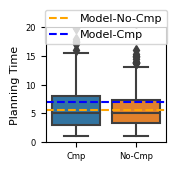

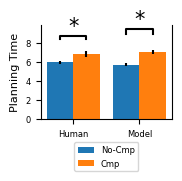

In [109]:
from seaborn import boxplot, swarmplot, violinplot
from scipy.stats import zscore
from scipy.stats import ttest_ind
# select solvable instances
target_instances = []
for instance in ps_instances:
    m, s = ps_infos[instance]
    if s > 0:
        target_instances.append(instance)

target_instances = [i for i in range(30026, 30034)]
# expected_steps = ['right','right','left','left','right','left','right','left']

print(target_instances)

# target_instances = [30007, 30008]

# expected_steps = ['right','left']
cmp_times = {}
cmp_actions = {}
all_seq = []
for instance in target_instances:
    steps = []
    total_times = []
    all_rts = []

    key_actions = []
    for p_responses in ps_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == str(instance):
#                 print(i_response['responses'])
#                 input()
#                 this_count = 0
                rts = []
#                 giveup = False
#                 key_flag = False
                actions = []
                for i in range(len(i_response['responses'])):
                    rt, key = i_response['responses'][i]
                    if key == 'reset':
                        reset_count += 1
                        this_count = 0
                        rts = []
                        actions = []
                    elif key == 'give_up':
                        giveup_count += 1
                        giveup = True
                        break
                    elif key != 'space':
                        rts.append(rt - i_response['responses'][i-1][0])
                        actions.append(key)
                        this_count += 1
                        
#                     if i>=3 and not key_flag:
#                         if i_response['responses'][i][1] in ['left', 'right']:
#                             if i_response['responses'][i][1] == key_step:
#                                 key_steps_count += 1
#                         key_steps_all += 1
#                         key_flag = True
                
                if len(rts) > 3:
                    total_times.append(sum(rts[:3]))
                    key_actions.append(actions[3])
#                 if len(rts):
#                     total_times.append(rts[0])
#                 if not giveup:
#                     steps.append(this_count)
#                     total_times.append(i_response['responses'][-1][0])
#                     all_rts.append(rts)
   
#                 if this_count == ps_infos[instance][1]:
#                     optimal_count += 1
                    
                
                
     
    
    
    print(instance)
#     print(key_steps_all)
#     print(key_steps_count)
    print(ps_infos[instance])
    print()

# x_axis = np.arange(2)
# plt.bar(x_axis-0.2, [(79+74)/(94+95),(58+59)/(84+88)], 0.4, label = "Solvable")
# plt.bar(x_axis+0.2, [(70+71)/(79+77),(49+47)/(74+76)], 0.4, label = "Unsolvable")
# plt.xticks(x_axis, ['Action Map 1', "Action Map 2"])

# ax = plt.gca()
# # plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
# ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=sum(a_results)))
# plt.legend()
# plt.tight_layout()
# plt.show()
#     print("Number of reset: " + str(reset_count))
#     print("Ratio of giveup: " + str(round(giveup_count/95*100,2)) + "%")
    
    
#     swarmplot(steps, color = 'black')
#     plt.show()

#     ax = violinplot(total_times)
#     swarmplot(total_times, color = 'black')
#     plt.show()
    
    z_time = zscore(total_times)
#     z_step = zscore(steps)
    
#     filter_steps = []
    filter_times = []
    outlier_count = 0
    for z_t, rts in zip(z_time, total_times):
        if -3<= z_t <= 3:
            filter_times.append(rts/1000)
        else:
            outlier_count += 1
    all_seq.append(filter_times)
    cmp_times[instance] = filter_times
    cmp_actions[instance] = key_actions
    
    print("Number of outliers: " + str(outlier_count))
    print(mean(filter_times))
    planning_times[instance] = mean(filter_times)
    
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")
    print("-----------------------------------------------------------------------------------")

cmp_time = all_seq[0] + all_seq[1] + all_seq[6] + all_seq[7]
no_cmp_time = all_seq[2] + all_seq[3] + all_seq[4] + all_seq[5]


easy_m_times = []
hard_m_times = []
easy_instances = ['30026', '30027', '30028', '30029', '30030', '30031', '30032','30033']
easy = [30028,30029,30030,30031]
for instance in easy_instances:
    ts = action_datas[instance]['key_times']
    if int(instance) in easy:
        easy_m_times += ts
    else:
        hard_m_times += ts

factor = ((sum(cmp_time) + sum(no_cmp_time))*800) / ((sum(easy_m_times) + sum(hard_m_times))*661)
# plt.rcParams["figure.figsize"] = [4.5, 4.5]  
ax = boxplot([cmp_time, no_cmp_time])
print(len(easy_m_times))
print(mean(cmp_time),mean(no_cmp_time))
print(sem(cmp_time),sem(no_cmp_time))
print(ttest_ind(cmp_time, no_cmp_time))
print(mean([i * factor for i in easy_m_times]))
print(mean([i * factor for i in hard_m_times]))
print(sem([i * factor for i in easy_m_times]))
print(sem([i * factor for i in hard_m_times]))
print(len(hard_m_times))
#     swarmplot(filter_times, color = 'black')
print(len(cmp_time))
print(len(no_cmp_time))
plt.axhline(y = mean([i * factor for i in easy_m_times]), color = 'orange', linestyle = '--', label = "Model-No-Cmp")
plt.axhline(y = mean([i * factor for i in hard_m_times]), color = 'b', linestyle = '--', label = "Model-Cmp")

#     swarmplot(filter_times, color = 'black')

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [1.8, 1.8] 
# plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')

ax.set_xticklabels(['Cmp', 'No-Cmp'])
plt.ylabel("Planning Time")
plt.ylim(0,20)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2))

plt.show()

cmp_factor = factor   

SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams["figure.figsize"] = [1.8, 1.8]
x_axis = np.arange(2)
plt.bar(x_axis-0.2, [5.94, 5.68], 0.4,yerr=[0.20, 0.15], label = "No-Cmp")
plt.bar(x_axis+0.2, [6.83,7.04],0.4,yerr=[0.34,0.18], label = "Cmp")

barplot_annotate_brackets(0,0.01,x_axis-0.2, [2.84, 1.41], [7.75,8.24], 0.4)
barplot_annotate_brackets(1,0.01,x_axis-0.2,[2.84, 1.41], [7.75,8.24], 0.4)
# plt.bar(x_axis+0.2, [(70+71)/(79+77),(49+47)/(74+76)], 0.4, label = "Unsolvable")
plt.xticks(x_axis, ['Human', "Model"])

ax = plt.gca()
# plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right')
# ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=sum(a_results)))
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2))
plt.ylabel("Planning Time")
ax.spines[['top']].set_visible(False)

# plt.tight_layout()
plt.savefig('fig4.pdf', format='pdf', dpi=1200)
plt.show()
    
#     print("Number of outliers: " + str(outlier_count))
#     print()
#     print("Optimal cost: " + str(ps_infos[instance][1]))
#     print("Ratio of optimal solutions: " + str(round(optimal_count/95*100,2)) + "%")
#     print("Average Number of Steps: " + str(mean(filter_steps)))
#     print("-----------------------------------------------------------------------------------")
#     print("-----------------------------------------------------------------------------------")
#     print("-----------------------------------------------------------------------------------")
    
# markers = ["d","d", "d", "d", "v","s","s","v","v","*", "^", "*","*","^"]

# plt.rcParams["figure.figsize"] = [7.50, 3.50]
# plt.rcParams["figure.autolayout"] = True

# plt.scatter(optimal_ratios[:4],planning_times[:4],label="action",marker="d",s=50)
    
# easy = [4, 7,8]
# hard = [5,6]
# left = [10, 13]
# top = [9,11,12]


# plt.scatter([optimal_ratios[i] for i in easy], [planning_times[i] for i in easy],label="easy-goal(easy)", marker = "v",s=50)
    
# plt.scatter([optimal_ratios[i] for i in hard], [planning_times[i] for i in hard],label="easy-goal(hard)", marker = "s",s=50)
# plt.scatter([optimal_ratios[i] for i in left], [planning_times[i] for i in left],label="competing-path(right)", marker = "*",s=50) 
# plt.scatter([optimal_ratios[i] for i in top], [planning_times[i] for i in top],label="competing-path(top)", marker = "^",s=50)
# plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")
# plt.ylabel("Average Time in First three steps")
# plt.xlabel("Percentage of Optimal Solution")
# plt.show()

## Discussion

The rate of giving up is surprisingly high. However, among the participants who successfully solve the puzzle, some of them take far more steps than the optimal solution.

In [110]:
print(planning_times)

{30001: 3.9589333333333334, 30002: 4.300521739130435, 30003: 4.193043956043956, 30004: 4.619822784810126, 30005: 6.566788235294117, 30006: 6.892635294117647, 30007: 6.976906666666666, 30008: 7.149581081081081, 30009: 7.2680983606557374, 30010: 3.31289247311828, 30011: 5.704217391304348, 30012: 7.23483908045977, 30013: 2.665691489361702, 30014: 10.992833333333333, 30015: 2.545076086956522, 30026: 9.181938461538461, 30027: 6.209741935483871, 30028: 6.303441176470588, 30029: 5.5782127659574465, 30030: 5.7750537634408605, 30031: 6.216086956521739, 30032: 6.429015151515151, 30033: 6.052833333333333}


In [111]:
prior_instances = [20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20021, 20022, 20023, 20024, 20025, 20026, 20027, 20028]

goals = [(30001, 30003),(30001, 30004), (30002, 30004),(30002,30003), (30005, 30006), (30005, 30008), (30007, 30008), (30007, 30006), (30010, 30009), (30010, 30011), (30013, 30012), (30015, 30014), (30026, 30028), (30026, 30029), (30027,30028),(30027,30029),(30030, 30032),(30030,30033),(30031,30032),(30031,30033)]

model_prior = {}
model_prior2 = {}
addon = 5
for instance, gs in zip(prior_instances, goals):
    g_a, g_b = gs
    model_prior[instance] = planning_times[g_a]/(planning_times[g_a] + planning_times[g_b])
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a<0:
        s_a = 26
    if s_b<0:
        s_b = 26
    
    model_prior2[instance] = (s_a+addon)/(s_a+s_b+2*addon)
    
print(model_prior2)

{20001: 0.5849056603773585, 20002: 0.5, 20003: 0.39215686274509803, 20004: 0.47619047619047616, 20005: 0.5, 20006: 0.45614035087719296, 20007: 0.5, 20008: 0.543859649122807, 20009: 0.24390243902439024, 20010: 0.35714285714285715, 20011: 0.3125, 20012: 0.24390243902439024, 20021: 0.5, 20022: 0.5961538461538461, 20023: 0.40384615384615385, 20024: 0.5, 20025: 0.48333333333333334, 20026: 0.4915254237288136, 20027: 0.5, 20028: 0.5081967213114754}


In [112]:
print(average_rs)

{20001: 0.56, 20002: 0.44, 20003: 0.37, 20004: 0.49, 20005: 0.48, 20006: 0.49, 20007: 0.53, 20008: 0.53, 20009: 0.32, 20010: 0.32, 20011: 0.33, 20012: 0.28, 20021: 0.47, 20022: 0.62, 20023: 0.43, 20024: 0.51, 20025: 0.47, 20026: 0.54, 20027: 0.46, 20028: 0.51}


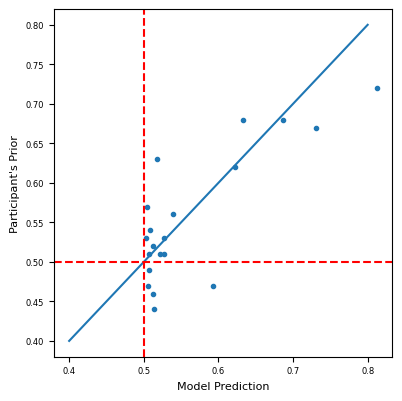

PearsonRResult(statistic=0.7964873447452734, pvalue=2.645112802846892e-05)


In [113]:
from scipy.stats import pearsonr
a = []
b= []
for i in model_prior:
    if model_prior[i] > 0.5:
        a.append(model_prior[i])
        b.append(average_rs[i])
    else:
        a.append(1-model_prior[i])
        b.append(1-average_rs[i])
    

x = np.linspace(0.4, 0.8, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

# plt.rcParams["figure.figsize"] = [3.5,3.5]
# plt.rcParams["figure.autolayout"] = True
px = 1/plt.rcParams['figure.dpi']
figure(figsize=(400*px, 400*px))
plt.plot(x, y)
plt.axvline(0.5,color = 'r',linestyle = "--")
plt.axhline(0.5,color = 'r',linestyle = "--")
plt.ylabel("Participant's Prior")
plt.xlabel("Model Prediction")
plt.scatter(a,b)
plt.show()

print(pearsonr(a,b))


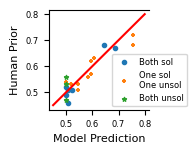

PearsonRResult(statistic=0.952591222382407, pvalue=0.0009161794785866936)


In [114]:
key_instances = [20022, 20023, 20025, 20027, 20009, 20012, 20001, 20003, 20006, 20008]
no_instances = [20002,20007,20021]
from scipy.stats import pearsonr
a = []
b= []
key_a = []
key_b = []
no_a = []
no_b = []
for i in model_prior2:
    if i in key_instances:
        if model_prior2[i] > 0.5:
            key_a.append(model_prior2[i])
            key_b.append(average_rs[i])
        else:
            key_a.append(1-model_prior2[i])
            key_b.append(1-average_rs[i])
    
    elif i in no_instances:
        if model_prior2[i] > 0.5:
            no_a.append(model_prior2[i])
            no_b.append(average_rs[i])
        else:
            no_a.append(1-model_prior2[i])
            no_b.append(1-average_rs[i])
    else:
        if model_prior2[i] > 0.5:
            a.append(model_prior2[i])
            b.append(average_rs[i])
        else:
            a.append(1-model_prior2[i])
            b.append(1-average_rs[i])
    

x = np.linspace(0.45, 0.8, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

# plt.rcParams["figure.figsize"] = [3.5,3.5]
# plt.rcParams["figure.autolayout"] = True
SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
mpl.rc_file_defaults()
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams['lines.markersize'] = 3
plt.rcParams["figure.figsize"] = [1.3,1.3]
plt.plot(x, y, color = 'r')
# plt.axvline(0.5,color = 'r',linestyle = "--")
# plt.axhline(0.5,color = 'r',linestyle = "--")
plt.ylabel("Human Prior")
plt.xlabel("Model Prediction")
plt.scatter(a,b, marker = 'o', label = 'Both sol')
plt.scatter(key_a,key_b, marker = '+', label = 'One sol\nOne unsol')
plt.scatter(no_a,no_b, marker = '*', label = 'Both unsol')
plt.legend(loc='upper center', bbox_to_anchor=(1, 0.6))
ax = plt.gca()
ax.spines[['right']].set_visible(False)
plt.savefig("fig7.pdf",format='pdf',bbox_inches='tight')
plt.show()

print(pearsonr(a,b))

In [115]:
from collections import Counter
filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
model_steps = {}
for instance in action_datas:
    m,s = ps_infos[int(instance)]
    if s < 0:
        tmp_steps = action_datas[instance]['steps']
        zstep = zscore(tmp_steps)
        filter_steps = []
        for s,z in zip(tmp_steps, zstep):
            if -3<=z<=3:
                filter_steps.append(s)
            
        model_steps[int(instance)] = mean(filter_steps)

In [116]:
from collections import Counter
filename = 'key_infos_test.json'
with open(filename) as f:
    action_datas = json.load(f)
    
easy_m_times = []
hard_m_times = []
easy = [30028,30029,30030,30031]
for instance in action_datas:
    ts = action_datas[instance]['key_times']
    if int(instance) in easy:
        easy_m_times += ts
    else:
        hard_m_times += ts
        

    

In [117]:
print(len(average_rs_o))

40


In [118]:
from collections import Counter
filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    

for instance in range(30001, 30009):
    ts = action_datas[str(instance)]['key_actions']
    print(Counter(ts))
        

Counter({'move-loc_4_5-loc_4_6()': 92, 'move-loc_4_5-loc_4_4()': 8})
Counter({'move-loc_4_5-loc_4_6()': 93, 'move-loc_4_5-loc_4_4()': 7})
Counter({'move-loc_4_5-loc_4_4()': 84, 'move-loc_4_5-loc_4_6()': 16})
Counter({'move-loc_4_5-loc_4_4()': 79, 'move-loc_4_5-loc_4_6()': 21})
Counter({'move-loc_7_5-loc_7_6()': 78, 'move-loc_7_5-loc_7_4()': 22})
Counter({'move-loc_7_5-loc_7_4()': 77, 'move-loc_7_5-loc_7_6()': 23})
Counter({'move-loc_7_5-loc_7_6()': 76, 'move-loc_7_5-loc_7_4()': 24})
Counter({'move-loc_7_5-loc_7_4()': 73, 'move-loc_7_5-loc_7_6()': 27})


uniform + offline
0.025
log-likelihood for the instance is: -261.05264397526025
0.975
log-likelihood for the instance is: -63.953027413485536
0.957913100536013
log-likelihood for the instance is: -57.21017969839365
0.025
log-likelihood for the instance is: -54.42776713354849
0.975
log-likelihood for the instance is: -277.1723152182306
0.042086899463986985
log-likelihood for the instance is: -50.96013860045674
0.957913100536013
log-likelihood for the instance is: -61.585208466949524
0.975
log-likelihood for the instance is: -76.40913701032633
0.025
log-likelihood for the instance is: -277.90502754745654
0.042086899463986985
log-likelihood for the instance is: -57.83518380818737
0.975
log-likelihood for the instance is: -269.84519192597133
0.025
log-likelihood for the instance is: -78.60727399800415
PearsonRResult(statistic=0.38689536354646636, pvalue=0.21407483303952107)
12
12
uniform + online
0.8342592592592593
log-likelihood for the instance is: -56.64836556157216
0.7984513274336283
l

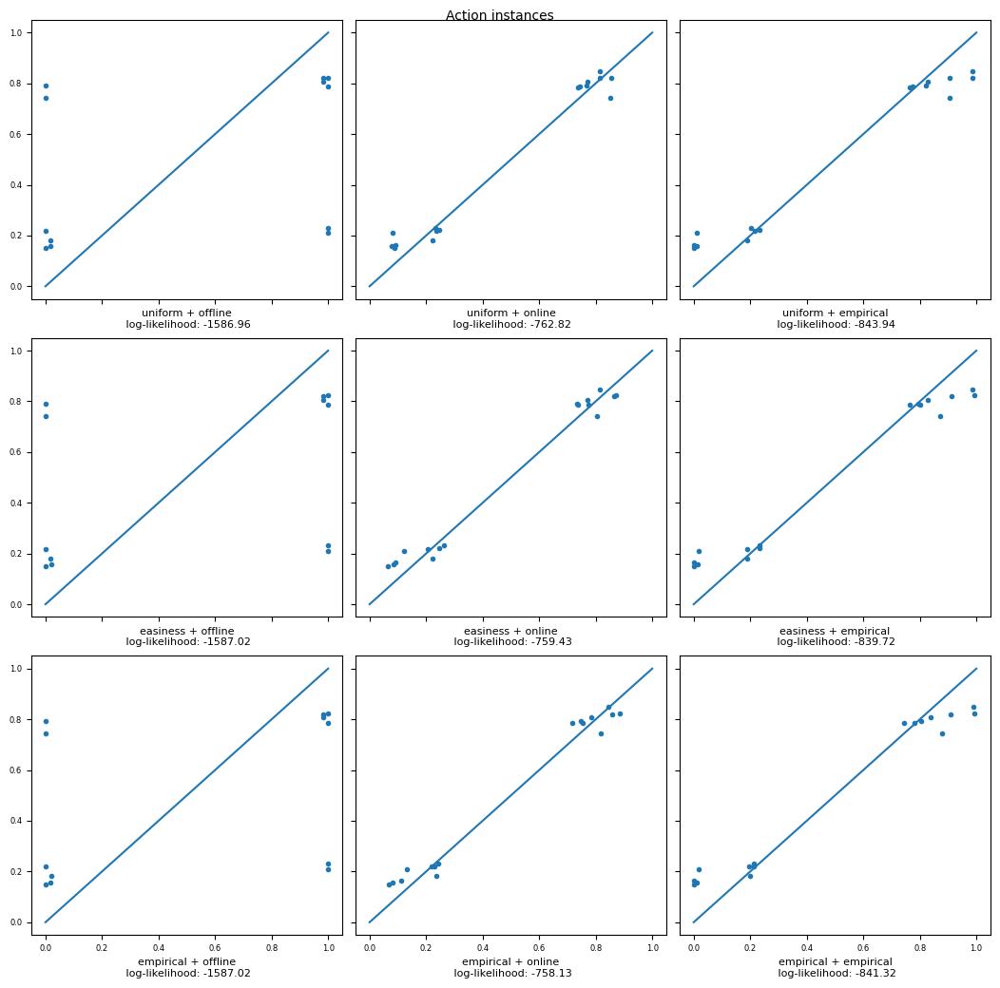

In [119]:
def cross_entropy_2probs(model_prob, human_prob_list, epsilon = 0.05):
    # for binary choice
    adj_model_prob = model_prob*(1-epsilon) + epsilon/2
    print(adj_model_prob)
    res = 0
    for h in human_prob_list:
        res += h*math.log(adj_model_prob) + (1-h)*math.log(1-adj_model_prob)
    
    return res

def adj_prob(prob, epsilon=0.05):
    return prob*(1-epsilon) + epsilon/2

import math
# Action pairs

obs_instances = [2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016]
maps = [1,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2]
soA = [-1,-1,1,1,-1,-1,1,1,1,1,-1,-1,1,1,-1,-1]
soB = [1,-1,-1,1,1,-1,-1,1,1,-1,-1,1,1,-1,-1,1]
obs = [1,1,1,1,-1,-1,-1,-1,1,1,1,1,-1,-1,-1,-1]
prior_instances = [20001, 20002, 20003, 20004, 20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20005, 20006, 20007, 20008]
real_goal = ['A', 'A', 'A', 'A', 'B', 'B', 'B', 'B', 'A', 'A', 'A', 'A', 'B', 'B', 'B', 'B']
goals = [(30001, 30003),(30001, 30004), (30002, 30004),(30002,30003), (30001, 30003),(30001, 30004), (30002, 30004),(30002,30003),(30005, 30006), (30005, 30008), (30007, 30008), (30007, 30006), (30005, 30006), (30005, 30008), (30007, 30008), (30007, 30006)]

action_infos_full = {}
for i,m,a,b, o,  p, real_g, g in zip(obs_instances, maps, soA, soB, obs, prior_instances, real_goal, goals):
    action_infos_full[i] = (m, a, b, o, p, real_g, g)
    

# prior

action_uniform_prior = {}

for i in action_infos_full:
    action_uniform_prior[i] = (0.5, 0.5)
    
action_easiness_prior = {}
addon = 5
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a<0:
        s_a = 26
    if s_b<0:
        s_b = 26
    
    action_easiness_prior[i] = (1 - (s_a+addon)/(s_a+s_b+2*addon), (s_a+addon)/(s_a+s_b+2*addon))
    

action_emp_prior = {}
for i in action_infos_full:
    prior_instance = action_infos_full[i][4]
    count = 0
    sum_response = 0
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == prior_instance:                
                sum_response += i_response['response']
                count += 1
                
    action_emp_prior[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)
    

    
# likelihood
action_off_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a < 0 and s_b<0:
        action_off_ll[i] = None
        continue
        
    if s_a < 0:
        action_off_ll[i] = (0, 1)
        continue
        
    if s_b < 0:
        action_off_ll[i] = (1, 0)
        continue
    
    action_off_ll[i] = (math.exp(2*obs), math.exp(-2*obs))
    


filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    

# for instance in action_datas:
#     ts = action_datas[instance]['key_actions']
#     print(Counter(ts))
    
action_ol_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']
    if obs == 1:
        a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
        b_count = Counter(actions_b).most_common(2)[1][1] 
    else:
        a_count = Counter(actions_a).most_common(2)[1][1] # P(O|g_a)
        b_count = Counter(actions_b).most_common(2)[0][1] 
        
    action_ol_ll[i] = (a_count, b_count)

action_emp_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    if obs == 1:
        a_prob = action_instance_step_prob[g_a]
        b_prob = 1 - action_instance_step_prob[g_b]
    else:
        a_prob = 1 - action_instance_step_prob[g_a]
        b_prob = action_instance_step_prob[g_b]
        
    action_emp_ll[i] = (a_prob, b_prob)
    
    
    
    
# Human inference
action_human_infer = {}
action_human_infer_list = {}
for i in action_infos_full:
    count = 0
    sum_response = 0
    action_human_infer_list[i] = []
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i:                
                sum_response += i_response['response']
                action_human_infer_list[i].append(0.5 - i_response['response']/5)
                count += 1
                
    action_human_infer[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)

plt.rcParams["figure.figsize"] = [10.5,10.5]
plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(3, 3, sharey=True, sharex = True)
f.tight_layout()

priors = {"uniform": action_uniform_prior, "easiness": action_easiness_prior, "empirical":action_emp_prior}
lls = {"offline": action_off_ll, "online":action_ol_ll, "empirical":action_emp_ll}

fig_row = 0

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in action_infos_full:
            p = prior_data[i]
            ll = ll_data[i]
            human = action_human_infer[i]
            human_list = action_human_infer_list[i]
            if not ll is None:
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
        



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_row, fig_col].plot(x, y)
        axs[fig_row, fig_col].scatter(a,b)
        axs[fig_row, fig_col].set_xlabel(pp + " + " + llll + "\n log-likelihood: " + str(round(sum_ll,2)))
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

plt.suptitle("Action instances")
plt.show()





{2017: (0.7560975609756098, 0.24390243902439024), 2018: (0.6428571428571428, 0.35714285714285715), 2019: (0.7560975609756098, 0.24390243902439024), 2020: (0.6428571428571428, 0.35714285714285715), 2021: (0.6875, 0.3125), 2022: (0.6875, 0.3125), 2023: (0.7560975609756098, 0.24390243902439024), 2024: (0.7560975609756098, 0.24390243902439024)}
{2017: (0.5, 0.5), 2018: (0.5, 0.5), 2019: (0.5, 0.5), 2020: (0.5, 0.5), 2021: (0.5, 0.5), 2022: (0.5, 0.5), 2023: (0.5, 0.5), 2024: (0.5, 0.5)}
{2017: (0.6630061770761839, 0.222104706504495), 2018: (0.6735300846488219, 0.23953301127214172), 2019: (0.3157172271791352, 0.745637228979376), 2020: (0.30519331960649737, 0.7326892109500805), 2021: (0.7978723404255319, 0.131731886865556), 2022: (0.20212765957446804, 0.6235309311636317), 2023: (0.7528604118993135, 0.07820855614973261), 2024: (0.23661327231121282, 0.49532085561497324)}
uniform + offline
0.975
log-likelihood for the instance is: -49.298780828966954
0.5
log-likelihood for the instance is: -65.

ValueError: math domain error

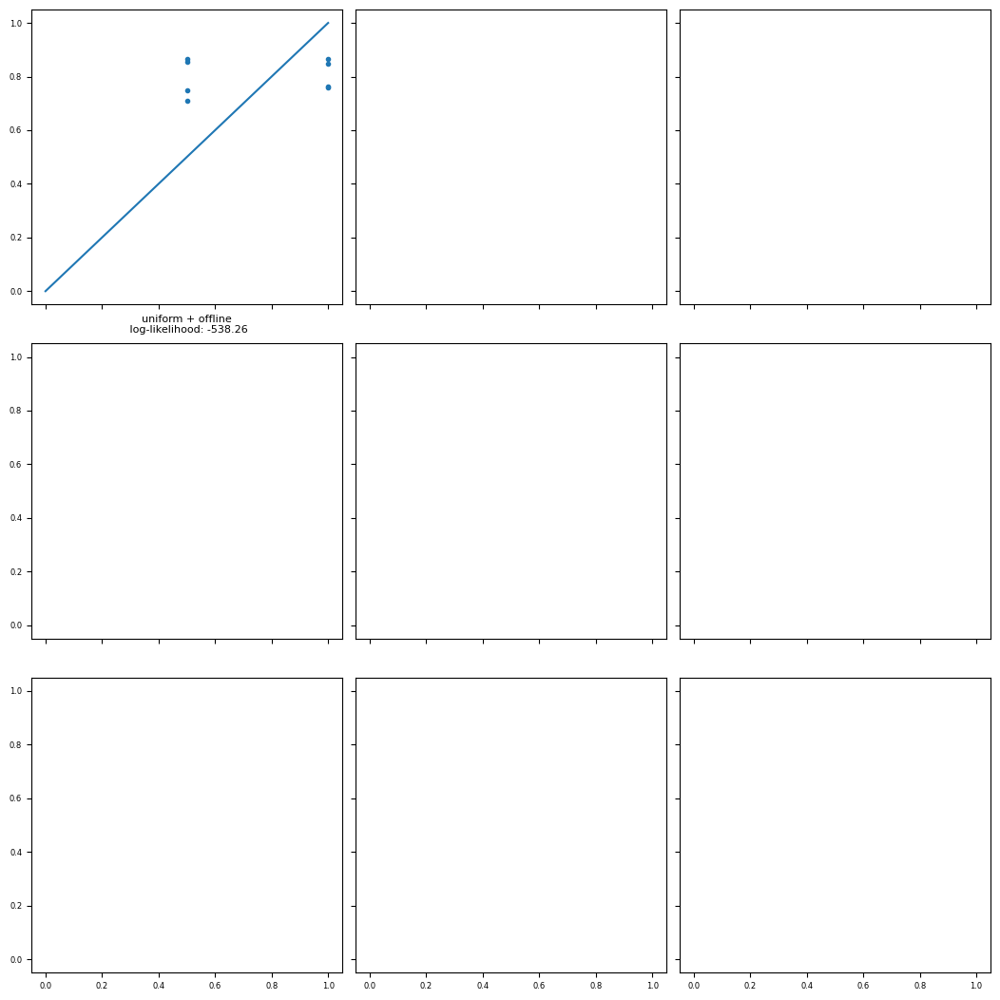

In [125]:
import math
import scipy.stats
# Easy-goal pairs

obs_instances = [2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024]
maps = [3,3,3,3,4,4,4,4]
soA = [1,1,1,1,1,1,1,1]
soB = [-1,1,-1,1,1,1,-1,-1]
obs = [1,1,-1,-1,1,-1,1,-1]
prior_instances = [20009,20010,20009,20010, 20011, 20011, 20012, 20012]
real_goal = ['A', 'A', 'B', 'B', 'A', 'B', 'A', 'B']
goals = [(30010, 30009), (30010, 30011), (30010, 30009), (30010, 30011),(30013, 30012),(30013, 30012), (30015, 30014),(30015, 30014)]
action_infos_full = {}
for i,m,a,b, o,  p, real_g, g in zip(obs_instances, maps, soA, soB, obs, prior_instances, real_goal, goals):
    action_infos_full[i] = (m, a, b, o, p, real_g, g)
    

# prior

easy_uniform_prior = {}

for i in action_infos_full:
    easy_uniform_prior[i] = (0.5, 0.5)
    
easy_easiness_prior = {}
addon = 5
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a<0:
        s_a = 26
    if s_b<0:
        s_b = 26
    
    easy_easiness_prior[i] = (1 - (s_a+addon)/(s_a+s_b+2*addon), (s_a+addon)/(s_a+s_b+2*addon))
    

easy_emp_prior = {}
for i in action_infos_full:
    prior_instance = action_infos_full[i][4]
    count = 0
    sum_response = 0
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == prior_instance:                
                sum_response += i_response['response']
                count += 1
                
    easy_emp_prior[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)
    

    
# likelihood
easy_off_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a < 0 and s_b<0:
        easy_off_ll[i] = None
        continue
        
    if s_a < 0:
        easy_off_ll[i] = (0, 1)
        continue
        
    if s_b < 0:
        easy_off_ll[i] = (1, 0)
        continue
    
    easy_off_ll[i] = (0.5, 0.5)
    


filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    

# for instance in action_datas:
#     ts = action_datas[instance]['key_actions']
#     print(Counter(ts))
    
easy_ol_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    times_a = action_datas[str(g_a)]['key_times']
    times_b = action_datas[str(g_b)]['key_times']
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 

    
    median = np.median(times_a + times_b)
    
    if obs == 1:
        a_count = np.count_nonzero(np.array(times_a) < median)
        b_count = 20 - a_count
    else:
        a_count = np.count_nonzero(np.array(times_a) > median)# P(O|g_a)
        b_count = 20 - a_count
        
        
        
    easy_ol_ll[i] = (a_count*action_a_count, b_count*action_b_count)
    
    
easy_ol_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
       
        
    easy_ol_nt_ll[i] = (action_a_count, action_b_count)

easy_emp_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    times_a = easy_times[g_a]
    times_b = easy_times[g_b]
    actions_a = easy_actions[g_a]
    actions_b = easy_actions[g_b]
    median = np.median(times_a + times_b)
    if obs == 1:
        a_count = np.count_nonzero(np.array(times_a) < median)
        b_count = np.count_nonzero(np.array(times_b) < median)
    else:
        a_count = np.count_nonzero(np.array(times_a) > median)
        b_count = np.count_nonzero(np.array(times_b) > median)
        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    easy_emp_ll[i] = (a_count/len(times_a)*action_a_count/len(actions_a), b_count/len(times_b)*action_b_count/len(actions_b))
    
    
easy_emp_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = easy_actions[g_a]
    actions_b = easy_actions[g_b]

        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    easy_emp_nt_ll[i] = (action_a_count/len(actions), action_b_count/len(actions_b))
    
# Human inference
easy_human_infer = {}
easy_human_infer_list = {}
for i in action_infos_full:
    count = 0
    sum_response = 0
    easy_human_infer_list[i] = []
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i:
                easy_human_infer_list[i].append(0.5 - i_response['response']/5)
                sum_response += i_response['response']
                count += 1
                
    easy_human_infer[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)

plt.rcParams["figure.figsize"] = [10.5,10.5]
plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(3, 3, sharey=True, sharex = True)
f.tight_layout()

priors = {"uniform": easy_uniform_prior, "easiness": easy_easiness_prior, "empirical":easy_emp_prior}
lls = {"offline": easy_off_ll, "online":easy_ol_ll, "empirical":easy_emp_ll}
print(easy_easiness_prior)
print(easy_uniform_prior)
print(easy_emp_ll)
fig_row = 0

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in action_infos_full:
            p = prior_data[i]
            ll = ll_data[i]
            human = easy_human_infer[i]
            human_list = easy_human_infer_list[i]
            if not ll is None:
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
        



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_row, fig_col].plot(x, y)
        axs[fig_row, fig_col].scatter(a,b)
        axs[fig_row, fig_col].set_xlabel(pp + " + " + llll + "\n log-likelihood: " + str(round(sum_ll,2)))
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

plt.suptitle("Easy-goal instances")
plt.show()


/tmp/ipykernel_662295/773736701.py:95: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_a = scipy.mean(action_datas[str(g_a)]['key_times'])
/tmp/ipykernel_662295/773736701.py:96: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_b = scipy.mean(action_datas[str(g_b)]['key_times'])
/tmp/ipykernel_662295/773736701.py:136: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_a = scipy.mean(easy_times[g_a])
/tmp/ipykernel_662295/773736701.py:137: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_b = scipy.mean(easy_times[g_b])


2017
3.312892473118279 1.6242364390517
7.2680983606557374 5.700531671220455
0.15001551446895403 0.043432985620956516
2018
3.312892473118279 1.6242364390517
5.704217391304348 2.8113530801282893
0.15001551446895403 0.05146139746483856
2019
3.312892473118279 1.6242364390517
7.2680983606557374 5.700531671220455
0.21158539113478247 0.060547056830193416
2020
3.312892473118279 1.6242364390517
5.704217391304348 2.8113530801282893
0.21158539113478247 0.1229786849260483
2021
2.6656914893617016 1.088270822702047
7.23483908045977 4.395855296776368
0.2472796736733442 0.04107842969485621
2022
2.6656914893617016 1.088270822702047
7.23483908045977 4.395855296776368
0.1356903409720515 0.07151004136254896
2023
2.5450760869565214 0.805874049303742
10.992833333333332 9.873250399028638
0.285663918464782 0.025946753795447905
2024
2.5450760869565214 0.805874049303742
10.992833333333332 9.873250399028638
0.06010280942187236 0.03189065573094358
{2017: (0.7560975609756098, 0.24390243902439024), 2018: (0.6428571

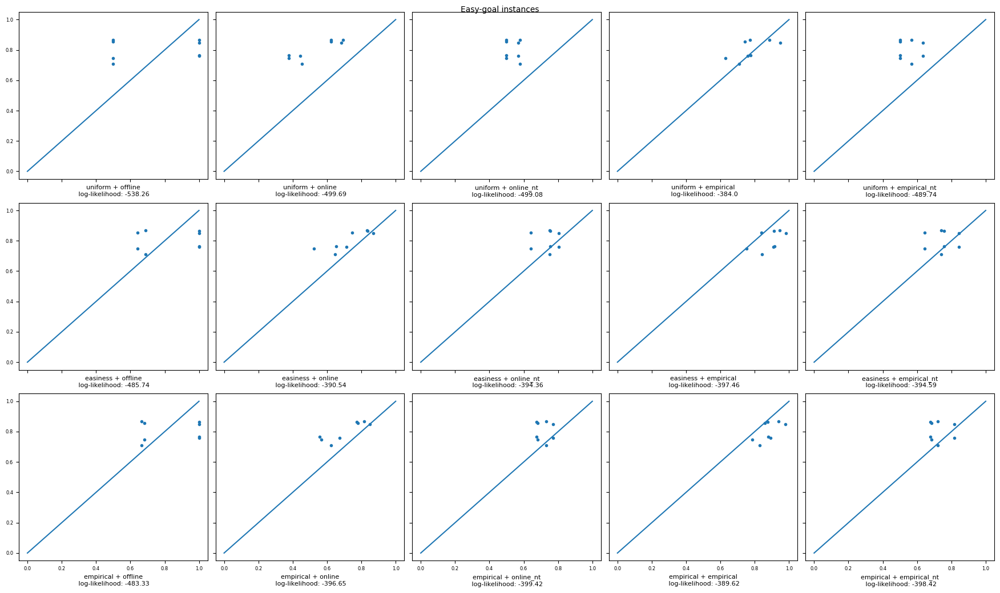

In [128]:
import math
from scipy import stats
import scipy
# Easy-goal pairs new method
std = 5
long_t = 4.2
short_t = 1.7

obs_instances = [2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024]
maps = [3,3,3,3,4,4,4,4]
soA = [1,1,1,1,1,1,1,1]
soB = [-1,1,-1,1,1,1,-1,-1]
obs = [1,1,-1,-1,1,-1,1,-1]
prior_instances = [20009,20010,20009,20010, 20011, 20011, 20012, 20012]
real_goal = ['A', 'A', 'B', 'B', 'A', 'B', 'A', 'B']
goals = [(30010, 30009), (30010, 30011), (30010, 30009), (30010, 30011),(30013, 30012),(30013, 30012), (30015, 30014),(30015, 30014)]
action_infos_full = {}
for i,m,a,b, o,  p, real_g, g in zip(obs_instances, maps, soA, soB, obs, prior_instances, real_goal, goals):
    action_infos_full[i] = (m, a, b, o, p, real_g, g)
    

# prior

easy_uniform_prior = {}

for i in action_infos_full:
    easy_uniform_prior[i] = (0.5, 0.5)
    
easy_easiness_prior = {}
addon = 5
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a<0:
        s_a = 26
    if s_b<0:
        s_b = 26
    
    easy_easiness_prior[i] = (1 - (s_a+addon)/(s_a+s_b+2*addon), (s_a+addon)/(s_a+s_b+2*addon))
    

easy_emp_prior = {}
for i in action_infos_full:
    prior_instance = action_infos_full[i][4]
    count = 0
    sum_response = 0
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == prior_instance:                
                sum_response += i_response['response']
                count += 1
                
    easy_emp_prior[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)
    

    
# likelihood
easy_off_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a < 0 and s_b<0:
        easy_off_ll[i] = None
        continue
        
    if s_a < 0:
        easy_off_ll[i] = (0, 1)
        continue
        
    if s_b < 0:
        easy_off_ll[i] = (1, 0)
        continue
    
    easy_off_ll[i] = (0.5, 0.5)
    


filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    

# for instance in action_datas:
#     ts = action_datas[instance]['key_actions']
#     print(Counter(ts))
    
easy_ol_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    mean_times_a = scipy.mean(action_datas[str(g_a)]['key_times'])
    mean_times_b = scipy.mean(action_datas[str(g_b)]['key_times'])
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
    
    std = abs(mean_times_a-mean_times_b)
    
    if obs == 1:
        a_count = scipy.stats.norm(mean_times_a, std).pdf(mean_times_a)
        b_count = scipy.stats.norm(mean_times_b, std).pdf(mean_times_a)
    else:
        a_count = scipy.stats.norm(mean_times_a, std).pdf(mean_times_b)
        b_count = scipy.stats.norm(mean_times_b, std).pdf(mean_times_b)
        

    
        
    easy_ol_ll[i] = (a_count*action_a_count, b_count*action_b_count)
    
    
easy_ol_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
       
        
    easy_ol_nt_ll[i] = (action_a_count, action_b_count)

easy_emp_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]

    mean_times_a = scipy.mean(easy_times[g_a])
    mean_times_b = scipy.mean(easy_times[g_b])
    actions_a = easy_actions[g_a]
    actions_b = easy_actions[g_b]
    
    std_a = np.std(easy_times[g_a])
    std_b = np.std(easy_times[g_b])
    
    print(i)
    print(mean_times_a, std_a)
    print(mean_times_b, std_b)
    
    if obs == 1:
        a_count = scipy.stats.norm(mean_times_a, std_a).pdf(short_t)
        b_count = scipy.stats.norm(mean_times_b, std_b).pdf(short_t)
    else:
        a_count = scipy.stats.norm(mean_times_a, std_a).pdf(long_t)
        b_count = scipy.stats.norm(mean_times_b, std_b).pdf(long_t)
        
    print(a_count, b_count)
        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    easy_emp_ll[i] = (a_count/len(times_a)*action_a_count/len(actions_a), b_count/len(times_b)*action_b_count/len(actions_b))
    
    
easy_emp_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = easy_actions[g_a]
    actions_b = easy_actions[g_b]

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
    easy_emp_nt_ll[i] = (action_a_count/len(actions_a), action_b_count/len(actions_b))
    
# Human inference
easy_human_infer = {}
easy_human_infer_list = {}
for i in action_infos_full:
    count = 0
    sum_response = 0
    easy_human_infer_list[i] = []
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i:
                easy_human_infer_list[i].append(0.5 - i_response['response']/5)
                sum_response += i_response['response']
                count += 1
                
    easy_human_infer[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)

plt.rcParams["figure.figsize"] = [17.5,10.5]
plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(3,5, sharey=True, sharex = True)
f.tight_layout()

priors = {"uniform": easy_uniform_prior, "easiness": easy_easiness_prior, "empirical":easy_emp_prior}
lls = {"offline": easy_off_ll, "online":easy_ol_ll, "online_nt":easy_ol_nt_ll, "empirical":easy_emp_ll,"empirical_nt":easy_emp_nt_ll}
print(easy_easiness_prior)
print(easy_uniform_prior)
print(easy_emp_ll)
fig_row = 0

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in action_infos_full:
            p = prior_data[i]
            ll = ll_data[i]
            human = easy_human_infer[i]
            human_list = easy_human_infer_list[i]
            if not ll is None:
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
        



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_row, fig_col].plot(x, y)
        axs[fig_row, fig_col].scatter(a,b)
        axs[fig_row, fig_col].set_xlabel(pp + " + " + llll + "\n log-likelihood: " + str(round(sum_ll,2)))
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

plt.suptitle("Easy-goal instances")
plt.show()

In [102]:
print(action_datas)

{'30001': {'key_actions': ['move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_4()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_4()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_4()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_4()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_4()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_6()', 'move-loc_4_5-loc_4_4()', 'move-loc_4_5-loc_4_6()', 'move-loc_4

uniform + offline
0.025
log-likelihood for the instance is: -110.84661648394498
0.975
log-likelihood for the instance is: -189.97954804034538
0.5
log-likelihood for the instance is: -65.84898215319485
0.025
log-likelihood for the instance is: -92.52880825329677
0.975
log-likelihood for the instance is: -194.37582201570083
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -172.39445213892307
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -171.66173980969722
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -147.48223294524144
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -164.3346165174378
0.5
log-likelihood for the instance is: -65.84898215319485
PearsonRResult(statistic=0.7337171802110015, pvalue=0.0028181118340692055)
14
14
uniform + online
3.762626262626262


ValueError: math domain error

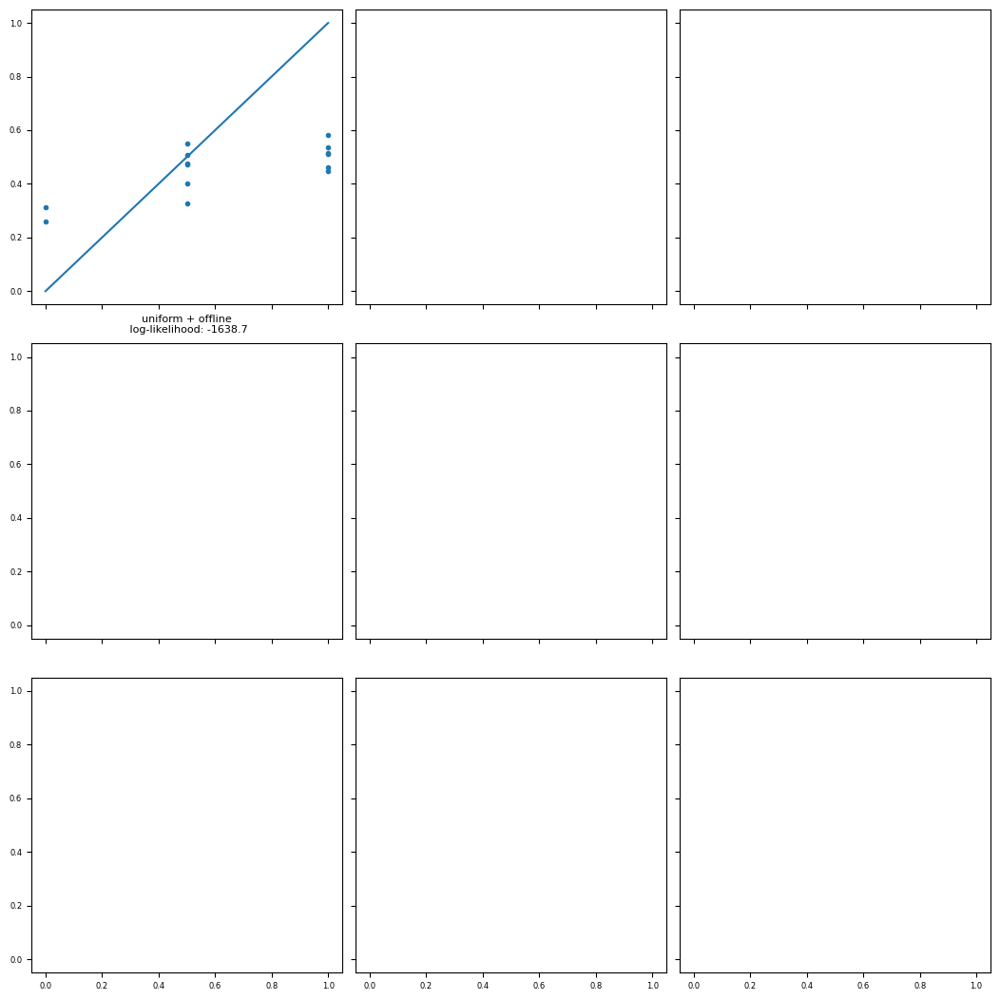

In [127]:
import math
# Cmp pairs




obs_instances = [2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
maps = [5,5,5,5,5,5,5,5,6,6,6,6,6,6,6,6]
soA = [-1,-1,1,1,-1,-1,1,1,1,1,1,1,1,1,1,1]
soB = [-1,1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1]
obs = [1,1,1,1,-1,-1,-1,-1,1,1,1,1,-1,-1,-1,-1]
times = [1,1,1,1,-1,-1,-1,-1,-1,-1,-1,-1,1,1,1,1]
prior_instances = [20021, 20022, 20023, 20024, 20021, 20022, 20023, 20024, 20025, 20026, 20027, 20028, 20025, 20026, 20027, 20028]
real_goal = ['A', 'A', 'A', 'A', 'B', 'B', 'B', 'B', 'A', 'A', 'A', 'A', 'B', 'B', 'B', 'B']
goals = [(30026, 30028), (30026, 30029), (30027,30028),(30027,30029),(30026, 30028), (30026, 30029), (30027,30028),(30027,30029),(30030, 30032),(30030,30033),(30031,30032),(30031,30033),(30030, 30032),(30030,30033),(30031,30032),(30031,30033)]
action_infos_full = {}
for i,m,a,b, o,  p, real_g, g,t in zip(obs_instances, maps, soA, soB, obs, prior_instances, real_goal, goals, times):
    action_infos_full[i] = (m, a, b, o, p, real_g, g,t)
    

# prior

cmp_uniform_prior = {}

for i in action_infos_full:
    cmp_uniform_prior[i] = (0.5, 0.5)
    
cmp_easiness_prior = {}
addon = 5
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a<0:
        s_a = 26
    if s_b<0:
        s_b = 26
    
    cmp_easiness_prior[i] = (1 - (s_a+addon)/(s_a+s_b+2*addon), (s_a+addon)/(s_a+s_b+2*addon))
    

cmp_emp_prior = {}
for i in action_infos_full:
    prior_instance = action_infos_full[i][4]
    count = 0
    sum_response = 0
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == prior_instance:                
                sum_response += i_response['response']
                count += 1
                
    cmp_emp_prior[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)
    

    
# likelihood
cmp_off_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a < 0 and s_b<0:
        cmp_off_ll[i] = None
        continue
        
    if s_a < 0:
        cmp_off_ll[i] = (0, 1)
        continue
        
    if s_b < 0:
        cmp_off_ll[i] = (1, 0)
        continue
    
    cmp_off_ll[i] = (0.5, 0.5)
    


filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    

# for instance in action_datas:
#     ts = action_datas[instance]['key_actions']
#     print(Counter(ts))
    
cmp_ol_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    time = action_infos_full[i][7]
    times_a = action_datas[str(g_a)]['key_times']
    times_b = action_datas[str(g_b)]['key_times']
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']
    
    
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 

    
    median = np.median(times_a + times_b)
    
    if time == 1:
        a_count = np.count_nonzero(np.array(times_a) < median)
        b_count = 20 - a_count
    else:
        a_count = np.count_nonzero(np.array(times_a) > median)# P(O|g_a)
        b_count = 20 - a_count
        
    
    cmp_ol_ll[i] = (a_count*action_a_count, b_count*action_b_count)
    
    
cmp_ol_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
       
        
    cmp_ol_nt_ll[i] = (action_a_count, action_b_count)



cmp_emp_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    time = action_infos_full[i][7]
    times_a = cmp_times[g_a]
    times_b = cmp_times[g_b]
    actions_a = cmp_actions[g_a]
    actions_b = cmp_actions[g_b]
    median = np.median(times_a + times_b)
    if time == 1:
        a_count = np.count_nonzero(np.array(times_a) > median)
        b_count = np.count_nonzero(np.array(times_b) > median)
    else:
        a_count = np.count_nonzero(np.array(times_a) < median)
        b_count = np.count_nonzero(np.array(times_b) < median)
        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    cmp_emp_ll[i] = (a_count/len(times_a)*action_a_count/len(actions_a), b_count/len(times_b)*action_b_count/(len(actions_b)))
    
cmp_emp_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    time = action_infos_full[i][7]
    actions_a = cmp_actions[g_a]
    actions_b = cmp_actions[g_b]

        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    cmp_emp_nt_ll[i] = (action_a_count/len(actions_a), action_b_count/(len(actions_b)))
    
    
# Human inference
cmp_human_infer = {}
cmp_human_infer_list = {}
for i in action_infos_full:
    count = 0
    sum_response = 0
    cmp_human_infer_list[i] = []
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i:                
                sum_response += i_response['response']
                cmp_human_infer_list[i].append(0.5 - i_response['response']/5)
                count += 1
                
    cmp_human_infer[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)

plt.rcParams["figure.figsize"] = [10.5,10.5]
plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(3, 3, sharey=True, sharex = True)
f.tight_layout()

priors = {"uniform": cmp_uniform_prior, "easiness": cmp_easiness_prior, "empirical":cmp_emp_prior}
lls = {"offline": cmp_off_ll, "online":cmp_ol_ll, "empirical":cmp_emp_ll}

fig_row = 0

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in action_infos_full:
            p = prior_data[i]
            ll = ll_data[i]
            human = cmp_human_infer[i]
            human_list = cmp_human_infer_list[i]
            if not ll is None:
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
        



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_row, fig_col].plot(x, y)
        axs[fig_row, fig_col].scatter(a,b)
        axs[fig_row, fig_col].set_xlabel(pp + " + " + llll + "\n log-likelihood: " + str(round(sum_ll,2)))
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

plt.suptitle("Cmp instances")
plt.show()


/tmp/ipykernel_662295/3674911138.py:98: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_a = scipy.mean(action_datas[str(g_a)]['key_times'])
/tmp/ipykernel_662295/3674911138.py:99: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_b = scipy.mean(action_datas[str(g_b)]['key_times'])
/tmp/ipykernel_662295/3674911138.py:142: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_a = scipy.mean(cmp_times[g_a])
/tmp/ipykernel_662295/3674911138.py:143: DeprecationWarning: scipy.mean is deprecated and will be removed in SciPy 2.0.0, use numpy.mean instead
  mean_times_b = scipy.mean(cmp_times[g_b])


uniform + offline
0.025
log-likelihood for the instance is: -110.84661648394498
0.975
log-likelihood for the instance is: -189.97954804034538
0.5
log-likelihood for the instance is: -65.84898215319485
0.025
log-likelihood for the instance is: -92.52880825329677
0.975
log-likelihood for the instance is: -194.37582201570083
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -172.39445213892307
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -171.66173980969722
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -147.48223294524144
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -164.3346165174378
0.5
log-likelihood for the instance is: -65.84898215319485
PearsonRResult(statistic=0.7337171802110015, pvalue=0.0028181118340692055)
14
14
uniform + online
0.5294621622684179
log-likelihood fo

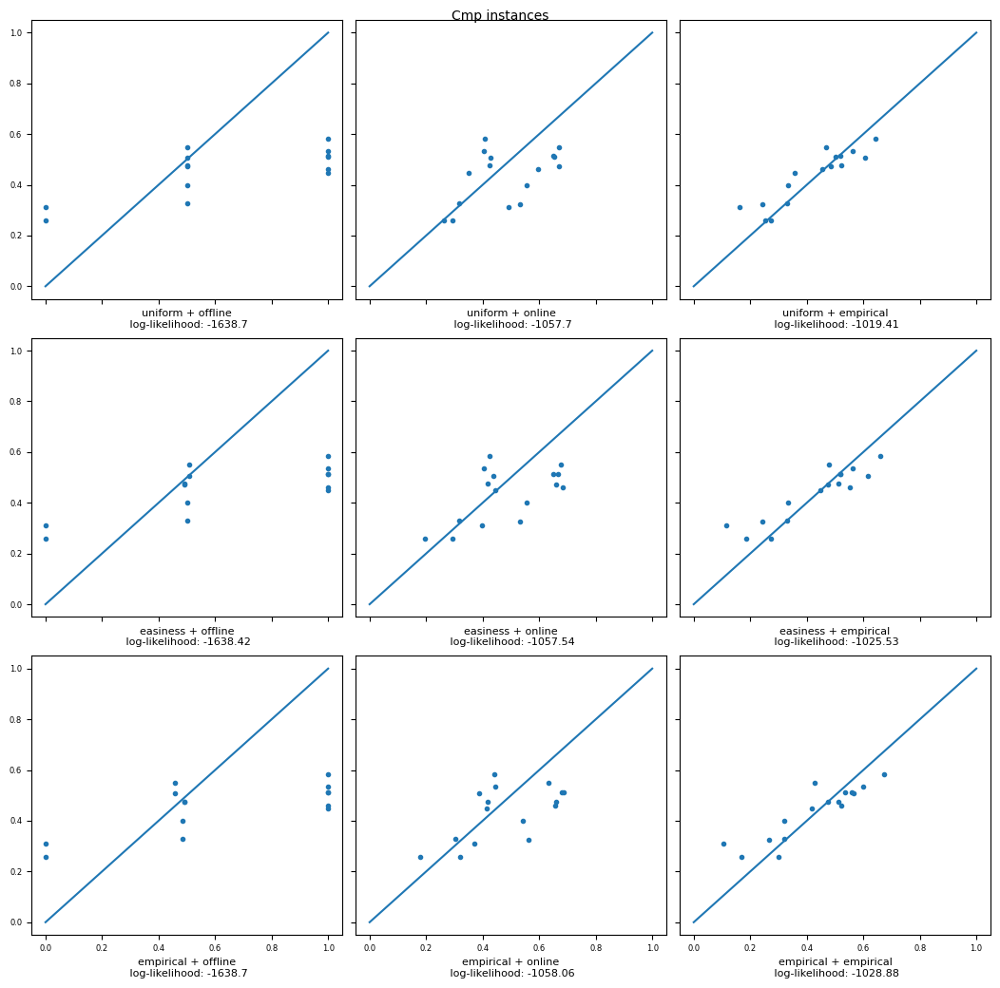

In [129]:
import math
# Cmp pairs new method

std = 5
long_t = 4.2
short_t = 1.7

obs_instances = [2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
maps = [5,5,5,5,5,5,5,5,6,6,6,6,6,6,6,6]
soA = [-1,-1,1,1,-1,-1,1,1,1,1,1,1,1,1,1,1]
soB = [-1,1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1,-1,1]
obs = [1,1,1,1,-1,-1,-1,-1,1,1,1,1,-1,-1,-1,-1]
times = [1,1,1,1,-1,-1,-1,-1,-1,-1,-1,-1,1,1,1,1]
prior_instances = [20021, 20022, 20023, 20024, 20021, 20022, 20023, 20024, 20025, 20026, 20027, 20028, 20025, 20026, 20027, 20028]
real_goal = ['A', 'A', 'A', 'A', 'B', 'B', 'B', 'B', 'A', 'A', 'A', 'A', 'B', 'B', 'B', 'B']
goals = [(30026, 30028), (30026, 30029), (30027,30028),(30027,30029),(30026, 30028), (30026, 30029), (30027,30028),(30027,30029),(30030, 30032),(30030,30033),(30031,30032),(30031,30033),(30030, 30032),(30030,30033),(30031,30032),(30031,30033)]
action_infos_full = {}
for i,m,a,b, o,  p, real_g, g,t in zip(obs_instances, maps, soA, soB, obs, prior_instances, real_goal, goals, times):
    action_infos_full[i] = (m, a, b, o, p, real_g, g,t)
    

# prior

cmp_uniform_prior = {}

for i in action_infos_full:
    cmp_uniform_prior[i] = (0.5, 0.5)
    
cmp_easiness_prior = {}
addon = 5
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a<0:
        s_a = 26
    if s_b<0:
        s_b = 26
    
    cmp_easiness_prior[i] = (1 - (s_a+addon)/(s_a+s_b+2*addon), (s_a+addon)/(s_a+s_b+2*addon))
    

cmp_emp_prior = {}
for i in action_infos_full:
    prior_instance = action_infos_full[i][4]
    count = 0
    sum_response = 0
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == prior_instance:                
                sum_response += i_response['response']
                count += 1
                
    cmp_emp_prior[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)
    

    
# likelihood
cmp_off_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    s_a = ps_infos[g_a][1]
    s_b = ps_infos[g_b][1]
    if s_a < 0 and s_b<0:
        cmp_off_ll[i] = None
        continue
        
    if s_a < 0:
        cmp_off_ll[i] = (0, 1)
        continue
        
    if s_b < 0:
        cmp_off_ll[i] = (1, 0)
        continue
    
    cmp_off_ll[i] = (0.5, 0.5)
    


filename = 'key_infos_full.json'
with open(filename) as f:
    action_datas = json.load(f)
    

# for instance in action_datas:
#     ts = action_datas[instance]['key_actions']
#     print(Counter(ts))
    
cmp_ol_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    time = action_infos_full[i][7]

    
    mean_times_a = scipy.mean(action_datas[str(g_a)]['key_times'])
    mean_times_b = scipy.mean(action_datas[str(g_b)]['key_times'])
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
    
    std = abs(mean_times_a-mean_times_b)
    if time == 1:
        a_count = scipy.stats.norm(mean_times_a, std).pdf(max(mean_times_a,mean_times_b))
        b_count = scipy.stats.norm(mean_times_b, std).pdf(max(mean_times_a,mean_times_b))
    else:
        a_count = scipy.stats.norm(mean_times_a, std).pdf(min(mean_times_a,mean_times_b))
        b_count = scipy.stats.norm(mean_times_b, std).pdf(min(mean_times_a,mean_times_b))
    


    
    
    cmp_ol_ll[i] = (a_count*action_a_count, b_count*action_b_count)
    
    
cmp_ol_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    actions_a = action_datas[str(g_a)]['key_actions']
    actions_b = action_datas[str(g_b)]['key_actions']

    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
       
        
    cmp_ol_nt_ll[i] = (action_a_count, action_b_count)



cmp_emp_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    time = action_infos_full[i][7]

    mean_times_a = scipy.mean(cmp_times[g_a])
    mean_times_b = scipy.mean(cmp_times[g_b])
    actions_a = cmp_actions[g_a]
    actions_b = cmp_actions[g_b]
    std_a = np.std(cmp_times[g_a])
    std_b = np.std(cmp_times[g_b])
    if time == 1:
        a_count = scipy.stats.norm(mean_times_a, std_a).pdf(long_t)
        b_count = scipy.stats.norm(mean_times_b, std_b).pdf(long_t)
    else:
        a_count = scipy.stats.norm(mean_times_a, std_a).pdf(short_t)
        b_count = scipy.stats.norm(mean_times_b, std_b).pdf(short_t)
        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    cmp_emp_ll[i] = (a_count/len(times_a)*action_a_count/len(actions_a), b_count/len(times_b)*action_b_count/(len(actions_b)))
    
cmp_emp_nt_ll = {}
for i in action_infos_full:
    g_a, g_b = action_infos_full[i][6]
    obs = action_infos_full[i][3]
    time = action_infos_full[i][7]
    actions_a = cmp_actions[g_a]
    actions_b = cmp_actions[g_b]
    

        
    action_a_count = Counter(actions_a).most_common(2)[0][1] # P(O|g_a)
    action_b_count = Counter(actions_b).most_common(2)[0][1] 
        
    cmp_emp_nt_ll[i] = (action_a_count/len(actions_a), action_b_count/(len(actions_b)))
    
    
# Human inference
cmp_human_infer = {}
cmp_human_infer_list = {}
for i in action_infos_full:
    count = 0
    sum_response = 0
    cmp_human_infer_list[i] = []
    for p_responses in gr_datas:
        p_data = p_responses['data']
        for i_response in p_data:
            if i_response['instance'] == i:                
                sum_response += i_response['response']
                cmp_human_infer_list[i].append(0.5 - i_response['response']/5)
                count += 1
                
    cmp_human_infer[i] = (0.5 - sum_response/(5*count), sum_response/(5*count) + 0.5)

plt.rcParams["figure.figsize"] = [10.5,10.5]
plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(3, 3, sharey=True, sharex = True)
f.tight_layout()

priors = {"uniform": cmp_uniform_prior, "easiness": cmp_easiness_prior, "empirical":cmp_emp_prior}
lls = {"offline": cmp_off_ll, "online":cmp_ol_ll, "empirical":cmp_emp_ll}

fig_row = 0

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in action_infos_full:
            p = prior_data[i]
            ll = ll_data[i]
            human = cmp_human_infer[i]
            human_list = cmp_human_infer_list[i]
            if not ll is None:
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
        



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_row, fig_col].plot(x, y)
        axs[fig_row, fig_col].scatter(a,b)
        axs[fig_row, fig_col].set_xlabel(pp + " + " + llll + "\n log-likelihood: " + str(round(sum_ll,2)))
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

plt.suptitle("Cmp instances")
plt.show()


uniform + offline
0.025
log-likelihood for the instance is: -261.05264397526025
0.975
log-likelihood for the instance is: -63.953027413485536
0.957913100536013
log-likelihood for the instance is: -57.21017969839365
0.025
log-likelihood for the instance is: -54.42776713354849
0.975
log-likelihood for the instance is: -277.1723152182306
0.042086899463986985
log-likelihood for the instance is: -50.96013860045674
0.957913100536013
log-likelihood for the instance is: -61.585208466949524
0.975
log-likelihood for the instance is: -76.40913701032633
0.025
log-likelihood for the instance is: -277.90502754745654
0.042086899463986985
log-likelihood for the instance is: -57.83518380818737
0.975
log-likelihood for the instance is: -269.84519192597133
0.025
log-likelihood for the instance is: -78.60727399800415
0.975
log-likelihood for the instance is: -49.298780828966954
0.5
log-likelihood for the instance is: -65.84898215319485
0.975
log-likelihood for the instance is: -84.46897263181157
0.5
log-l

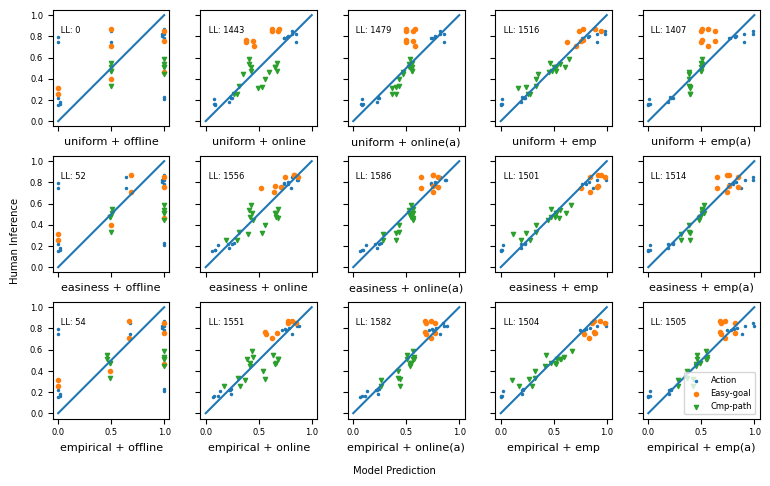

[[-3763.919382746623, -2320.205135645143, -2284.7422914387275, -2247.349016736797, -2356.042444670386], [-3711.181504393798, -2207.5137747648487, -2177.30474126985, -2262.69715333701, -2249.5665870189987], [-3709.0504101770075, -2212.8437899847404, -2181.7583712674054, -2259.8121199210505, -2258.574563076766]]


In [131]:
# action_instances = [2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016]
# easy_instances = [2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024]
# cmp_instances = [2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
obs_instances = [2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
full_uniform_prior = action_uniform_prior | easy_uniform_prior | cmp_uniform_prior
full_easiness_prior = action_easiness_prior | easy_easiness_prior | cmp_easiness_prior
full_emp_prior = action_emp_prior | easy_emp_prior | cmp_emp_prior
full_off_ll = action_off_ll | easy_off_ll | cmp_off_ll
full_ol_ll = action_ol_ll | easy_ol_ll | cmp_ol_ll
full_ol_nt_ll = action_ol_ll | easy_ol_nt_ll | cmp_ol_nt_ll
full_emp_ll = action_emp_ll | easy_emp_ll | cmp_emp_ll
full_emp_nt_ll = action_emp_ll | easy_emp_nt_ll | cmp_emp_nt_ll
full_human_infer = action_human_infer | easy_human_infer | cmp_human_infer
full_human_infer_list = action_human_infer_list | easy_human_infer_list | cmp_human_infer_list
priors = {"uniform": full_uniform_prior, "easiness": full_easiness_prior, "empirical":full_emp_prior}
lls = {"offline": full_off_ll, "online":full_ol_ll, "online(a)": full_ol_nt_ll, "emp":full_emp_ll, "emp(a)":full_emp_nt_ll}

fig_row = 0

log_lls = [[0]*5 for i in range(3)]

SMALL_SIZE = 6
MEDIUM_SIZE = 8
BIGGER_SIZE = 10
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE) 
plt.rcParams['lines.markersize'] = 3
plt.rcParams["figure.figsize"] = [8, 4.8]


# plt.rcParams["figure.figsize"] = [10,6]
# plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(3, 5, sharey=True, sharex = True)
# f.tight_layout()

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in obs_instances:
            
            
                
            p = prior_data[i]
            ll = ll_data[i]
            human = full_human_infer[i]
            human_list = full_human_infer_list[i]
            if not ll is None:
                
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
#         print("log-likelihood for the model is: " + str(sum_ll))



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_row, fig_col].plot(x, y)
        if fig_row == 0 and fig_col == 0:
            axs[fig_row, fig_col].text(0, 1, "\n LL: 0",fontsize=6,
         verticalalignment='top', horizontalalignment='left')
        else:
            axs[fig_row, fig_col].text(0, 1, "\n LL: " + str(int(sum_ll-log_lls[0][0])),fontsize=6,
                verticalalignment='top', horizontalalignment='left')
        axs[fig_row, fig_col].scatter(a[:16],b[:16], marker = '.',label = 'Action')
        axs[fig_row, fig_col].scatter(a[16:24],b[16:24], marker = 'o',label = 'Easy-goal')
        axs[fig_row, fig_col].scatter(a[24:],b[24:], marker = 'v',label = 'Cmp-path')
        axs[fig_row, fig_col].set(adjustable='box', aspect='equal')
        axs[fig_row, fig_col].set_xlabel(pp + " + " + llll)
        log_lls[fig_row][fig_col] = sum_ll
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

# plt.suptitle("All instances")
f.supxlabel("Model Prediction")
f.supylabel("Human Inference")
plt.legend(loc='lower right')
plt.savefig("fig10.pdf",format='pdf')
plt.show()
print(log_lls)

# import seaborn as sns
# sns.set(font_scale=2)
# s = sns.heatmap(log_lls, annot = True, xticklabels = ['offline', 'online', 'online_no_time', 'empirical', 'empirical_no_time'], yticklabels = ['uniform', 'easiness', 'empirical'], square = True, fmt='g')
# s.set_xlabel("Likelihood")
# s.set_ylabel("Prior")

easiness + online
0.788015873015873
log-likelihood for the instance is: -54.66988610880434
0.7984513274336283
log-likelihood for the instance is: -41.20638122374415
0.8542007266121706
log-likelihood for the instance is: -44.672275912456044
0.846513102282333
log-likelihood for the instance is: -44.857489981192806
0.08514388489208632
log-likelihood for the instance is: -42.17072916780114
0.11235632183908045
log-likelihood for the instance is: -43.56612765950232
0.13971897607122985
log-likelihood for the instance is: -50.649656582787934
0.10477099236641221
log-likelihood for the instance is: -42.69373255601371
0.7586633663366337
log-likelihood for the instance is: -47.31344958921732
0.76125
log-likelihood for the instance is: -49.33818445721093
0.7259708737864078
log-likelihood for the instance is: -50.29853154019216
0.7231033841576794
log-likelihood for the instance is: -49.80547034077145
0.23611111111111108
log-likelihood for the instance is: -45.781489977672116
0.27612403100775196
log-

ValueError: math domain error

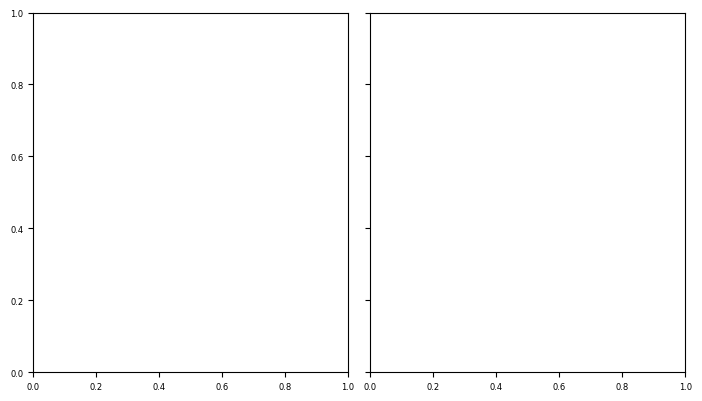

In [123]:
# action_instances = [2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016]
# easy_instances = [2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024]
# cmp_instances = [2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
obs_instances = [2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2041, 2042, 2043, 2044, 2045, 2046, 2047, 2048, 2049, 2050, 2051, 2052, 2053, 2054, 2055, 2056]
full_uniform_prior = action_uniform_prior | easy_uniform_prior | cmp_uniform_prior
full_easiness_prior = action_easiness_prior | easy_easiness_prior | cmp_easiness_prior
full_emp_prior = action_emp_prior | easy_emp_prior | cmp_emp_prior
full_off_ll = action_off_ll | easy_off_ll | cmp_off_ll
full_ol_ll = action_ol_ll | easy_ol_ll | cmp_ol_ll
full_ol_nt_ll = action_ol_ll | easy_ol_nt_ll | cmp_ol_nt_ll
full_emp_ll = action_emp_ll | easy_emp_ll | cmp_emp_ll
full_emp_nt_ll = action_emp_ll | easy_emp_nt_ll | cmp_emp_nt_ll
full_human_infer = action_human_infer | easy_human_infer | cmp_human_infer
full_human_infer_list = action_human_infer_list | easy_human_infer_list | cmp_human_infer_list
priors = {"easiness": full_easiness_prior}
lls = {"online":full_ol_ll, "online_no_time": full_ol_nt_ll}

fig_row = 0

log_lls = [[0]*4 for i in range(1)]

plt.rcParams["figure.figsize"] = [7,4]
plt.rcParams["figure.autolayout"] = True
f, axs = plt.subplots(1, 2, sharey=True, sharex = True)
f.tight_layout()

for pp in priors:
    
    prior_data = priors[pp]
    fig_col = 0
    
    for llll in lls:
        ll_data = lls[llll]
        
        print( pp + " + " + llll)
        
        a = []
        b = []
        sum_ll = 0
        for i in obs_instances:
            
            
                
            p = prior_data[i]
            ll = ll_data[i]
            human = full_human_infer[i]
            human_list = full_human_infer_list[i]
            if not ll is None:
                
                b.append(human[0])
                a.append(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]))
                
                log_ll = cross_entropy_2probs(p[0]*ll[0]/(p[0]*ll[0] + p[1]*ll[1]), human_list)
                
                print("log-likelihood for the instance is: " + str(log_ll))
                
                sum_ll += log_ll
                
#         print("log-likelihood for the model is: " + str(sum_ll))



        x = np.linspace(0, 1, 20) # [0, 0.55, 1.11, 1.66, 2.22, 2.77, 3.33, 3.88, 4.44, 5]
        y = x  # [1, 1.74, 3.03, 5.29, 9.22, 16.08, 28.03, 48.85, 85.15, 148.41]

        

        axs[fig_col].plot(x, y, color='r')
        axs[fig_col].scatter(a[:16],b[:16], marker = '.',label = 'Action')
        axs[fig_col].scatter(a[16:24],b[16:24], marker = 'o',label = 'Easy-goal')
        axs[fig_col].scatter(a[24:],b[24:], marker = 'v',label = 'Cmp-path')
        axs[fig_col].set(adjustable='box', aspect='equal')
        axs[fig_col].set_xlabel(pp + " + " + llll + "\n log-likelihood: " + str(round(sum_ll,2)))
        log_lls[fig_row][fig_col] = sum_ll
        print(pearsonr(a,b))
        print(len(a))
        print(len(b))
        
        fig_col += 1

    fig_row += 1

# plt.suptitle("All instances")
f.supxlabel("Model Prediction")
f.supylabel("Human Inference")
plt.legend(loc='lower right')
plt.show()
print(log_lls)

import seaborn as sns
s = sns.heatmap(log_lls, annot = True, xticklabels = ['online', 'online_no_time'], yticklabels = ['easiness'])
s.set_xlabel("Likelihood")
s.set_ylabel("Prior")

In [ ]:
# adjust likelihood estimation and weight the difference